#***Análisis de datos con Python Santander 2023***
*(Data Analysis with Python)*

#***Determinación del precio de la propiedad Airbnb***


> (Una pregunta recurrente para alguien que desea ofertar la propiedad en la plataforma es: ¿Cuánto debo cobrar por alquilar mi propiedad en Airbnb?)


<BR>

##*Equipo 8*

##*Fase3-Módulo 4*

##*Integrantes:*

* Isidro Amaro
* Francisco Gómez
* Tomás Antonio Hernández Pineda
* José Luis Herrera Gallardo
* Christian E. Millán Hernández


##<div class="markdown-google-sans"><a name="contenido">Contenido</a></div> 

* [Introducción](#introduccion)
* [Importación de librerías](#librerias)
* [Carga y revisión del conjunto de datos](#carga-revision)
* País: Estados Unidos
* Análisis de 6 ciudades
  * Boston
  * Chicago
  * Los Angeles
  * Nueva York
  * San Francisco
  * Washington DC



* [Estimados de Locación y Variabilidad.](#estimados)
* [Introducción a la visualización de datos.](#visualizacion-datos)
* [Exploración de Variables Categóricas y Análisis Multivariable.](#var-cat)
* [Correlaciones y Regresión Linear Simple.](#corr-reg-lin)
* [Distribuciones muestrales y técnicas de evaluación de modelos.](#dist-eval-mods)
* [Visualización de Datos Avanzada.](#visualizacion-avanzada)
* [Pruebas A/B y Procesamiento de Lenguaje Natural.](#nlp)
* [Introducción a Machine Learning: Clasificación No Supervisada y Supervisada.](#ml)

* [Conclusiones y siguientes pasos](#conclusiones)

## Extras:

* [Obtención de datos adicionales con Web Scraping](#webscraping)

## Enlaces
   
* [Presentación](https://docs.google.com/presentation/d/15a6yKehSkqinzb1_AUu4_btrAqpmGeVi/edit?usp=share_link&ouid=114487294612860477624&rtpof=true&sd=true)

* [Google Drive del Proyecto](https://drive.google.com/drive/folders/1qBsX0362VeaOsYH5vePxzqEwFHYvtC2_?usp=share_link)


* [Github repo del Proyecto](https://github.com/BeduDSEquipo9/C2DSF3_DAwPython)

* [Web Scraping Colab](https://colab.research.google.com/drive/19HFEGmKSxEVSvJzStKxA1V0jfRXFas8T?usp=share_link)



#<div class="markdown-google-sans"><a name="introduccion">Introducción</a></div>

De acuerdo a un análisis preliminar a los datos de la empresa Airbnb, se identificó el problema de la determinación del precio de las propiedades en arrendamiento, debido a una pregunta recurrente ¿Cuánto se debe cobrar por el alquiler de la propiedad?

Tras plantear una serie de preguntas, se recolectaron de fuentes públicas diversos conjuntos de datos con información proveniente de Airbnb. Las principales diferencias entre ellos son las fechas de extracción, las zonas geográficas, el número de observaciones y la cantidad de variables incluidas. 

Después de un análisis preliminar, se terminó por elegir un conjunto de datos, obtenido de Kaggle, que posee información de 6 de las ciudades más importantes de Estados Unidos: Boston, Chicago, San Francisco, Los Ángeles, Nueva York y Washington DC, mismo que ayudará a responder las preguntas de investigación planteadas.

Cabe señalar que dicho conjunto de datos ya fue preprocesado en los módulos anteriores.

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="librerias">Importación de librerías</a></div> 
Se importan las librerías para el proyecto de análisis de datos.


In [1]:
!pip install contractions

In [5]:
# Data wrangling
import pandas as pd
import numpy as np
from scipy import stats

# Data Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud
import urllib.request
import math
from scipy.stats import skew, kurtosis
import matplotlib as mpl
import matplotlib.font_manager as fm
import folium

# Dimensionality reduction
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.feature_selection import SelectKBest, f_regression

# Statistics
from scipy.stats import ks_2samp
from scipy.stats import chisquare
from sklearn.linear_model import Lasso, LinearRegression, Ridge, Lars, ElasticNet, BayesianRidge
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, OrdinalEncoder
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import precision_recall_curve, precision_score, recall_score, classification_report
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_validate

#Librerías necesarias para la limpieza de texto
import string
import nltk
from nltk.corpus import stopwords
from nltk.util import ngrams
import contractions
import re

#Librerías necesarias para abrir imágenes, generar nube de palabras y plot
import urllib.request
from PIL import Image
from wordcloud import ImageColorGenerator

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="carga-revision">Carga y revisión del conjunto de datos</a></div> 
Se realiza la carga del conjunto de datos y un rápido análisis exploratorio.

El conjunto de datos se encuentra almacenado en el Repositorio de Github que precede este análisis y en sus Google Drive. 

Si se quiere acceder vía Drive, es necesario habilitar el acceso a Google Colaboratory con la finalidad de cargar los datos. Enseguida, ejecute el siguiente par de celdas.

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive/')

In [ ]:
#Archivo local en GDrive

#Clean Dataset as Entry data to this analysis.
#/content/drive/MyDrive/BEDU/BEDUDS2022/BEDUDSF3M4PythonDataAnalisys2023Class/Gdrive_DAwPython/Datasets/airbnb_clean_F2M4_PostworkX.csv

#GDrive_Path='/content/drive/MyDrive/BEDU/BEDUDS2022/BEDUDSF3M4PythonDataAnalisys2023Class/Gdrive_DAwPython/'
#Datasets_Folder=GDrive_Path+'Datasets/'
#file_path=Datasets_Folder+filename
#print('Usando GDrivePath:'+file_path)

Sin embargo, como también se encuentra en Github, se recomienda acceder directamente desde este repositorio. De hecho, este notebook se ejecuta leyendo desde esta última fuente.

Nótese que el conjunto de datos está almacenado en formato `csv`, por lo que se utiliza `pd.read_csv()` para crear un objeto de tipo DataFrame.

In [6]:
#Dataset filename
filename='airbnb_clean_F2M4_Postwork7.csv'
imagename='airbnbBW.png'

In [7]:
#Ruta al repo del archivo Github de Procesamiento de Datos con Python

Github_path = 'https://raw.githubusercontent.com/BeduDSEquipo9/C2DSF3_DAwPython/main/Datasets/'
Github_path_image = 'https://raw.githubusercontent.com/BeduDSEquipo9/C2DSF3_DAwPython/main/images/'

file_path=Github_path+filename
file_path_image=Github_path_image+imagename

print('Usando GithubPath: '+file_path)
print('Usando GithubPath image: '+file_path_image)

Usando GithubPath: https://raw.githubusercontent.com/BeduDSEquipo9/C2DSF3_DAwPython/main/Datasets/airbnb_clean_F2M4_Postwork7.csv
Usando GithubPath image: https://raw.githubusercontent.com/BeduDSEquipo9/C2DSF3_DAwPython/main/images/airbnbBW.png


In [8]:
data=pd.read_csv(file_path) 

Una vez cargados los datos en un DataFrame, se revisan. 

Hay que recordar que el conjunto de datos contiene información de diversas propiedades en algunas de las ciudades más importantes de Estados Unidos y que están listadas en la plataforma Airbnb para rentar.

Para revisar la estructura y ejemplos de los primeros y últimos registros, se utilizan las funciones `head()` y `tail()`.


In [ ]:
data.head()

,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,description,...,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds,price,n_days_lastrev,n_days_ashost
0,House,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",2,0.0,1,3,1,NYC,"This is a comfortable, simple beautiful room, ...",...,AFFORDABLE & COZY IN SUNSET PARK T,Sunset Park,15,89,11232,1.0,1.0,50.0,2003,4200
1,Apartment,3,"{Internet,""Wireless Internet"",Kitchen,Heating,...",2,1.0,1,3,1,LA,Renovated clean & modern 1 bedroom in the hear...,...,Luxurious and quiet - 30 second walk to the be...,Venice,12,98,90291,1.0,1.0,199.0,2430,3272
2,Apartment,3,"{TV,Internet,""Wireless Internet"",""Air conditio...",4,1.0,1,3,1,NYC,My studio is located in the heart of Bensonhur...,...,Bensonhurst STYLISH STUDIO,Bensonhurst,26,94,11214,0.0,2.0,85.0,2057,2756
3,Townhouse,2,"{""Wireless Internet"",""Air conditioning"",""Pets ...",3,1.0,1,3,1,LA,"我们位于洛杉矶圣盖博市,距离夏威夷超市,99大华超市,顺发超市(全部为华人超市,语言沟通无障...",...,LA San Gabriel Suit room 圣盖博大套房 免费停车 Free Par...,San Gabriel,33,95,91776,1.0,2.0,70.0,2182,2559
4,Condominium,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",5,2.0,1,3,1,Chicago,Located in the heart of the bustling Woodlawn/...,...,"XTRA Large 2bdrm 2bath in the City near ""El"" T...",Woodlawn,60,88,60637,2.0,2.0,72.0,2192,2960


In [ ]:
data.tail()

,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,description,...,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds,price,n_days_lastrev,n_days_ashost
59283,House,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",5,2.0,1,2,1,LA,Our newly renovated House is in the Lake Balbo...,...,Lake Balboa House / Zen Retreat!,Lake Balboa,5,88,91406,3.0,3.0,225.0,2239,4227
59284,Condominium,3,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",2,1.5,1,3,1,NYC,Beautiful modern duplex in old traditional Har...,...,Modern Beautiful Duplex in Brownstone,Harlem,11,100,10027,1.0,1.0,200.0,2017,4644
59285,Apartment,3,"{TV,Internet,""Wireless Internet"",""Air conditio...",3,1.0,1,2,1,LA,Explore Los Angeles with your own private cott...,...,Artsy and Spacious Back House,West Los Angeles,0,0,90064,1.0,2.0,135.0,19436,2996
59286,Apartment,3,"{TV,""Wireless Internet"",""Air conditioning"",""Wh...",3,1.0,1,3,1,NYC,Quiet 1 bedroom apartment located in luxury co...,...,Cozy Apartment off J&M Subway Lines,Bushwick,11,100,11206,1.0,1.0,115.0,2046,3141
59287,House,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",14,3.0,1,3,1,LA,Come stay in this nice and spacious 4 bedroom ...,...,KOSHER-FRIENDLY 4 BEDROOM SLEEPS 10 and up to 12,Unknow,6,93,90035,4.0,5.0,360.0,2458,3139


El conjunto de datos contiene 59,288 observaciones y 26
 variables, de acuerdo con el resultado obtenido con el atributo `shape`.

In [ ]:
data.shape

(59288, 26)

Para conocer más detalles de la información se utiliza el método `info()`. Se distingue que ninguna de las variables contiene valores nulos y que la mayoría son valores numéricos (con excepción de los tipo *object*).

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59288 entries, 0 to 59287
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   property_type           59288 non-null  object 
 1   room_type               59288 non-null  int64  
 2   amenities               59288 non-null  object 
 3   accommodates            59288 non-null  int64  
 4   bathrooms               59288 non-null  float64
 5   bed_type                59288 non-null  int64  
 6   cancellation_policy     59288 non-null  int64  
 7   cleaning_fee            59288 non-null  int64  
 8   city                    59288 non-null  object 
 9   description             59288 non-null  object 
 10  host_has_profile_pic    59288 non-null  int64  
 11  host_identity_verified  59288 non-null  int64  
 12  host_response_rate      59288 non-null  float64
 13  instant_bookable        59288 non-null  int64  
 14  latitude                59288 non-null

Otra opción para revisar los tipos de dato es con el atributo `dtypes`.

In [ ]:
data.dtypes

property_type              object
room_type                   int64
amenities                  object
accommodates                int64
bathrooms                 float64
bed_type                    int64
cancellation_policy         int64
cleaning_fee                int64
city                       object
description                object
host_has_profile_pic        int64
host_identity_verified      int64
host_response_rate        float64
instant_bookable            int64
latitude                  float64
longitude                 float64
name                       object
neighbourhood              object
number_of_reviews           int64
review_scores_rating        int64
zipcode                    object
bedrooms                  float64
beds                      float64
price                     float64
n_days_lastrev              int64
n_days_ashost               int64
dtype: object

Como confirmación, con `isnull()` se verifica si existen valores ausentes o nulos.

In [ ]:
data.isnull().values.any()

False

Asimismo, se corrobora cuántos casos de `NaN` existen por columna con la ayuda de `isna()` y la función de agregación `sum()`.

In [ ]:
data.isna().sum()

property_type             0
room_type                 0
amenities                 0
accommodates              0
bathrooms                 0
bed_type                  0
cancellation_policy       0
cleaning_fee              0
city                      0
description               0
host_has_profile_pic      0
host_identity_verified    0
host_response_rate        0
instant_bookable          0
latitude                  0
longitude                 0
name                      0
neighbourhood             0
number_of_reviews         0
review_scores_rating      0
zipcode                   0
bedrooms                  0
beds                      0
price                     0
n_days_lastrev            0
n_days_ashost             0
dtype: int64

De forma similar, se presenta un resumen del número de `NaN`en cada fila.

In [ ]:
data.isna().sum(axis=1)

0        0
1        0
2        0
3        0
4        0
        ..
59283    0
59284    0
59285    0
59286    0
59287    0
Length: 59288, dtype: int64

Para conocer qué proporción del total representan los `Nan` se realiza lo siguiente:

In [ ]:
nulos_porcentaje=(data.isnull().sum()/len(data))*100 #Porcentaje de valores nulos
nulos_porcentaje.sort_values(ascending= False)

property_type             0.0
room_type                 0.0
n_days_lastrev            0.0
price                     0.0
beds                      0.0
bedrooms                  0.0
zipcode                   0.0
review_scores_rating      0.0
number_of_reviews         0.0
neighbourhood             0.0
name                      0.0
longitude                 0.0
latitude                  0.0
instant_bookable          0.0
host_response_rate        0.0
host_identity_verified    0.0
host_has_profile_pic      0.0
description               0.0
city                      0.0
cleaning_fee              0.0
cancellation_policy       0.0
bed_type                  0.0
bathrooms                 0.0
accommodates              0.0
amenities                 0.0
n_days_ashost             0.0
dtype: float64

 **Como todos está en ceros, se confirma la presencia de un conjunto de datos completo y sin registros ni campos faltantes.**

#####([Regresar a la tabla de contenidos.](#contenido))

In [ ]:
def estimados ():
  #df2 = df_estimados
  #df2 = df._get_numeric_data().columns
  df2 = df_estimados._get_numeric_data().columns
  #df2 = df_estimados.columns.values
  
  
  columnas = ['Promedio','Mediana','Media Truncada','Std', 'Rango','25%',"50%", "75%", "IQR"]

  dfEstimados = pd.DataFrame()

  for indice in df2:

    aux = []

    aux.append(df[indice].mean())
    aux.append(df[indice].median())
    aux.append(stats.trim_mean(df[indice], 0.1))  
    aux.append(df[indice].std())
    aux.append(df[indice].max() - df[indice].min())
    aux.append(df[indice].quantile(.25))
    aux.append(df[indice].quantile(.50))
    aux.append(df[indice].quantile(.75))
    aux.append(df[indice].quantile(0.75) - df[indice].quantile(0.25))
    dfEstimados[indice]  = aux 
    
  dfEstimados.index=columnas
  dfEstimados = dfEstimados.transpose()
  return dfEstimados    

In [15]:
seleccion=data[['latitude','longitude']]
seleccion.head()

,latitude,longitude
0,40.650360,-74.003574
1,33.987589,-118.474525
2,40.602618,-73.993318
3,34.072653,-118.096453
4,41.781916,-87.606271


In [17]:
#Lista de coordenadas por ciudad

#Los Angeles, CA, USA. Latitude and longitude coordinates are: 34.052235, -118.243683. 
la_latitudCentro=34.052235
la_longitudCentro=-118.243683
# NY Latitude and longitude coordinates are: 40.730610, -73.935242.
ny_latitudCentro=40.730610
ny_longitudCentro=-73.935242
# The latitude of Boston, MA, USA is 42.361145, and the longitude is -71.057083
boston_latitudCentro=42.361145
boston_longitudCentro=-71.057083
# The latitude of Chicago, IL, USA is 41.881832, and the longitude is -87.623177
chicago_latitudCentro=41.881832
chicago_longitudCentro=-87.623177
# San Francisco Latitude and longitude coordinates are: 37.773972, -122.431297
sf_latitudCentro=37.773972
sf_longitudCentro=-122.431297
# GPS coordinates of Downtown (Washington, D.C.), United States. Latitude: 38.9015 Longitude: -77.0264.
wdc_latitudCentro=37.773972
wdc_longitudCentro=-77.0264
#(Fuente https://Latitude.to)

#Generando dataframe de trabajo, copia del original
df_conCoordenadas = data
df_conCoordenadas.city.unique()


In [27]:
df_conCoordenadas

array(['NYC', 'LA', 'Chicago', 'Boston', 'SF', 'DC'], dtype=object)

In [28]:
import numpy as np

a = np.array((1, 2))
b = np.array((4, 5))
dist = np.sqrt(np.sum(np.square(a-b)))
print(dist)

centro=np.array((la_latitudCentro,la_longitudCentro))
coordinates=np.array((sf_latitudCentro,sf_longitudCentro))

dist = np.sqrt(np.sum(np.square(coordinates-centro)))

print("distancia ls a sf",dist)


4.242640687119285
distancia ls a sf 5.602449224237999


In [ ]:
def distanciaCentro():
  #'LatitudCentro','LongitudCentro',
  columnas = ['Distancia Latitud','DistanciaLongitud','DowntownDistance']

  df_Distance = pd.DataFrame()

  for indice in df_conCoordenadas:

    distancias= []
    if(data[indice].city=='LA'):
      distancias.append(data[indice].latitude-la_latitudCentro)
      distancias.append(data[indice].longitude-la_latitudCentro)
      distancias.append(data[indice].median())
    
    df_Distance[indice]  = distancias 
    
  df_Distance.index=columnas
  df_Distance = df_Distance.transpose()
  return df_Distance    

In [ ]:
distanciaCentro()

#<div class="markdown-google-sans"><a name="estimados"> Postwork 1: ESTIMADOS DE LOCACIÓN Y VARIABILIDAD</a></div> 

En esta sección vamos a usar estimados de locación y variabilidad para describir el conjunto de datos y extraer información útil de él. Como recordatorio, sólo se puede obtener estimados de locación y variabilidad de datos numéricos, sean  discretos o continuos.

In [ ]:
#Generamos una copia del Dataframe en df. En data se conservará la información original.
df=data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59288 entries, 0 to 59287
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   property_type           59288 non-null  object 
 1   room_type               59288 non-null  int64  
 2   amenities               59288 non-null  object 
 3   accommodates            59288 non-null  int64  
 4   bathrooms               59288 non-null  float64
 5   bed_type                59288 non-null  int64  
 6   cancellation_policy     59288 non-null  int64  
 7   cleaning_fee            59288 non-null  int64  
 8   city                    59288 non-null  object 
 9   description             59288 non-null  object 
 10  host_has_profile_pic    59288 non-null  int64  
 11  host_identity_verified  59288 non-null  int64  
 12  host_response_rate      59288 non-null  float64
 13  instant_bookable        59288 non-null  int64  
 14  latitude                59288 non-null

A continuación se resumen las 26 variables del DataFrame clasificadas por tipo y se presentan en un orden de relevancia para responder las preguntas (este orden se definió de manera previa con una investigación documental):

### Datos numéricos

* `price`: especifica el costo de renta de la propiedad. Es una variable que está representada por un dato de tipo `float64`.
*  `accommodates`: indica el número de personas máximo que pueden ser alojadas en la propiedad. El valor es un número entero positivo de tipo `int64`.
* `bedrooms`: indica el número de habitaciones de la propiedad y está representado por una número de tipo `float64`.
* `beds`:  esta variable indica el número de camas en la propieda y está representado por una número de tipo `float64`.
* `bathrooms`: indica el número de baños que se disponen en la propiedad, el dato esta representado con `float64`.
* `host_response_rate`: mide la frecuencia con que el host responde a las consultas y las solicitudes que recibe. Está representado por `float64` y representa el porcentaje de respuesta; ejemplo: 100 es el 100%.
* `number_of_reviews`: indica el número de reseñas que ha tenido la propiedad. El valor es un número entero positivo de tipo `int64`.
* `review_scores_rating`: especifica la calificación de las reseñas dada en una escala de 0 a 100. Esta variable está representada con un valor de  tipo `float64`.
* Las variables `latitude` y `longitude` determinan la posición geospacial de la propiedad; está con cierto rango de desviación por fines de propiedad. Ambas columnas están representadas con un dato de tipo `float64`.



* `n_days_lastrev`: número entero que indica el total de días que han pasado desde la última reseña que un usuario escribió en la plataforma acerca de la propiedad.
* `n_days_ashost`: especifica el número de días que el dueño ha estado registrado en Airbnb; es un número entero.

### Datos categóricos

* `city`: es un valor categórico ordinal que indica la ciudad donde se encuentra la propiedad: `NYC`, `LA`, `Chicago`, `Boston`, `SF`, `DC`. El valor está representado por una cadena de caracteres.
* `zipcode`: el código postal de la dirección de la propiedad. Es un valor entero de hasta cinco dígitos que está representado por un valor de tipo cadena de caracteres.
* `neighbourhood`: indica el vecindario (colonia) de la propiedad. Está en formato de cadena de caracteres. 
* `property_type`: es una variable categórica nominal que indica el tipo de propiedad: `House`, `Apartment`, `Townhouse`, `Condominium`, `Villa`, `Loft`, `Bed & Breakfast`, `Guesthouse`, `Other`, `Boutique hotel`,  `Bungalow`, `Cabin`, `Boat`, `Hostel`, `Camper/RV`, `Guest suite`,  `Dorm`, `Vacation home`, `In-law`, `Tent`, `Treehouse`,  `Timeshare`, `Castle`, `Yurt`, `Tipi`, `Earth House`,  `Serviced apartment`, `Hut`, `Island`, `Chalet`, `Train`, `Cave`,  `Lighthouse`. Es de tipo cadena de caracteres.
*  `room_type`: es una variable categórica nominal, representada como número, que indica el tipo de habitación, donde `3: Entire home/apt`, `2: Private room` y `1: Shared room`.
* `amenities`: las amenidades  son todos aquellos espacios o instalaciones dentro de una propiedad capaces de proporcionar una mejor calidad de vida. Por ende, son características que proporcionan un mayor valor al inmueble. La variable está almacenada en una cadena encerrada entre llaves, donde se separan por coma cada una de las amenidades. Ejemplo: `{"TV", "Wireless Internet", "Air conditioning", "Wheelchair accessible", "Kitchen", "Breakfast"}.`
*  `bed_type`: especifica numéricamente el tipo de cama, donde `1: Real bed` y `0: Other`.
* `cleaning_fee`: indica si existe tarifa de limpieza. Está representado por un tipo número donde `1: True` o `0: False`.
* `cancellation_policy`: es un valor categórico ordinal que indica la política de cancelación; aquí `1: flexible`, `2: moderate`, `3: strict`,  `4: super_strict_30` `5: super_strict_60`.
* `instant_bookable`: indica si la propiedad puede ser reservada de manera inmediata sin tener que enviar una solicitud al anfitrión y esperar a que la apruebe.  El dato está representado por enteros `1` o `0`.
* `description`: cadena de texto libre donde el dueño describe la propiedad en renta.
* `name`: es una cadena de caracteres donde el host nombra brevemente su propiedad.
* `host_has_profile_pic`: esta variable indica si el host ha subido una foto de perfil a la plataforma de Airbnb. El dato está representado por números enteros donde `1` es True o `0` es False.
* `host_identity_verified`: esta columna indica si el host ha verificado su identidad en la plataforma de Airbnb. El dato está representado por enteros `1` o `0` para True o False, respectivamente.







Se crea un nuevo DataFrame quitando las variables categóricas, así como latitud y longitud, ya que por el momento no se usarán.

In [ ]:
#Dataframe para calcular estimados.
df_estimados = data.drop(columns=['city', 'neighbourhood', 'property_type', 'room_type', 'zipcode', 'amenities','bed_type', 'cleaning_fee', 'cancellation_policy', 'instant_bookable', 'description', 'name', 'host_has_profile_pic', 'host_identity_verified', 'longitude', 'latitude'])
#Recordar que 'data' aun los tiene para ver algunos tipos graficas como Mapas.
df_estimados.shape

(59288, 10)

Se listan y cuentan las columnas en el conjunto de datos.
El atributo `columns` permite obtener el nombre de cada una de las columnas del conjunto de datos.

In [ ]:
#Lista los titulos de columnas como una columna, para identificar las estructuras
print('\nSon '+str(len(df_estimados.columns))+' columnas en total')

#(Convertimos el arreglo de data.columns a un dataframe para facilitar la visualización de las mismas)
pd.DataFrame(df_estimados.columns, columns=['Lista de columnas']) 


Son 10 columnas en total


,Lista de columnas
0,accommodates
1,bathrooms
2,host_response_rate
3,number_of_reviews
4,review_scores_rating
5,bedrooms
6,beds
7,price
8,n_days_lastrev
9,n_days_ashost


Un ejemplo del dataframe generado, donde muetra los valores de cada columna para el registro 179.

In [ ]:
df_estimados.iloc[179, :]

accommodates               2.0
bathrooms                  1.0
host_response_rate       100.0
number_of_reviews          1.0
review_scores_rating     100.0
bedrooms                   1.0
beds                       2.0
price                     39.0
n_days_lastrev          2178.0
n_days_ashost           2299.0
Name: 179, dtype: float64

 Se identifican las columnas que tienen datos numéricos para calcular estimados de locación y variabilidad.

In [ ]:
print('Son '+ str(len(df_estimados._get_numeric_data().columns))+' columnas de tipo número (numeric)')
pd.DataFrame(df_estimados._get_numeric_data().columns, columns=['Lista de columnas de tipo número'])

Son 10 columnas de tipo número (numeric)


,Lista de columnas de tipo número
0,accommodates
1,bathrooms
2,host_response_rate
3,number_of_reviews
4,review_scores_rating
5,bedrooms
6,beds
7,price
8,n_days_lastrev
9,n_days_ashost


En conclusión, con la primera exploración se han determinado que columnas son 
númericas, ahora se procede a revisar los siguientes estimados de locación y variabilidad de las columnas numéricas:

* Promedio
* Mediana
* Media Truncada
* Desviación estándar
* Rango
* Percentiles 25 y 75
* Rango intercuartílico (IQR)

Para ello, se creó una función que denominamos <b>estimados</b>.


In [ ]:
def estimados ():
  #df2 = df_estimados
  #df2 = df._get_numeric_data().columns
  df2 = df_estimados._get_numeric_data().columns
  #df2 = df_estimados.columns.values
  
  
  columnas = ['Promedio','Mediana','Media Truncada','Std', 'Rango','25%',"50%", "75%", "IQR"]

  dfEstimados = pd.DataFrame()

  for indice in df2:

    aux = []

    aux.append(df[indice].mean())
    aux.append(df[indice].median())
    aux.append(stats.trim_mean(df[indice], 0.1))  
    aux.append(df[indice].std())
    aux.append(df[indice].max() - df[indice].min())
    aux.append(df[indice].quantile(.25))
    aux.append(df[indice].quantile(.50))
    aux.append(df[indice].quantile(.75))
    aux.append(df[indice].quantile(0.75) - df[indice].quantile(0.25))
    dfEstimados[indice]  = aux 
    
  dfEstimados.index=columnas
  dfEstimados = dfEstimados.transpose()
  return dfEstimados    

## Análisis Macro (nivel país)

In [ ]:
estimados()

,Promedio,Mediana,Media Truncada,Std,Rango,25%,50%,75%,IQR
accommodates,3.154702,2.0,2.820965,2.153500,15.0,2.0,2.0,4.0,2.0
bathrooms,1.236195,1.0,1.104666,0.583176,8.0,1.0,1.0,1.0,0.0
host_response_rate,71.132033,100.0,76.414151,43.046996,100.0,0.0,100.0,100.0,100.0
number_of_reviews,20.894498,6.0,12.016887,37.748916,605.0,1.0,6.0,23.0,22.0
review_scores_rating,72.887937,94.0,78.608956,39.884438,100.0,80.0,94.0,99.0,19.0
bedrooms,1.264640,1.0,1.171403,0.851298,10.0,1.0,1.0,1.0,0.0
beds,1.709536,1.0,1.441327,1.251787,18.0,1.0,1.0,2.0,1.0
price,159.958794,110.0,127.602252,168.193300,1994.0,75.0,110.0,185.0,110.0
n_days_lastrev,5869.766108,2171.0,4657.872238,7062.392643,17444.0,2038.0,2171.0,2711.0,673.0
n_days_ashost,3155.295186,3091.0,3123.990112,680.409542,5495.0,2638.0,3091.0,3619.0,981.0


En general, se observan variables con distribuciones que no son normales, pues la media y la mediana difieren significativamente. Tal hecho, sumado a que la media truncada también cambia respecto a la media, es indicador de valores atípicos en muchas variables. En términos de variabilidad, se observan desviaciones estándar grandes particulamente para el número de días como host y desde la última revisión; esto, a su vez, se traduce en rangos grandes.

Llama la atención, por ejemplo, que tanto en el número de baños como el de camas, el rango intercuartílico sea cero. Esto indica que hay pocas propiedades (menos del 25%) que presentan más de una de estas habitaciones en renta (los outliers están hacia los valores altos); por el contrario, en el score de la reseña se visualiza que los outliers están hacia los valores bajos, pues en menos del 25% de los datos ya se alcanzó una calificación de 80.

A continuación se retoman algunos de los planteamientos realizados en la fase anterior del curso:

**¿Cuál es costo promedio de una propiedad en Airbnb (todo el conjunto de datos)?**

Como se observa en la tabla anterior, el precio promedio de una propiedad es de \$159.95 mientras que la mediana representa un precio de \$110.00. El IQR y el tercer cuartil muestran la presencia de propiedades que presentan datos atípicos. 

**¿Cuál es el costo promedio por ciudad, cuál es la más cara y cuál es el ranking de ciudades de acuerdo al costo promedio de la propiedad?**



In [ ]:
df.groupby('city')['price'].mean().sort_values(ascending=False)

city
SF         226.614127
DC         216.358147
Boston     166.207111
LA         154.847827
NYC        143.091903
Chicago    130.718750
Name: price, dtype: float64

In [ ]:
df.groupby('city')['price'].median().sort_values(ascending=False)

city
SF         165.0
Boston     137.0
DC         125.0
NYC        105.0
LA         100.0
Chicago     99.0
Name: price, dtype: float64

Hay que recordar que el promedio es sensible a datos atípicos, por lo que si se considera la mediana hay un cambio en el ranking de ciudades; sin embargo, San Francisco se mantiene como la ciudad más costosa.

**¿Cuál es el top 10 de costo promedio de una renta de acuerdo al tipo de propiedad?**



In [ ]:
df.groupby('property_type')['price'].mean().sort_values(ascending=False)[0:10]

property_type
Earth House           446.666667
Villa                 397.268966
Timeshare             321.492063
Vacation home         289.000000
Boat                  260.272727
Lighthouse            250.000000
Serviced apartment    242.533333
Tipi                  232.333333
Castle                225.818182
Other                 220.738337
Name: price, dtype: float64

In [ ]:
df.groupby('property_type')['price'].median().sort_values(ascending=False)[0:10]

property_type
Earth House      275.0
Timeshare        250.0
Lighthouse       250.0
Castle           199.0
Boat             189.0
Tipi             185.0
Train            182.5
Island           150.0
Condominium      149.0
Vacation home    147.5
Name: price, dtype: float64

Si se mitiga el efecto de los datos atípicos, el top de propiedades cambia respecto al cálculo considearando la media. Por ejemplo, una Villa, de ser la segunda propiedad más cara, ya no aparece en la lista.

**¿Los costos promedio varían si se consideran juntos la ciudad y el tipo de propiedad?**

In [ ]:
df.groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city     property_type     
SF       Serviced apartment    1200.000000
LA       Earth House            532.500000
SF       Boat                   485.000000
LA       Villa                  441.362205
Boston   Boat                   392.142857
                                  ...     
DC       Dorm                    43.388889
         Hostel                  36.000000
Chicago  Villa                   33.000000
DC       Treehouse               25.000000
LA       Hostel                  24.068966
Name: price, Length: 133, dtype: float64

In [ ]:
df.groupby(['city', 'property_type'])['price'].agg('median').sort_values(ascending = False)

city     property_type     
SF       Serviced apartment    1200.0
LA       Earth House            532.5
         Vacation home          294.5
SF       Boat                   284.5
NYC      Earth House            275.0
                                ...  
Chicago  Villa                   33.0
LA       Dorm                    33.0
NYC      Hostel                  32.0
DC       Treehouse               25.0
LA       Hostel                  15.0
Name: price, Length: 133, dtype: float64

Nótese como para el top de ciudad-tipo de propiedad no cambia el precio de referencia. Eso indica que para esta combinación la media y la mediana son cercanas y los datos podrían tener una distribución normal. No así para los valores bajos.

**Pregunta 5. ¿Cuáles son los vecindarios más costosos y en qué ciudad se encuentran?**

In [ ]:
df.groupby(['city','neighbourhood'])['price'].mean().sort_values(ascending=False)

city     neighbourhood           
LA       Wilmington                  1300.000000
DC       Chevy Chase, MD             1250.000000
SF       Sea Cliff                    947.500000
DC       Bellevue                     671.666667
         Skyland                      662.500000
                                        ...     
         Garfield Heights              40.000000
Chicago  West Lawn                     37.000000
DC       Suitland-Silver Hill, MD      37.000000
Chicago  West Elsdon                   30.500000
         South Chicago                 27.500000
Name: price, Length: 637, dtype: float64

In [ ]:
df.groupby(['city','neighbourhood'])['price'].median().sort_values(ascending=False)

city     neighbourhood  
LA       Wilmington         1300.0
DC       Chevy Chase, MD    1250.0
SF       Sea Cliff           822.5
DC       Skyland             662.5
NYC      Mill Basin          500.0
                             ...  
         Grasmere             33.0
SF       Daly City            32.0
Chicago  West Elsdon          30.5
         South Chicago        20.0
DC       Twining              19.0
Name: price, Length: 637, dtype: float64

Nuevamente si se realiza un análisis con la mediana los vecindarios más costosos cambiarían ligeramente respecto a los que consideran la media. En este caso el primer lugar, **Wilmington** en **Los Angeles** tiene un costo promedio de \$1,300.00, seguido por **Chevy Chase, MD** en **Washington, DC** con un costo promedio de \$1,250.00. Importante notar que primero se agrupa por ciudad y después por barrio para asegurar que, en caso de haber nombres repetidos de vecindarios en ciudades distintas, se tomen por separado.

**Pregunta 6. ¿Cuáles son las 10 propiedades más caras?**

In [ ]:
df.groupby(['property_type'])['price'].mean().sort_values(ascending=False).head(10)

property_type
Earth House           446.666667
Villa                 397.268966
Timeshare             321.492063
Vacation home         289.000000
Boat                  260.272727
Lighthouse            250.000000
Serviced apartment    242.533333
Tipi                  232.333333
Castle                225.818182
Other                 220.738337
Name: price, dtype: float64

In [ ]:
df.groupby(['property_type'])['price'].median().sort_values(ascending=False).head(10)

property_type
Earth House      275.0
Timeshare        250.0
Lighthouse       250.0
Castle           199.0
Boat             189.0
Tipi             185.0
Train            182.5
Island           150.0
Condominium      149.0
Vacation home    147.5
Name: price, dtype: float64

El análisis muestra que la posición de las propiedades más caras cambia con respecto a la media y la mediana. Como éstas son las propiedas con mayor costo promedio y mediana, significa que son también las que más le convienen al dueño, lo que responde otra de las preguntas de investigación.

**Pregunta 7. ¿Cuáles son los destinos más visitados?**

Esto se logra contando el número de registros de una agregación por ciudad.

In [ ]:
df.groupby(['city'])['price'].agg('count').sort_values(ascending = False)

city
NYC        25886
LA         17973
SF          5139
DC          4554
Chicago     3008
Boston      2728
Name: price, dtype: int64

Se tiene que Nueva York es, con diferencia, el lugar que más reservas tiene, seguido de Los Ángeles. Esto es indicador de que la ciudad es una variable importante a considerar para determinar el precio.




**Pregunta 8. ¿Cuál es la mejor opción en precio (el más alto), entre casa y departamento, por ciudad?**

Para responder esta pregunta, primero se filtran los datos para que sólo incluyan los dos tipos de propiedad deseados.

In [ ]:
df[(df['property_type'] == 'House') | (df['property_type'] == 'Apartment')].head()

,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,description,...,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds,price,n_days_lastrev,n_days_ashost
0,House,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",2,0.0,1,3,1,NYC,"This is a comfortable, simple beautiful room, ...",...,AFFORDABLE & COZY IN SUNSET PARK T,Sunset Park,15,89,11232,1.0,1.0,50.0,2003,4200
1,Apartment,3,"{Internet,""Wireless Internet"",Kitchen,Heating,...",2,1.0,1,3,1,LA,Renovated clean & modern 1 bedroom in the hear...,...,Luxurious and quiet - 30 second walk to the be...,Venice,12,98,90291,1.0,1.0,199.0,2430,3272
2,Apartment,3,"{TV,Internet,""Wireless Internet"",""Air conditio...",4,1.0,1,3,1,NYC,My studio is located in the heart of Bensonhur...,...,Bensonhurst STYLISH STUDIO,Bensonhurst,26,94,11214,0.0,2.0,85.0,2057,2756
5,Apartment,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",5,1.0,1,3,1,NYC,Steps away from some of the best UES restauran...,...,Cozy & convenient UES 2BR near all!,Upper East Side,0,0,10128,2.0,3.0,305.0,19436,2892
6,Apartment,3,"{""Wireless Internet"",Kitchen,""Free parking on ...",4,1.0,1,3,1,NYC,Hello Travelers! This cozy clean and beautiful...,...,Beautiful and Clean Apt with Tons of Light!,Crown Heights,3,100,11216.0,2.0,2.0,120.0,2120,3288


A continuación se calcula el costo promedio de propiedad agrupados por  tipo de propiedad y ciudad.

In [ ]:
df[(df['property_type'] == 'House') | (df['property_type'] == 'Apartment')].groupby(['property_type', 'city'])['price'].mean().sort_values(ascending=False)

property_type  city   
House          SF         239.970957
               DC         234.502467
Apartment      SF         214.141942
               DC         197.574338
House          LA         188.562891
Apartment      Boston     168.779373
House          Chicago    141.290466
Apartment      NYC        139.811135
House          Boston     135.743056
               NYC        133.834938
Apartment      LA         123.705317
               Chicago    120.936243
Name: price, dtype: float64

También se calcula la mediana del costo de propiedad agrupados por  tipo de propiedad y ciudad. Con la finalidad de comparar media y mediana.

In [ ]:
data[(data['property_type'] == 'House') | (data['property_type'] == 'Apartment')].groupby(['property_type', 'city'])['price'].median().sort_values(ascending=False)

property_type  city   
Apartment      SF         165.0
House          SF         150.0
Apartment      Boston     145.0
               DC         125.0
House          DC         120.0
Apartment      NYC        109.0
               LA         100.0
House          LA         100.0
Apartment      Chicago     99.0
House          Boston      82.5
               NYC         78.0
               Chicago     77.0
Name: price, dtype: float64

Así, se aprecia cómo, a pesar de haber muchos más departamentos en renta, en promedio es más caro rentar una casa (excepto en Chicago).

##### ***Nota:*** Casi el 90% de los datos son sólo para estos dos tipos de propiedad. De ellas, la mayoría corresponde a departamentos `Apartments`.

In [ ]:
df[(df['property_type'] == 'House') | (df['property_type'] == 'Apartment')]['property_type'].value_counts(1)

Apartment    0.748105
House        0.251895
Name: property_type, dtype: float64

Para esto debemos recordar de la fase anterior como era la composición de los primeros Datasets que procesamos hasta llegar a la versión limpia (clean)


####Diferencias de filtrado entre Raw Dataset y Dataset el Limpio(Filtrado) 

El dataset Origen tenia 143 Tipos de propiedades, se agrupan y reducen a 33 diferentes tipos. Como mas adelante se observará el 90% de los datos se encuentran en 'House' y 'Apartment' en los tipos.

***(La siguiente información fue obtenida durante el proceso de análisis y limpieza)***

Código ejecutado:
```
#Dataset de 6 ciudades Raw actualizado al 2022
data_count=data['property_type'].unique()
print("Número de tipos de propiedades en AirBnB:"+str(len(data_count))+'\n')
data_count
```


Salida del código ejecutado:
```
Número de tipos de propiedades en AirBnB:143

array(['Entire home/apt', 'Private room in residential home',
       'Entire rental unit', 'Entire condominium (condo)',
       'Private room in rental unit',
       'Private room in condominium (condo)', 'Entire townhouse',
       'Entire residential home', 'Entire serviced apartment',
       'Room in hostel', 'Room in aparthotel',
       'Private room in bed and breakfast',
       'Shared room in bed and breakfast', 'Private room in townhouse',
       'Private room in home', 'Private room in villa',
       'Private room in condo', 'Entire condo', 'Entire loft',
       'Private room in guest suite', 'Entire guest suite', 'Entire home',
       'Room in hotel', 'Entire guesthouse',
       'Private room in casa particular', 'Room in boutique hotel',
       'Shared room in rental unit', 'Private room', 'Entire cottage',
       'Entire villa', 'Boat', 'Private room in cottage',
       'Private room in bungalow', 'Shared room in condo',
       'Entire bungalow', 'Tiny home', 'Private room in guesthouse',
       'Lighthouse', 'Private room in serviced apartment',
       'Entire vacation home', 'Houseboat',
       'Private room in vacation home', 'Entire bed and breakfast',
       'Shared room in home', 'Private room in loft', 'Entire place',
       'Shared room in townhouse', 'Shared room in boutique hotel', nan,
       '1125.0', 'Casa particular', 'Private room in minsu',
       'Shared room in vacation home', 'Private room in hostel',
       'Shared room in residential home', 'Room in serviced apartment',
       'Private room in cabin', 'Private room in tower',
       'Shared room in hostel', 'Private room in tiny home',
       'Private room in farm stay', 'Room in bed and breakfast',
       'Shared room in bungalow', 'Shared room in loft', 'Camper/RV',
       'Dome house', 'Treehouse', 'Tipi', 'Shared room in guesthouse',
       'Entire cabin', 'Shared room in boat', 'Campsite', 'Hut',
       'Entire chalet', 'Private room in boat', 'Tent',
       'Shared room in serviced apartment',
       'Shared room in condominium (condo)', 'Minsu', 'Yurt', '365.0',
       'Private room in tent', 'Shared room in villa',
       'Shared room in earthen home', 'Shared room in dorm', 'Barn',
       'Private room in resort', 'Private room in nature lodge',
       'Shared room in camper/rv', 'Private room in castle',
       'Private room in camper/rv', 'Shared room', 'Shared room in tent',
       'Farm stay', 'Private room in island', 'Private room in treehouse',
       'Shipping container', 'Shared room in guest suite',
       'Shared room in farm stay', 'Tower', 'Bus', 'Private room in hut',
       'Ranch', 'Entire resort', 'Island', 'Castle', 'Room in resort',
       'Shared room in resort', 'Shared room in tiny home',
       'Earthen home', 'Private room in yurt', '91.0', 'Floor',
       'Shared room in cabin', 'Private room in earthen home', 'Train',
       'Private room in tipi', 'Shared room in dome',
       'Private room in dome', 'Private room in barn',
       'Shared room in cottage', 'Cave', 'Shared room in casa particular',
       'Dome', 'Private room in ranch', 'Riad',
       'Shared room in tiny house', 'Private room in floor',
       'Private room in tiny house', 'Private room in cycladic house',
       'Tiny house', 'Private room in houseboat',
       'Private room in religious building', 'Shared room in floor',
       'Private room in in-law', 'Private room in dorm',
       'Private room in train', 'Private room in lighthouse',
       'Private room in kezhan', "Shared room in shepherd's hut",
       'Entire in-law', 'Cycladic home', 'Shared room in hotel'],
      dtype=object)





In [ ]:
#Dataset de 6 ciudades Procesado F2M3 y pasado a F3M4DAwPython
data_count_filtered_1=data['property_type'].unique()
print("Número de tipos de propiedades en AirBnB:"+str(len(data_count_filtered_1))+'\n')
data_count_filtered_1

Número de tipos de propiedades en AirBnB:33



array(['House', 'Apartment', 'Townhouse', 'Condominium', 'Villa', 'Loft',
       'Bed & Breakfast', 'Guesthouse', 'Other', 'Boutique hotel',
       'Bungalow', 'Cabin', 'Boat', 'Hostel', 'Camper/RV', 'Guest suite',
       'Dorm', 'Vacation home', 'In-law', 'Tent', 'Treehouse',
       'Timeshare', 'Castle', 'Yurt', 'Tipi', 'Earth House',
       'Serviced apartment', 'Hut', 'Island', 'Chalet', 'Train', 'Cave',
       'Lighthouse'], dtype=object)

Aún con 33 tipos de propiedades, a qué se refiere con tantas diferentes clasificaciónes de alojamiento. Si agrupamos unicamente en 3 clases 'House' y 'Apartment' y 'Others' facilitamos la legibilidad de las gráficas, con la posibilidad de perder varios resultados.

Por favor observe las gráficas de boxplots y barras de las diferentes ciudades y obsérvese las representatividad de los datos por ciudad. En el caso de Nueva York, "***la ciudad de los rascacielos***" la concentración de departamentos vs los otras 5 ciudades de la muestra. 
 - - [Diagramas del tipos de propiedades por region](#barras-property_type)

**Pregunta 9. ¿Cuál es la ciudad que más le conviene a Airbnb para generar más ingresos?**

Esto se responde sumando los precios por ciudad, para ver dónde hubo más ingresos para la plataforma.

In [ ]:
df.groupby(['city'])['price'].agg('sum').sort_values(ascending=False).head(20)

city
NYC        3704077.0
LA         2783080.0
SF         1164570.0
DC          985295.0
Boston      453413.0
Chicago     393202.0
Name: price, dtype: float64

Con ello, se responde que NY es la ciudad de mayor interés para la plataforma; esto sin duda se debe al número de visitas (de hecho el ranking es el mismo que en la pregunta 7).

Ahora que los datos han sido ajustados a un tipo de dato adecuado para un modelo de predicción, se retoma el planteamiento de una de las preguntas hechas al inicio de este trabajo.


**Pregunta 10. ¿Cuál es es el tipo de habitación con mejor ranking por ciudad?**

In [ ]:
df.groupby(['city', 'room_type'])['review_scores_rating'].mean().sort_values(ascending=False)

city     room_type
Chicago  2            82.490385
         3            82.111857
Boston   2            76.309000
LA       3            76.294813
SF       3            75.817021
Boston   3            75.631953
NYC      3            75.443224
Chicago  1            75.263158
SF       2            72.945110
DC       2            70.459562
NYC      2            69.865263
Boston   1            69.447368
DC       3            68.137821
NYC      1            67.700454
LA       2            67.240130
DC       1            61.621622
SF       1            58.637500
LA       1            54.461935
Name: review_scores_rating, dtype: float64

In [ ]:
df.groupby(['city', 'room_type'])['review_scores_rating'].median().sort_values(ascending=False)

city     room_type
Chicago  2            96.0
SF       3            95.0
Chicago  3            95.0
SF       2            95.0
DC       2            95.0
LA       3            95.0
NYC      3            94.0
DC       3            94.0
Boston   2            94.0
LA       2            94.0
Boston   3            93.0
Chicago  1            93.0
NYC      2            93.0
SF       1            92.5
Boston   1            92.5
NYC      1            91.0
DC       1            84.0
LA       1            83.0
Name: review_scores_rating, dtype: float64

El `room_type` de tipo 3 es el departamento o casa entero, el tipo 2 es habitación privada y el tipo 1 es la habitación compartida. Se observa que los usuarios califican mejor las propiedades no compartidas, ya sean enteras o únicamente una habitación.

**Pregunta 11. ¿Cuáles son los vecindarios que tienen mejor calificación?**

In [ ]:
df.groupby(['city','neighbourhood'])['review_scores_rating'].mean().sort_values(ascending=False).head(20)

city     neighbourhood        
NYC      Castleton Corners        100.000000
Chicago  Brighton Park            100.000000
         Galewood                 100.000000
         Pullman                  100.000000
         Washington Heights       100.000000
NYC      Willowbrook              100.000000
         Westchester Village      100.000000
DC       Chevy Chase, MD          100.000000
LA       Rolling Hills            100.000000
NYC      Oakwood                  100.000000
         Morris Park              100.000000
DC       Massachusetts Heights    100.000000
         Silver Spring, MD        100.000000
NYC      Annadale                  99.000000
LA       Irwindale                 99.000000
NYC      Grymes Hill               99.000000
Chicago  Edison Park               99.000000
DC       Douglass                  98.666667
NYC      Vinegar Hill              98.250000
LA       Duarte                    98.250000
Name: review_scores_rating, dtype: float64

In [ ]:
df.groupby(['city','neighbourhood'])['review_scores_rating'].median().sort_values(ascending=False).head(20)

city     neighbourhood        
NYC      Oakwood                  100.0
         Marble Hill              100.0
DC       Chevy Chase, MD          100.0
NYC      Willowbrook              100.0
         Elm Park                 100.0
Chicago  Galewood                 100.0
NYC      Castleton Corners        100.0
DC       Silver Spring, MD        100.0
NYC      Lindenwood               100.0
         Westchester Village      100.0
Boston   Leather District         100.0
LA       Baldwin Park             100.0
Chicago  Brighton Park            100.0
LA       San Marino               100.0
DC       Massachusetts Heights    100.0
LA       Rolling Hills            100.0
Chicago  Washington Heights       100.0
         Pullman                  100.0
NYC      Morris Park              100.0
         Midland Beach             99.5
Name: review_scores_rating, dtype: float64

Nuevamente el hecho de identificar datos atípicos en `review_scores_rating` realiza cambios al análisis que se realizan sobre estos datos.

Sólo como referencia, se crea la siguiente función que identifica valores atípicos de acuerdo a 3 diferentes métodos: IQR, Z_score y descartando cuantiles.

In [ ]:
def detect_outlier(serie, method):
    if method == "iqr":
        q1 = serie.quantile(.25)
        q3 = serie.quantile(.75)
        iqr = q3-q1
        upper_fence = q3 + 1.5*iqr
        lower_fence = q1 - 1.5*iqr
    elif method == "z-score":
        mean = serie.mean()
        std = serie.std()
        upper_fence = mean + 3*std
        lower_fence = mean - 3*std
    else:
        upper_fence = serie.quantile(.99)
        lower_fence = serie.quantile(.01)
    return ~serie.between(lower_fence, upper_fence, inclusive="both")

In [ ]:
for variable in df_estimados.columns:
    if max(detect_outlier(df[variable], "z-score").mean(), detect_outlier(df[variable], "iqr").mean(), detect_outlier(df[variable], "other").mean()) > 0.05:
        print("\n La máxima proporción de atípicos en la variable '{0}' es {1}".format(variable, max(detect_outlier(df[variable], "z-score").mean(), detect_outlier(df[variable], "iqr").mean(), detect_outlier(df[variable], "other").mean())))


 La máxima proporción de atípicos en la variable 'bathrooms' es 0.21513628390230738

 La máxima proporción de atípicos en la variable 'number_of_reviews' es 0.11025839967615707

 La máxima proporción de atípicos en la variable 'review_scores_rating' es 0.22824180272567804

 La máxima proporción de atípicos en la variable 'bedrooms' es 0.328666846579409

 La máxima proporción de atípicos en la variable 'beds' es 0.07684523006341924

 La máxima proporción de atípicos en la variable 'price' es 0.07691269734178924

 La máxima proporción de atípicos en la variable 'n_days_lastrev' es 0.21409054108757253


In [ ]:
for variable in df_estimados.columns:
    if max(detect_outlier(df[variable], "z-score").mean(), detect_outlier(df[variable], "iqr").mean(), detect_outlier(df[variable], "other").mean()) > 0.05:
        print("\n La proporción de atípicos en la variable '{0}' con el método 'z-score' es {1}, con 'iqr' es {2} y con 'other' es {3}".format(variable, detect_outlier(df[variable], "z-score").mean(), detect_outlier(df[variable], "iqr").mean(), detect_outlier(df[variable], "other").mean()))


 La proporción de atípicos en la variable 'bathrooms' con el método 'z-score' es 0.028302523276211036, con 'iqr' es 0.21513628390230738 y con 'other' es 0.013628390230738092

 La proporción de atípicos en la variable 'number_of_reviews' con el método 'z-score' es 0.02413641883686412, con 'iqr' es 0.11025839967615707 y con 'other' es 0.009951423559573607

 La proporción de atípicos en la variable 'review_scores_rating' con el método 'z-score' es 0.0, con 'iqr' es 0.22824180272567804 y con 'other' es 0.0

 La proporción de atípicos en la variable 'bedrooms' con el método 'z-score' es 0.02521589529078397, con 'iqr' es 0.328666846579409 y con 'other' es 0.0070671974092565105

 La proporción de atípicos en la variable 'beds' con el método 'z-score' es 0.01777762785049251, con 'iqr' es 0.07684523006341924 y con 'other' es 0.008922547564431251

 La proporción de atípicos en la variable 'price' con el método 'z-score' es 0.020881122655512077, con 'iqr' es 0.07691269734178924 y con 'other' es 

Pese a que el % de outliers utilizando cualquier método es mayor a 5% en varias variables, en todos los casos, es usando el IQR. Por la naturaleza del método y porque los otros dos métodos no rebasan el 5% de outliers para esas variables, así como para facilitar los posteriores entrenamiento y validación, no se dará ningún tratamiento a los atípicos. Además, estas variaciones grandes se deben, en gran medida, a la naturaleza misma de los datos, pues es lógico pensar que una Villa tendrá muchas más habitaciones y baños que un departamento.

## Análisis de 6 ciudades

    Boston
    Chicago
    Los Angeles
    Nueva York
    San Francisco
    Washington DC



###Boston

In [ ]:
df[df.city == 'Boston'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city    property_type     
Boston  Boat                  392.142857
        Loft                  226.941176
        Timeshare             222.500000
        Townhouse             207.043478
        Other                 206.583333
        Condominium           182.322344
        Guesthouse            172.000000
        Apartment             168.779373
        Boutique hotel        149.000000
        Hostel                139.333333
        House                 135.743056
        Serviced apartment    129.000000
        Bed & Breakfast       108.000000
        Guest suite           102.714286
        In-law                 80.750000
        Villa                  50.000000
        Dorm                   47.500000
Name: price, dtype: float64

###Chicago

In [ ]:
df[df.city == 'Chicago'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city     property_type  
Chicago  Boat               383.909091
         Other              294.040000
         Boutique hotel     196.000000
         Townhouse          176.037037
         Loft               175.745098
         Guesthouse         174.444444
         Condominium        144.670807
         House              141.290466
         Bungalow           129.500000
         Apartment          120.936243
         Bed & Breakfast    111.000000
         Guest suite         66.333333
         Hostel              60.000000
         Dorm                52.200000
         In-law              45.000000
         Villa               33.000000
Name: price, dtype: float64

###Los Angeles

In [ ]:
df[df.city == 'LA'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city  property_type     
LA    Earth House           532.500000
      Villa                 441.362205
      Vacation home         294.500000
      Lighthouse            250.000000
      Castle                237.500000
      Tipi                  232.333333
      Other                 203.796020
      Train                 195.000000
      Loft                  189.435294
      House                 188.562891
      Boat                  177.615385
      Yurt                  160.666667
      Condominium           151.932331
      Island                150.000000
      Townhouse             141.474227
      Serviced apartment    137.714286
      Camper/RV             129.031250
      Bungalow              128.966292
      Guesthouse            125.483283
      Cave                  125.000000
      Apartment             123.705317
      Cabin                 114.212766
      Chalet                105.666667
      Guest suite           104.368421
      Boutique hotel        104.000000


###Nueva York

In [ ]:
df[df.city == 'NYC'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city  property_type     
NYC   Timeshare             339.459459
      Vacation home         286.250000
      Earth House           275.000000
      Boutique hotel        241.416667
      Serviced apartment    224.166667
      Condominium           222.105263
      Other                 205.398693
      Loft                  204.033663
      Townhouse             184.684549
      Cabin                 176.666667
      Castle                175.000000
      Chalet                150.000000
      Guest suite           149.931034
      Apartment             139.811135
      Boat                  135.250000
      Bed & Breakfast       134.772152
      House                 133.834938
      Bungalow              124.375000
      In-law                116.000000
      Guesthouse            105.678571
      Villa                  97.818182
      Yurt                   95.000000
      Dorm                   75.769231
      Hostel                 54.727273
Name: price, dtype: float64

###San Francisco

In [ ]:
df[df.city == 'SF'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city  property_type     
SF    Serviced apartment    1200.000000
      Boat                   485.000000
      Timeshare              302.041667
      Other                  286.163636
      Loft                   278.235294
      Condominium            275.104623
      House                  239.970957
      Boutique hotel         228.400000
      Castle                 228.333333
      Treehouse              227.500000
      Bungalow               227.000000
      Apartment              214.141942
      Townhouse              191.513514
      Cabin                  180.000000
      Camper/RV              162.285714
      Guesthouse             156.416667
      Bed & Breakfast        154.268293
      In-law                 154.000000
      Guest suite            150.400000
      Cave                   147.000000
      Villa                   99.000000
      Tent                    98.000000
      Yurt                    87.000000
      Hostel                  78.000000
      Dorm     

Se nota cómo en San Francisco el costo promedio por propiedad sube debido a que rentan `Service Apartment` y los ¡Botes!

###Washington DC

In [ ]:
df[df.city == 'DC'].groupby(['city', 'property_type'])['price'].agg('mean').sort_values(ascending = False)

city  property_type  
DC    Loft               318.461538
      Condominium        285.018727
      Other              256.869565
      Townhouse          246.817844
      House              234.502467
      Castle             199.000000
      Apartment          197.574338
      Bungalow           172.500000
      Train              170.000000
      Villa              160.000000
      Boutique hotel     143.166667
      Bed & Breakfast    141.711111
      Guesthouse         133.800000
      In-law              96.166667
      Boat                82.666667
      Guest suite         81.750000
      Dorm                43.388889
      Hostel              36.000000
      Treehouse           25.000000
Name: price, dtype: float64

---

#<div class="markdown-google-sans"><a name="visualizacion-datos">Postwork 2: INTRODUCCIÓN A LA VISUALIZACIÓN DE DATOS - DISTRIBUCIONES</a></div> 
Objetivo

    Identificar qué es una distribución y por qué nos interesa conocer la distribución de nuestros datos.
    Utilizar la librería Seaborn.
    Conocer los boxplots y entender cómo se generan.
    Conocer las tablas de frecuencias y los histogramas como maneras de visualizar distribuciones.
    Clasificar algunas de las formas que generan los histogramas.
    Conocer las gráficas de densidad como una alternativa a los histogramas clásicos.

Desarrollo

    1. Distribuciones

    3. Seaborn

    4. Boxplots

    5. Tabla de frecuencias

    6. Histogramas

    7. Describiendo histogramas

    8. Simétrica

    9. Normal

    10. Asimétrica

    11. Cola Larga

    12. Cola Corta

    13. Uniforme (o Aproximadamente Uniforme)

    14. Bimodal

    15. Gráficas de densidad


    Postwork
    
Desarrollo

En este Postwork vamos a explorar las distribuciones de las variables numéricas que tengamos en nuestro dataset. Realiza los siguientes procesos en los casos en los que tenga sentido aplicarlos:

    Utiliza boxplots para analizar la distribución de tus variables numéricas. Piensa acerca de cuáles son los valores típicos y atípicos y dónde están concentrados el grueso de tus datos.
    Utiliza el Score de Rango Intercuartílico para filtrar tus valores atípicos. Compara tus medianas, medias y desviaciones estándares antes y después de realizar la filtración y ve cuánto cambiaron.
    Utiliza tablas de frecuencia e histogramas para observar la distribución de tus variables. Caracteriza cada una de las distribuciones usando los términos que aprendiste durante la sesión. Obtén medidas de asimetría y curtosis para ver qué tan alejadas de la distribución normal están tus variables.
    Utiliza gráficas de densidad para comparar una variable numérica que pueda ser segmentada en dos o más categorías. Usa esta técnica para entender mejor cómo están distribuidos tus datos en cada uno de los grupos presentes.



## Boxplots

Se utilizan boxplots para analizar la distribución de las variables numéricas. Se identifican cuáles son los valores típicos y atípicos y dónde están concentrados el grueso de tus datos.

Para ello, primero se definen algunas funciones que ayuden a automatizar las labores.


In [ ]:
def graficar(lista):

  fig, axes = plt.subplots((len(lista)//3), 3, figsize=(10, 8), sharex=True, sharey=True)
  fila = 0
  columna = 0
 
  for indice in lista:
    sns.boxplot(x=df[indice],ax=axes[fila,columna]) 
    columna = columna + 1
    if columna == 3:
      columna = 0
      fila = fila + 1 	

In [ ]:
def boxplots (parte = 1):
  
  import math
  sns.set(style="whitegrid")
  df2 = df_estimados._get_numeric_data().columns
  numeroVariables = len(df2)
  
  #Divide el número de variables en dos para que la misma figura no incluya muchos gráficos
  rango = numeroVariables//2

  lista = []

  if parte == 1:
    lista = []
    for valor in range(rango+1):
      lista.append(df2[valor])
    graficar(lista) 
  elif parte == 2: 
    for valor in range(rango, len(df2),1):
      lista.append(df2[valor])
    graficar(lista) 

In [ ]:
#boxplots()

In [ ]:
#boxplots(parte=2)

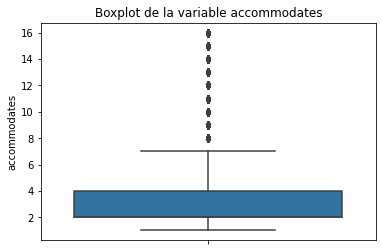

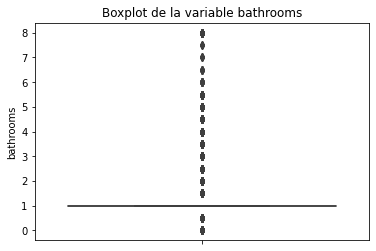

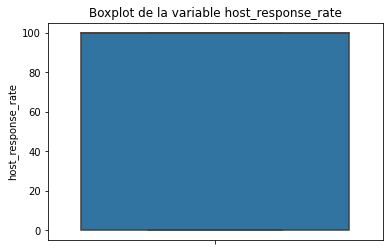

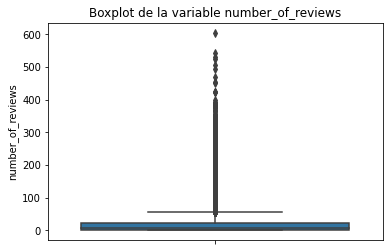

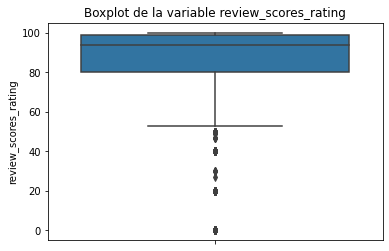

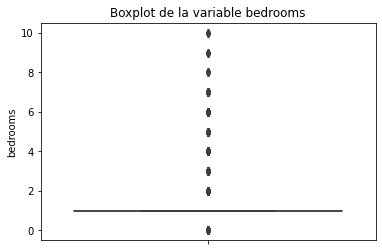

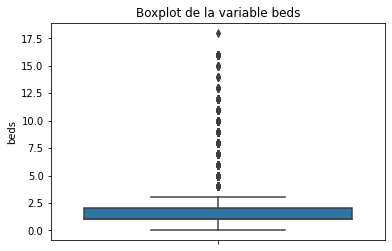

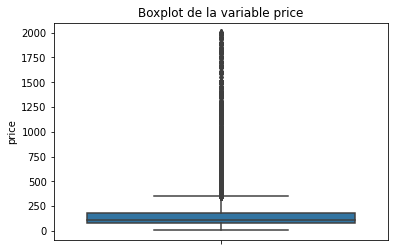

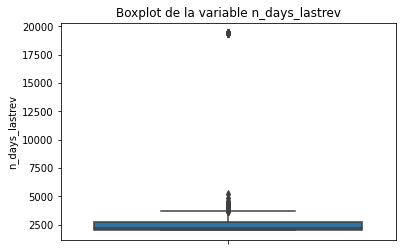

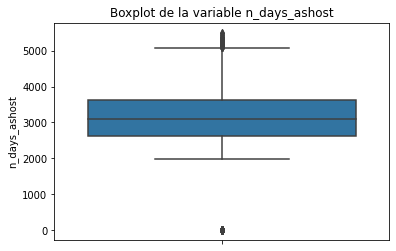

In [ ]:
# Boxplots
%matplotlib inline
for variable in df_estimados:
    sns.boxplot(y=df[variable])
    plt.title('Boxplot de la variable {0}'.format(variable))
    plt.show()

Como se comentó previamente, en las boxplot se observan variables con muchos datos atípicos. También, hay variables con rango intercuartílico 0, como bedrooms, donde el grueso de los datos está en un solo valor, o bien, otras con gran variabilidad como host_response_rate, que tienen una caja muy ancha.

Utiliza el Score de Rango Intercuartílico para filtrar tus valores atípicos. Compara tus medianas, medias y desviaciones estándares antes y después de realizar la filtración y ve cuánto cambiaron.


Text(0.5, 1.0, 'Boxplot del Precio con atípicos')

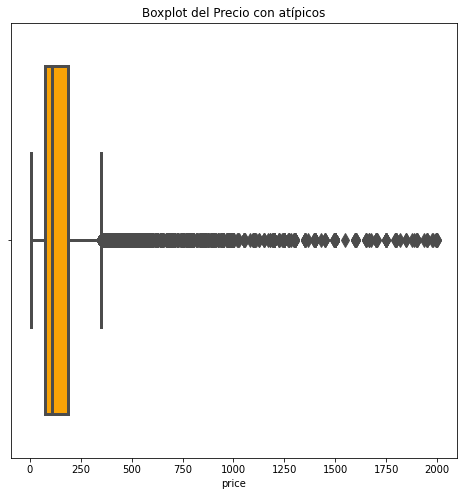

In [ ]:
plt.figure(figsize=(8,8))
sns.boxplot(x='price', data =df,
            color="orange",
            fliersize = 10, # Tamaño de los atípicos
            linewidth = 3,  # Grosor de las líneas
            saturation = 0.95).set_title("Boxplot del Precio con atípicos") #Saturación de color

In [ ]:
# Score de Rango Intercuartílico (IQR-Score) para la variable price, que es la de mayor interés.
iqr = df['price'].quantile(0.75) - df['price'].quantile(0.25)
filtro_inferior = df['price'] > df['price'].quantile(0.25) - (iqr * 1.5)
filtro_superior = df['price'] < df['price'].quantile(0.75) + (iqr * 1.5)

df_filtrado = df[filtro_inferior & filtro_superior]

Text(0.5, 1.0, 'Boxplot del Precio sin atípicos')

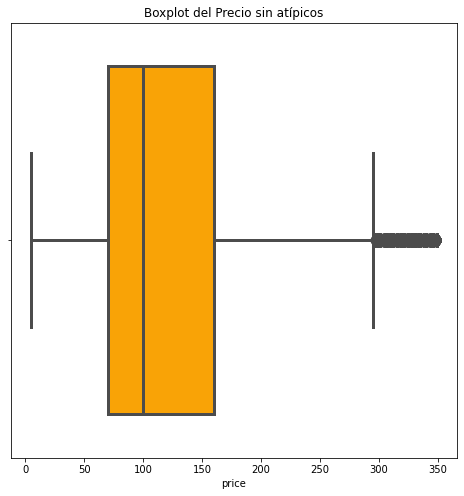

In [ ]:
plt.figure(figsize=(8,8))
sns.boxplot(x='price', data =df_filtrado,
            color="orange",
            fliersize = 10, # Tamaño de los atípicos
            linewidth = 3,  # Grosor de las líneas
            saturation = 0.95).set_title("Boxplot del Precio sin atípicos") #Saturación de color

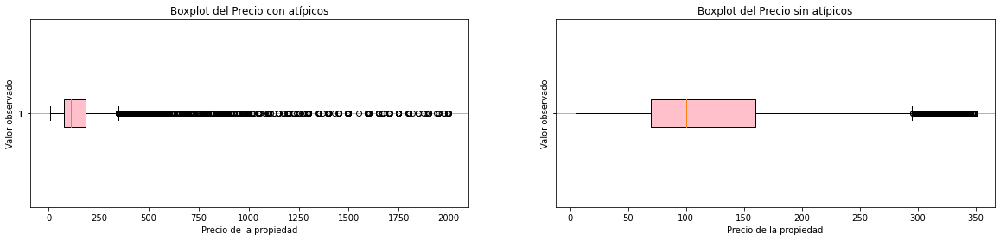

In [ ]:
#Ahora comparamos ambas en la misma figura
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,4), sharey=True)

# rectangular box plot
bplot1 = ax1.boxplot(x='price', data =df,
                     vert = False,
                     patch_artist=True) #Saturación de color

ax1.set_title("Boxplot del Precio con atípicos")

# notch shape box plot
bplot2 = ax2.boxplot(x='price', data =df_filtrado,
                    vert = False,
                     patch_artist=True) #Saturación de color

ax2.set_title("Boxplot del Precio sin atípicos")

colors = ['pink', 'lightblue', 'lightgreen']
for bplot in (bplot1, bplot2):
    for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)

# adding horizontal grid lines
for ax in [ax1, ax2]:
    ax.yaxis.grid(True)
    ax.set_xlabel('Precio de la propiedad')
    ax.set_ylabel('Valor observado')

plt.show()

Gracias a las boxplots, visualmente es claro cómo los valores atípicos en el precio son muchos. Originalmente, podría decirse que arriba de $300 USD ya es un outlier y hay muchos puntos que superar ese límite, seguramente de tipos de propiedades muy caras. Eliminando los registros con atípicos según IQR, se siguen apreciando outliers en lo alto, pero en mucha menor proporción.

In [ ]:
def visualize(dataframe, column, title_plot, whiskers=1.5):
    sns.boxplot(data=dataframe, x=column, whis=whiskers)
    plt.title(title_plot)
    print(dataframe[column].describe().T)

### Visulización del precio por ciudad

city
SF         165.0
Boston     137.0
DC         125.0
NYC        105.0
LA         100.0
Chicago     99.0
Name: price, dtype: float64

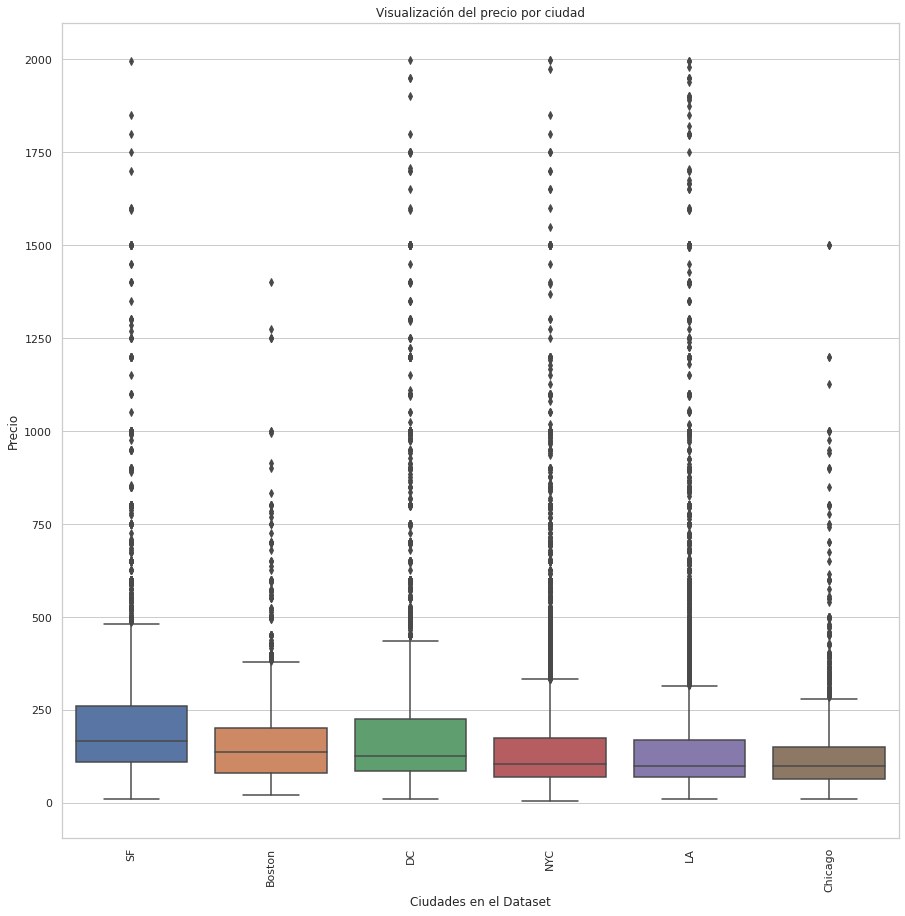

In [ ]:
sns.set(style="whitegrid")  
plt.figure(figsize=(15,15))
group_means = df.groupby(['city'])['price'].median().sort_values(ascending=False)
ax = sns.boxplot(data=df, x='city', y='price', order=group_means.index)
ax.set_title('Visualización del precio por ciudad')
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
ax.set_xlabel("Ciudades en el Dataset", size = 12)
ax.set_ylabel("Precio", size = 12)
group_means

city
SF         149.0
Boston     129.0
DC         110.0
NYC        100.0
LA          99.0
Chicago     95.0
Name: price, dtype: float64

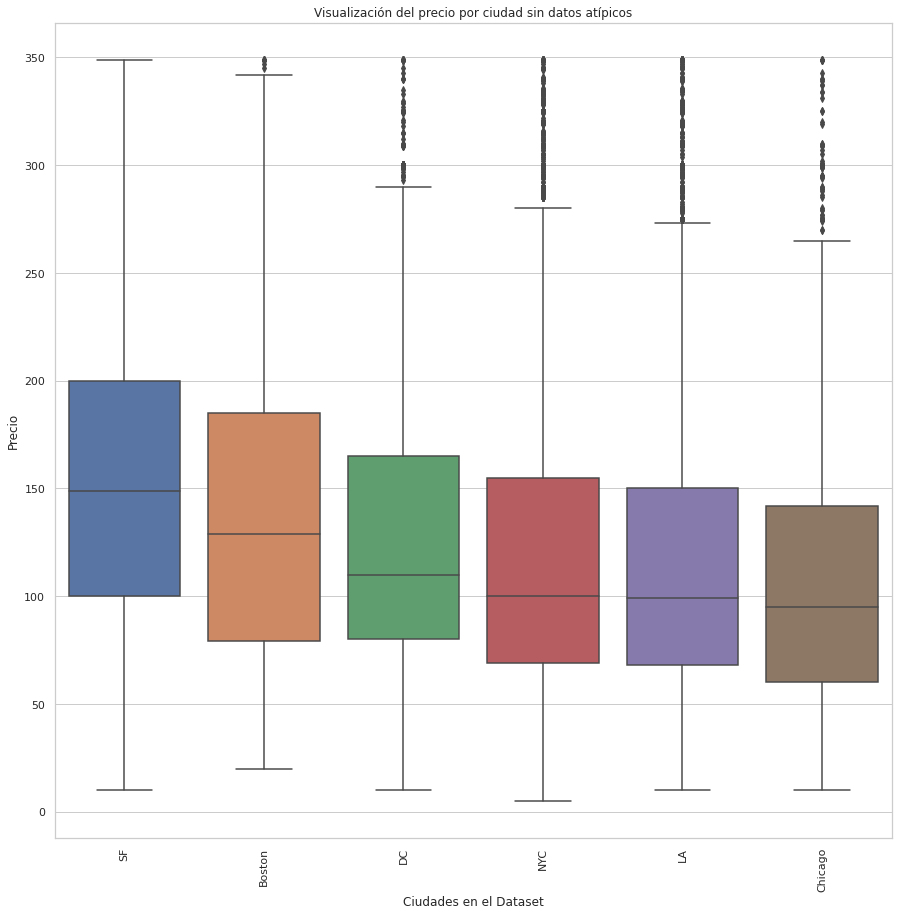

In [ ]:
sns.set(style="whitegrid")  
plt.figure(figsize=(15,15))
group_means = df_filtrado.groupby(['city'])['price'].median().sort_values(ascending=False)
ax = sns.boxplot(data=df_filtrado, x='city', y='price', order=group_means.index)
ax.set_title('Visualización del precio por ciudad sin datos atípicos')
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
ax.set_xlabel("Ciudades en el Dataset", size = 12)
ax.set_ylabel("Precio", size = 12)
group_means

En los dos graficos anteriores se puede observar el valor que tiene una propiedad en las disntintas ciudades, en el gráfico dos se tiene una apreciación más clara de la caja y los bigotes, después de eleminar los valores atípicos.

### Visualización del precio por tipo de propiedad

property_type
Earth House           275.0
Timeshare             250.0
Lighthouse            250.0
Castle                199.0
Boat                  189.0
Tipi                  185.0
Train                 182.5
Island                150.0
Condominium           149.0
Vacation home         147.5
Boutique hotel        147.0
Loft                  143.0
Cave                  136.0
In-law                130.0
Villa                 129.0
Serviced apartment    129.0
Other                 125.0
Bungalow              115.0
Apartment             114.0
Guest suite           109.0
Townhouse             108.0
Guesthouse            105.0
House                 100.0
Chalet                100.0
Yurt                   99.5
Bed & Breakfast        95.0
Cabin                  95.0
Camper/RV              89.0
Treehouse              87.0
Hut                    69.0
Tent                   45.0
Dorm                   43.0
Hostel                 32.0
Name: price, dtype: float64

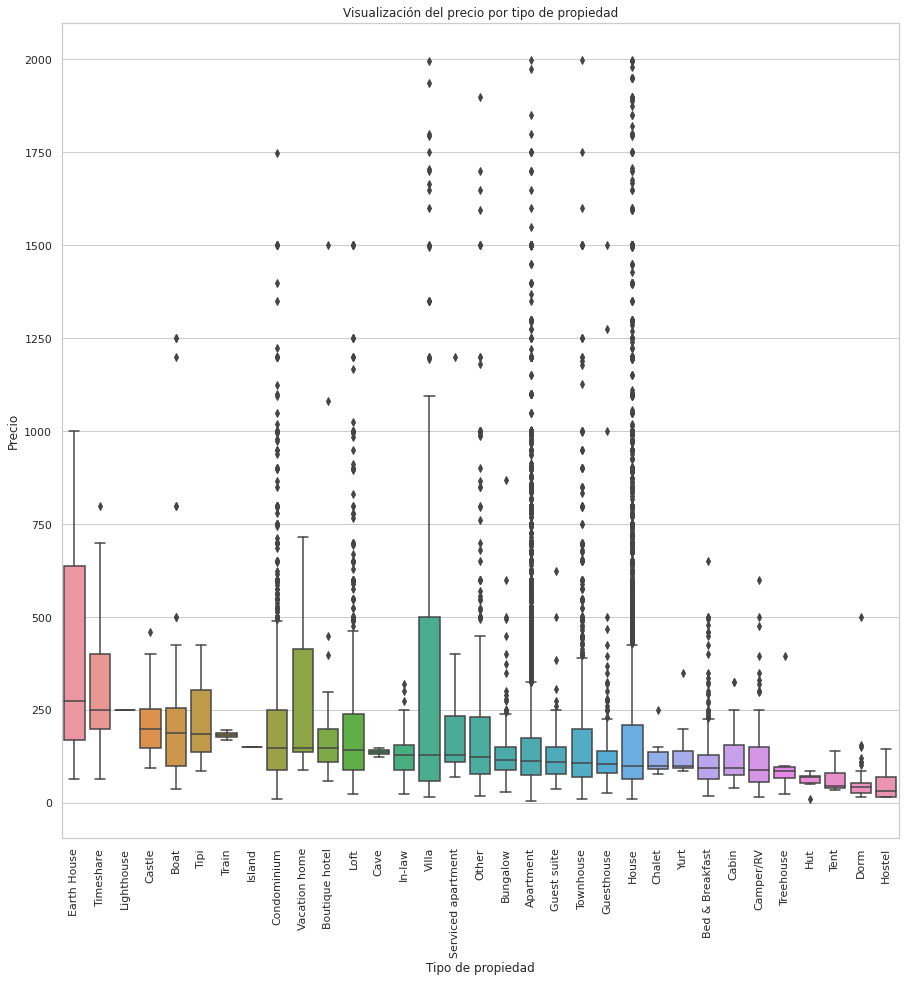

In [ ]:
sns.set(style="whitegrid")  
plt.figure(figsize=(15,15))
group_means = df.groupby(['property_type'])['price'].median().sort_values(ascending=False)
ax = sns.boxplot(data=df, x='property_type', y='price', order=group_means.index)
ax.set_title('Visualización del precio por tipo de propiedad')
ax.set_xlabel("Tipo de propiedad", size = 12)
ax.set_ylabel("Precio", size = 12)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
group_means 

property_type
Lighthouse            250.0
Timeshare             225.0
Train                 182.5
Castle                175.0
Earth House           170.0
Island                150.0
Vacation home         137.5
Cave                  136.0
Tipi                  136.0
Boutique hotel        135.0
In-law                130.0
Boat                  129.0
Serviced apartment    125.0
Condominium           125.0
Loft                  125.0
Bungalow              110.0
Other                 109.0
Apartment             108.0
Guest suite           102.5
Guesthouse            100.0
Chalet                100.0
Townhouse              99.0
Yurt                   99.0
Bed & Breakfast        95.0
Cabin                  95.0
House                  90.0
Camper/RV              89.0
Treehouse              85.0
Villa                  75.0
Hut                    69.0
Tent                   45.0
Dorm                   43.0
Hostel                 32.0
Name: price, dtype: float64

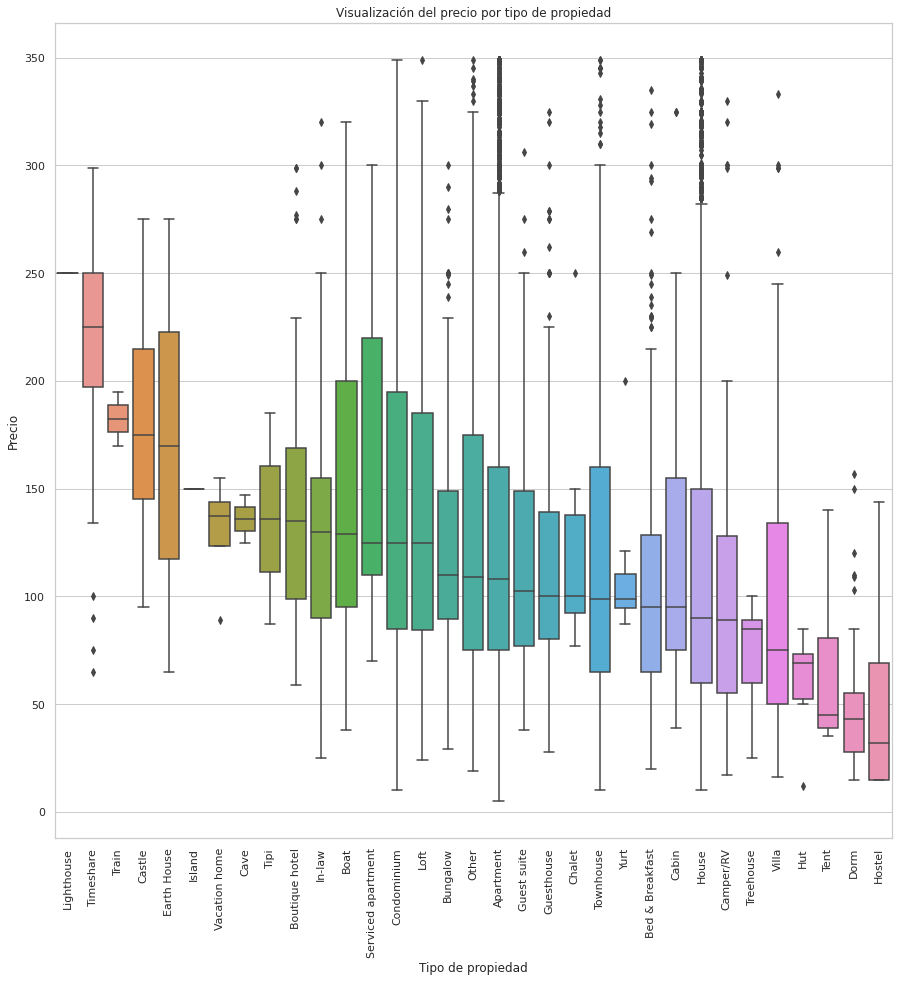

In [ ]:
sns.set(style="whitegrid")  
plt.figure(figsize=(15,15))
group_means = df_filtrado.groupby(['property_type'])['price'].median().sort_values(ascending=False)
ax = sns.boxplot(data=df_filtrado, x='property_type', y='price', order=group_means.index)
ax.set_title('Visualización del precio por tipo de propiedad')
ax.set_xlabel("Tipo de propiedad", size = 12)
ax.set_ylabel("Precio", size = 12)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
group_means

En los dos gráficos anteriores se muestran los precios de las propiedades de los distintos tipos de propiedades disponibles en airbnb. Nuevamente, en el gráfico dos se tiene una apreciación más clara de la caja y los bigotes, después de eleminar los valores atípicos.

### Cantidad de propiedades en renta en cada ciudad del dataset estudiado.

In [ ]:
# Número de propiedades por ciudad
data.groupby(['city'])['city'].count()

city
Boston      2728
Chicago     3008
DC          4554
LA         17973
NYC        25886
SF          5139
Name: city, dtype: int64

Text(0, 0.5, 'Cantidad de propiedades')

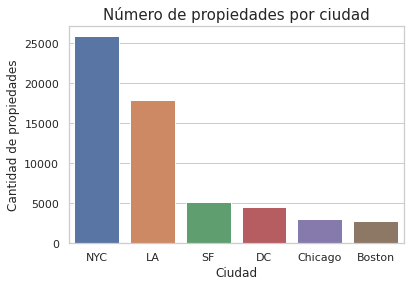

In [ ]:
# Gráfica de barras verticales usando `city`
ax = sns.countplot(data=df,
              x='city',
              order = df['city'].value_counts().index.to_list())
ax.set_title("Número de propiedades por ciudad", fontsize = 15)
ax.set_xlabel("Ciudad", size = 12)
ax.set_ylabel("Cantidad de propiedades", size = 12)

En el gráfico anterior se observa que la ciudad de Nueva York y Los Angeles son las ciudades con mayor cantidad de propiedaes en retan, del conjunto de datos estudiado.

Como se mencionó anteriormente, casi el 90% de los datos son dos tipos de propiedad (House y Apartment). De acuerdo a la visualización solo en el caso de New York City la mayor parte corresponde a departamentos. Esto lo podeos visualizar en la siguiente gráfica.

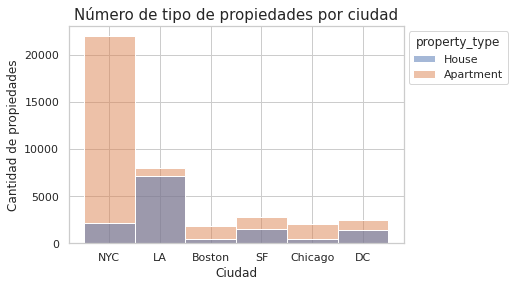

In [ ]:
ax = sns.histplot(data=df[df['property_type'].isin(['House', 'Apartment'])],
              x='city',
              hue='property_type',
              stat = 'count')
ax.set_title("Número de tipo de propiedades por ciudad", fontsize = 15)
ax.set_xlabel("Ciudad", size = 12)
ax.set_ylabel("Cantidad de propiedades", size = 12)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1,1))

In [ ]:
df_property_count=data.groupby(['city','property_type'])['property_type'].count()
df_property_count.head(20)
df_property_count.info()

<class 'pandas.core.series.Series'>
MultiIndex: 133 entries, ('Boston', 'Apartment') to ('SF', 'Yurt')
Series name: property_type
Non-Null Count  Dtype
--------------  -----
133 non-null    int64
dtypes: int64(1)
memory usage: 1.7+ KB


## Tablas de Frecuencias e Histogramas

Utiliza tablas de frecuencia e histogramas para observar la distribución de tus variables. Caracteriza cada una de las distribuciones usando los términos que aprendiste durante la sesión. Obtén medidas de asimetría y curtosis para ver qué tan alejadas de la distribución normal están tus variables.

Intervalos de clase. Regla de Sturges

k = 1 + 3.3 log n

A = R/K   -> Amplitud

donde: 

k => intervalo de clases

R => Rango

In [ ]:
def tablafrecuencias(variable = 'price'):
  var = df_estimados[variable]
  total = df_estimados[variable].count()
  k = math.ceil(1 + 3.3 * math.log(total,10))
  rango = var.max() - var.min()
  amplitud = rango/k

  segmentos = pd.cut(var,k)

  tabla = df[variable].groupby(segmentos).count()
  return  tabla

In [ ]:
def generarTablas ():

  df2 = df_estimados._get_numeric_data().columns

  for indice in df2:
    print(tablafrecuencias(indice))

In [ ]:
generarTablas()

accommodates
(0.985, 1.882]       7555
(1.882, 2.765]      25467
(2.765, 3.647]       6245
(3.647, 4.529]       9654
(4.529, 5.412]       2742
(5.412, 6.294]       4024
(6.294, 7.176]        738
(7.176, 8.059]       1403
(8.059, 8.941]          0
(8.941, 9.824]        219
(9.824, 10.706]       569
(10.706, 11.588]       65
(11.588, 12.471]      208
(12.471, 13.353]       31
(13.353, 14.235]       84
(14.235, 15.118]       43
(15.118, 16.0]        241
Name: accommodates, dtype: int64
bathrooms
(-0.008, 0.471]      161
(0.471, 0.941]       170
(0.941, 1.412]     46533
(1.412, 1.882]      3063
(1.882, 2.353]      6421
(2.353, 2.824]      1262
(2.824, 3.294]       844
(3.294, 3.765]       357
(3.765, 4.235]       227
(4.235, 4.706]        84
(4.706, 5.176]        54
(5.176, 5.647]        36
(5.647, 6.118]        19
(6.118, 6.588]        10
(6.588, 7.059]         6
(7.059, 7.529]         5
(7.529, 8.0]          36
Name: bathrooms, dtype: int64
host_response_rate
(-0.1, 5.882]       15294
(5

In [ ]:
def histogramas2(variable):
  sns.set_style('whitegrid')
  #sns.histplot(data=df_estimados, x=variable, binwidth=100, bins=200)
  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


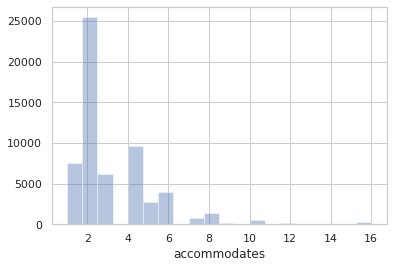

In [ ]:
histogramas2('accommodates')
# Muestra sesgo a la derecha

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


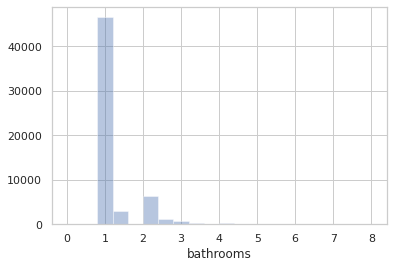

In [ ]:
histogramas2('bathrooms')

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


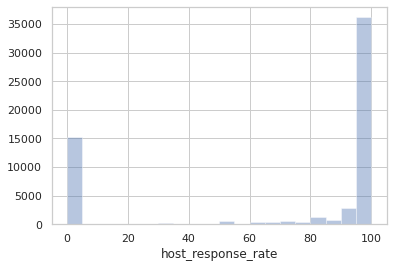

In [ ]:
histogramas2('host_response_rate')

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


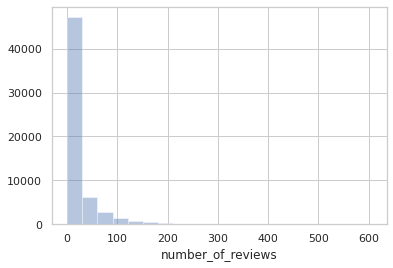

In [ ]:
histogramas2('number_of_reviews')
# Muestra sesgo a la derecha

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


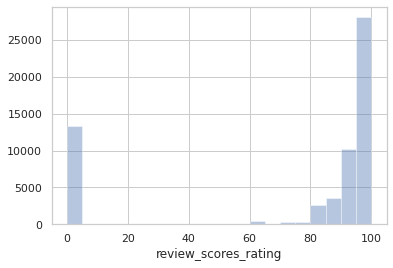

In [ ]:
histogramas2('review_scores_rating')
# Muestra sesgo a la izquierda

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


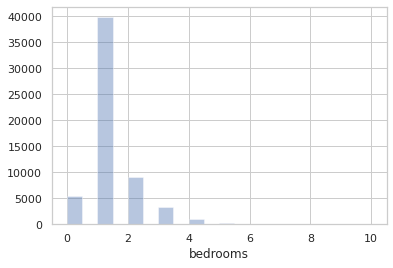

In [ ]:
histogramas2('bedrooms')

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


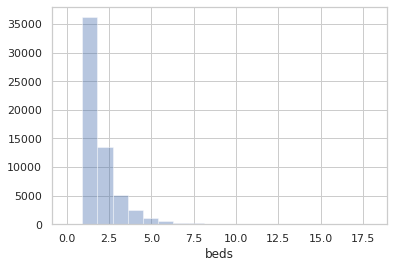

In [ ]:
histogramas2('beds')
# Muestra sesgo a la derecha

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


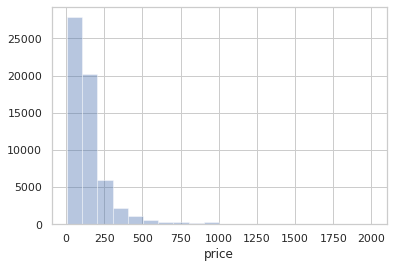

In [ ]:
histogramas2('price')
# Muestra sesgo a la derecha

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


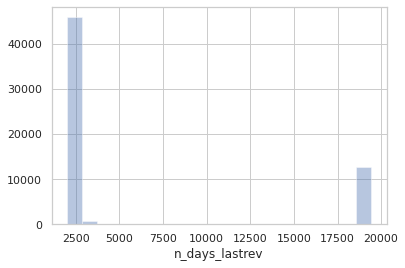

In [ ]:
histogramas2('n_days_lastrev')

<ipython-input-76-2339cd6a2c40>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados[variable], kde=False, norm_hist=False, bins=20)


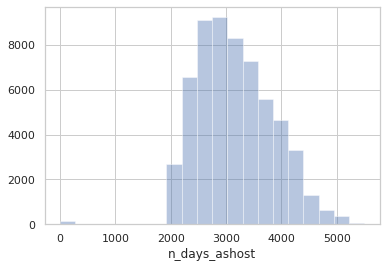

In [ ]:
histogramas2('n_days_ashost')
# Esta variable se distribuye parecido a una variable normal

Se ve que muchas de las variables numéricas presentan sesgo a la derecha (hacia valores bajos), pero hay otras como review_scores_rating sesgadas a la izquierda. La variable cuya distribución se parece más a una normal es n_days_ashost.

## Asimetría (skewness) y Curtosis (kurtosis)

In [ ]:
def kurtosisAsimetria():
  df2 = df_estimados._get_numeric_data().columns

  for indice in df2:
    print(f"La Curtosis de {indice} es:  {kurtosis(df_estimados[indice])}")
    print(f"La Asimetría de {indice} es:  {skew(df_estimados[indice])}")
    print()

In [ ]:
kurtosisAsimetria()

La Curtosis de accommodates es:  7.453593550885246
La Asimetría de accommodates es:  2.234582334012644

La Curtosis de bathrooms es:  22.69179718398622
La Asimetría de bathrooms es:  3.713479554987859

La Curtosis de host_response_rate es:  -0.9442384737899743
La Asimetría de host_response_rate es:  -0.9844476793525841

La Curtosis de number_of_reviews es:  20.083020292829694
La Asimetría de number_of_reviews es:  3.6684320680167315

La Curtosis de review_scores_rating es:  -0.39352583184978585
La Asimetría de review_scores_rating es:  -1.229651896773958

La Curtosis de bedrooms es:  7.537937604743856
La Asimetría de bedrooms es:  1.9774424354458084

La Curtosis de beds es:  19.919616536261437
La Asimetría de beds es:  3.3693956370458857

La Curtosis de price es:  26.945627869214537
La Asimetría de price es:  4.331887566506148

La Curtosis de n_days_lastrev es:  -0.039905326874027036
La Asimetría de n_days_lastrev es:  1.398337331985313

La Curtosis de n_days_ashost es:  0.527303906003

Viendo la asimetría positiva, se corrobora que beds, price, number_of_reviews, entre otras, están sesgadas a la derecha. Cuando la asimetría es negativa, como en review_scores_rating, se indica cierto sesgo a la izquierda.

Por otro lado, vemos que la curtosis es grande en variables como el precio (leptocúrtica), esto significa que el histograma es "puntiagudo" y los datos se concentran alrededor de la media; por otro lado, en variables como n_days_lastrev, se tienen distribuciones "aplanadas" y los datos no se concentran en algún valor.

## Gráficas de densidad

<ipython-input-89-78efd067589b>:4: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(data=df, x ='price', hue='city',fill = True, shade=False)


Text(0.5, 0, 'Precio')

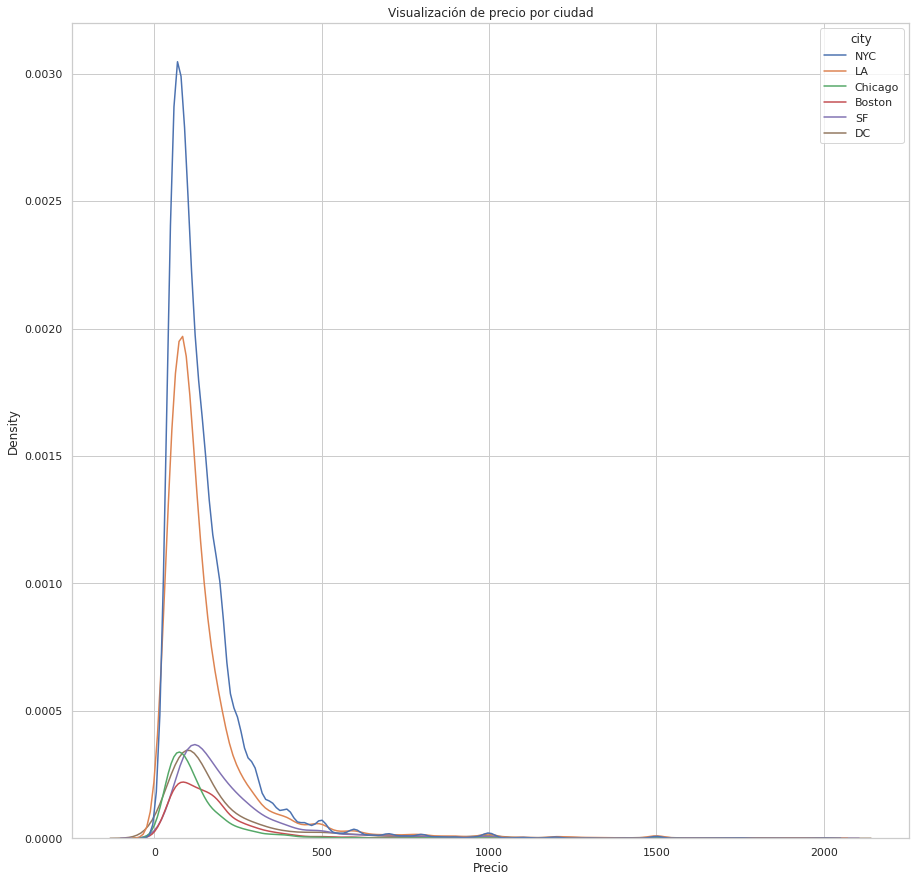

In [ ]:
# Gráfica de densidad de precios por ciudad
sns.set(style="whitegrid")  
plt.figure(figsize=(15,15))
ax = sns.kdeplot(data=df, x ='price', hue='city',fill = True, shade=False)
ax.set_title('Visualización de precio por ciudad')
ax.set_xlabel("Precio", size = 12)

En la grafica anterios se muestran nuevamente los precios por ciudad, donde las ciudades de Nueva York y Los Angeles tienen mayor densidad dado que existen más propiedades en renta en ambas ciudades.

In [ ]:
def densidades2(variable):
  sns.set_style('whitegrid')
  sns.kdeplot(x = df_estimados[variable], fill = True, color = "red", alpha=0.5)
  #sns.distplot(df_estimados[variable], hist=False)

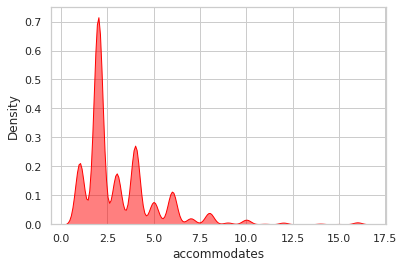

In [ ]:
densidades2('accommodates')

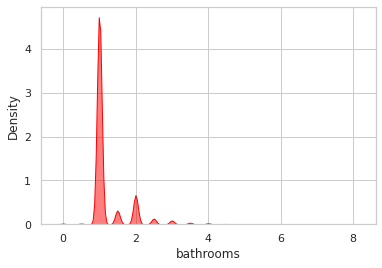

In [ ]:
densidades2('bathrooms')

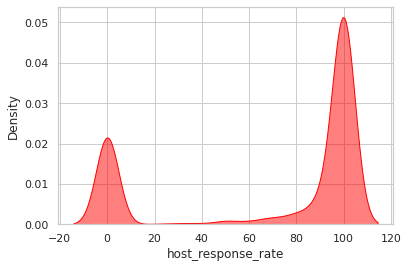

In [ ]:
densidades2('host_response_rate')

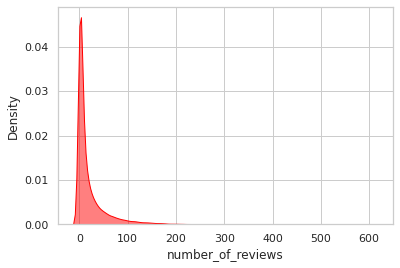

In [ ]:
densidades2('number_of_reviews')

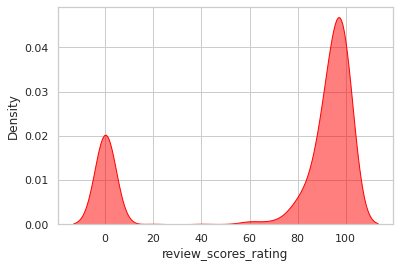

In [ ]:
densidades2('review_scores_rating')

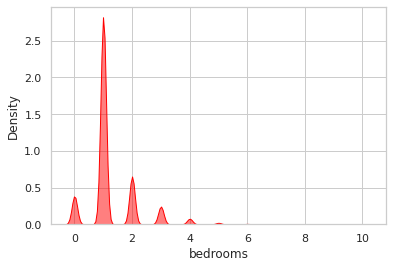

In [ ]:
densidades2('bedrooms') 

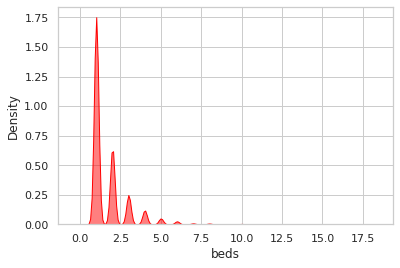

In [ ]:
densidades2('beds') 

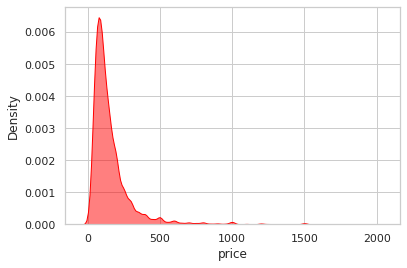

In [ ]:
densidades2('price') 

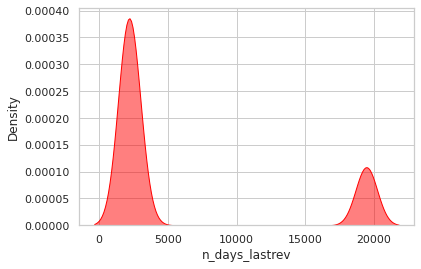

In [ ]:
densidades2('n_days_lastrev') 

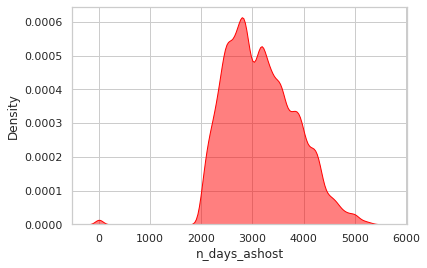

In [ ]:
densidades2('n_days_ashost') 

Finalmente, las gráficas de densidad permiten ratificar concentraciones en valores para algunas variables.

<ipython-input-101-5b1583986141>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados['price'], hist=False)
<ipython-input-101-5b1583986141>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_estimados['n_days_ashost'], hist=False)


<Axes: xlabel='n_days_ashost', ylabel='Density'>

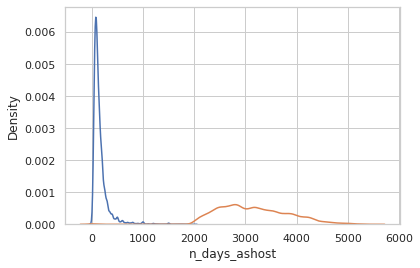

In [ ]:
sns.distplot(df_estimados['price'], hist=False)
sns.distplot(df_estimados['n_days_ashost'], hist=False)

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="var-cat">Postwork 3: EXPLORACIÓN DE VARIABLES CATEGÓRICAS Y ANÁLISIS MULTIVARIABLE</a></div> 
Objetivo

    Identificar distintas técnicas para explorar y visualizar variables categóricas.
    Añadir anotaciones a nuestras gráficas para hacerlas más comprensibles.
    Utilizar gráficas de barras.
    Graficar un conjunto de datos agrupado de acuerdo a dos variables categóricas.
    Producir más de una gráfica al mismo tiempo para compararlas.
    Graficar un conjunto de datos numéricos agrupados de acuerdo a una variable categórica.

Desarrollo

    1. Introducción

    2. Gráficas anotadas

    3. Títulos

    4. Nombres de ejes

    5. Leyendas

    6. Tamaño de la gráfica

    7. Gráficas de barras

    8. Gráficas de pie

    9. Moda

    10. Tablas de contingencia

    11. Boxplots

    12. Violinplots


    Postwork

EXPLORACIÓN DE VARIABLES CATEGÓRICAS Y ANÁLISIS MULTIVARIABLE

Objetivo

    Agregar anotaciones y títulos a las gráficas que hemos hecho hasta el momento.
    Realizar gráficas de barras para explorar la distribución de variables categóricas.
    Realizar tablas de contingencia y gráficas con múltiples axes para explorar dos o más variables categóricas.
    Usar boxplots y violinplots para explorar variables numéricas segmentadas por variables categóricas.


Desarrollo
Requisitos:

    Tener un dataset limpio.
    Tener una serie de preguntas que queremos contestar usando nuestro dataset.
    Haber explorado ya la distribuciones de nuestras variables numéricas.

Desarrollo:

En este Postwork vamos a explorar las distribuciones de las variables categóricas de nuestro dataset. En el postwork pasado exploramos las variables numéricas y ya deberías de tener una idea general bastante buena de cómo están organizadas. Ahora es momento de hacer análisis de variables categóricas y análisis multivariable. Realiza los siguientes pasos si tiene sentido aplicarlos a tu conjunto de datos:

    Si ya tienes gráficas realizadas en Postworks anteriores, agrega títulos, anotaciones y leyendas donde sea necesario. También cambia el tamaño de las gráficas donde tenga sentido hacerlo.
    Identifica todas las variables categóricas en tu dataset.
    Utiliza gráficas de barras para explorar la distribución de tus variables categóricas.
    Planea tu análisis multivariable: ¿qué combinaciones de variables categóricas podrían darme información útil acerca de la distribución de mis datos? ¿qué combinaciones de una variable numérica con una variable categórica podrían ser interesantes?
    Utiliza tablas de contingencia y múltiples gráficas en la misma figure para explorar combinaciones de variables categóricas.
    Utiliza boxplots y violinplots para explorar combinaciones de variables numéricas con variables categóricas.
    De preferencia ve registrando por escrito (ahí mismo en tu Notebook) todos tus hallazgos. Describe qué vas descubriendo y qué podría significar.



In [ ]:
for variable in ['city', 'neighbourhood', 'property_type', 'room_type', 'zipcode', 'bed_type', 'cleaning_fee', 'cancellation_policy', 'instant_bookable', 'host_has_profile_pic', 'host_identity_verified']:
    print("\n La variable '{0}' tiene {1} valores y son:".format(variable, len(np.unique(df[variable]))))
    print(np.unique(df[variable]))


 La variable 'city' tiene 6 valores y son:
['Boston' 'Chicago' 'DC' 'LA' 'NYC' 'SF']

 La variable 'neighbourhood' tiene 611 valores y son:
['16th Street Heights' 'Adams Morgan' 'Alamo Square' 'Albany Park'
 'Alhambra' 'Allerton' 'Allston-Brighton' 'Alondra Park' 'Alphabet City'
 'Altadena' 'American University Park' 'Anacostia' 'Andersonville'
 'Annadale' 'Arboretum' 'Arcadia' 'Archer Heights' 'Arleta'
 'Armour Square' 'Arts District' 'Ashburn' 'Astoria' 'Atwater Village'
 'Auburn Gresham' 'Austin' 'Avondale' 'Azusa' 'Back Bay'
 'Back of the Yards' 'Balboa Terrace' 'Baldwin Hills' 'Baldwin Park'
 'Barney Circle' 'Bath Beach' 'Battery Park City' 'Bay Ridge' 'Baychester'
 'Bayside' 'Bayview' 'Beacon Hill' 'Bedford Park' 'Bedford-Stuyvesant'
 'Bel Air/Beverly Crest' 'Bell' 'Bellevue' 'Bellflower' 'Belmont'
 'Belmont Cragin' 'Benning' 'Benning Heights' 'Benning Ridge'
 'Bensonhurst' 'Bergen Beach' 'Berkley' 'Bernal Heights' 'Beverly'
 'Beverly Hills' 'Bloomingdale' 'Boerum Hill' 'Borough

Distribución de la variable: city


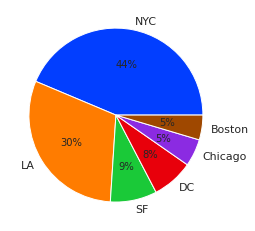

Distribución de la variable: neighbourhood


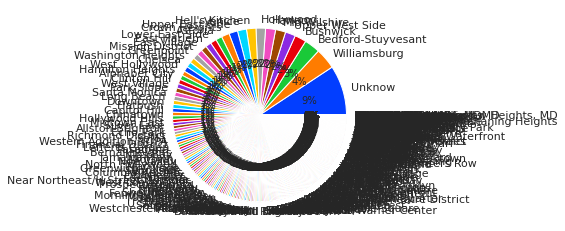

Distribución de la variable: property_type


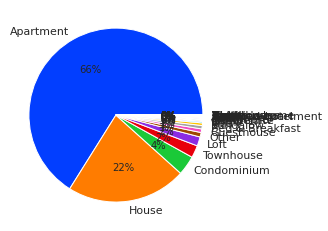

Distribución de la variable: room_type


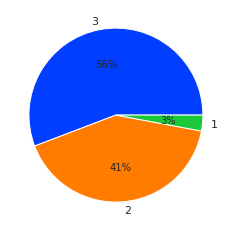

Distribución de la variable: zipcode


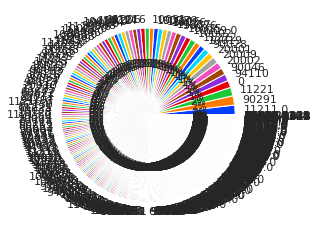

Distribución de la variable: bed_type


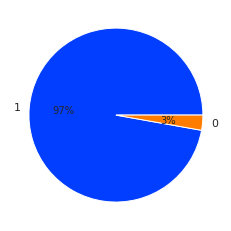

Distribución de la variable: cleaning_fee


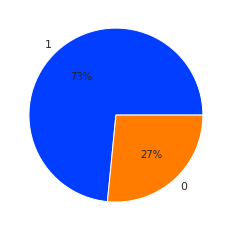

Distribución de la variable: cancellation_policy


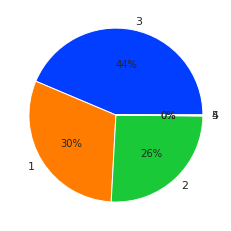

Distribución de la variable: instant_bookable


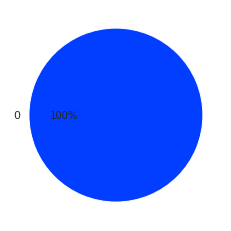

Distribución de la variable: host_has_profile_pic


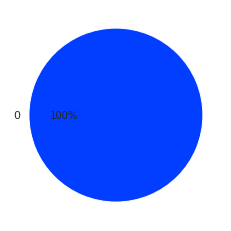

Distribución de la variable: host_identity_verified


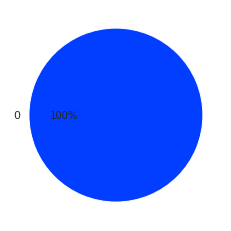

In [ ]:
%matplotlib inline
for variable in ['city', 'neighbourhood', 'property_type', 'room_type', 'zipcode', 'bed_type', 'cleaning_fee', 'cancellation_policy', 'instant_bookable', 'host_has_profile_pic', 'host_identity_verified']:
  print(f'Distribución de la variable: {variable}')
  df[variable].value_counts().reset_index()  
  data = (df[variable].value_counts().reset_index())[variable]
  keys = (df[variable].value_counts().reset_index())['index']
  palette_color = sns.color_palette('bright')
  plt.pie(data, labels=keys, colors=palette_color, autopct='%.0f%%')
  plt.show()
  #.iplot(kind="pie", labels="index", values=variable, title=f'Distribución de la variable {variable}')

Analizando la frecuencia de variables categóricas, vemos que zipcode y vecindarios tienen muchos posibles valores, alcanzando más de 600 para esta última variable. Por otro lado, hay variables unarias que tienen el 100% (o algo muy muy cercano a eso) de sus valores iguales. Tal es el caso de las booleanas instant_bookeable, host_identitity_verified y host_has_profile_pic. Así, estas variables no serán de utilidad para análisis posteriores pues no presentan gran variabilidad.

Ahora, tiene mérito conocer cómo se distribuyen los tipos de propiedad para cada ciudad. Como tenemos más de 100 tipos de propiedad, y dado que el 90% de ellas están son únicamente casas y departamentos, se agruparán todas las demás en un solo valor 'Others'. 

Enseguida se crea una tabla de contingencias de las variables tipo de propiedad y ciudad

In [ ]:
df['new_prop_type'] = df["property_type"].map(lambda x: 'Others' if x not in ['House', 'Apartment'] else x)

In [ ]:
# 1. Crear una tabla de contigencia de ciudad por tipo de propiedad
df_city = pd.crosstab(df['city'], df['new_prop_type'], normalize = True)
df_city

new_prop_type,Apartment,House,Others
city,,,
Boston,0.031726,0.007286,0.007000
Chicago,0.034391,0.007607,0.008737
DC,0.041408,0.023934,0.011469
LA,0.135137,0.121357,0.046654
NYC,0.370800,0.036787,0.029028
SF,0.047413,0.025553,0.013713


Acá se puede notar que la mayoría de propiedades en el conjunto de datos son departamentos en Nueva York, seguido por ese mismo tiepo de propiedad en Los Angeles. El resto de combinaciones se ve relativamente balanceadas con muy poco porcentaje del total.

####<div class="markdown-google-sans"><a name="barras-property_type">Diagramas de barras de tipos de propiedades por región</a></div> 


Text(0.5, 0.935, 'Número de tipos de propiedad por Ciudad')

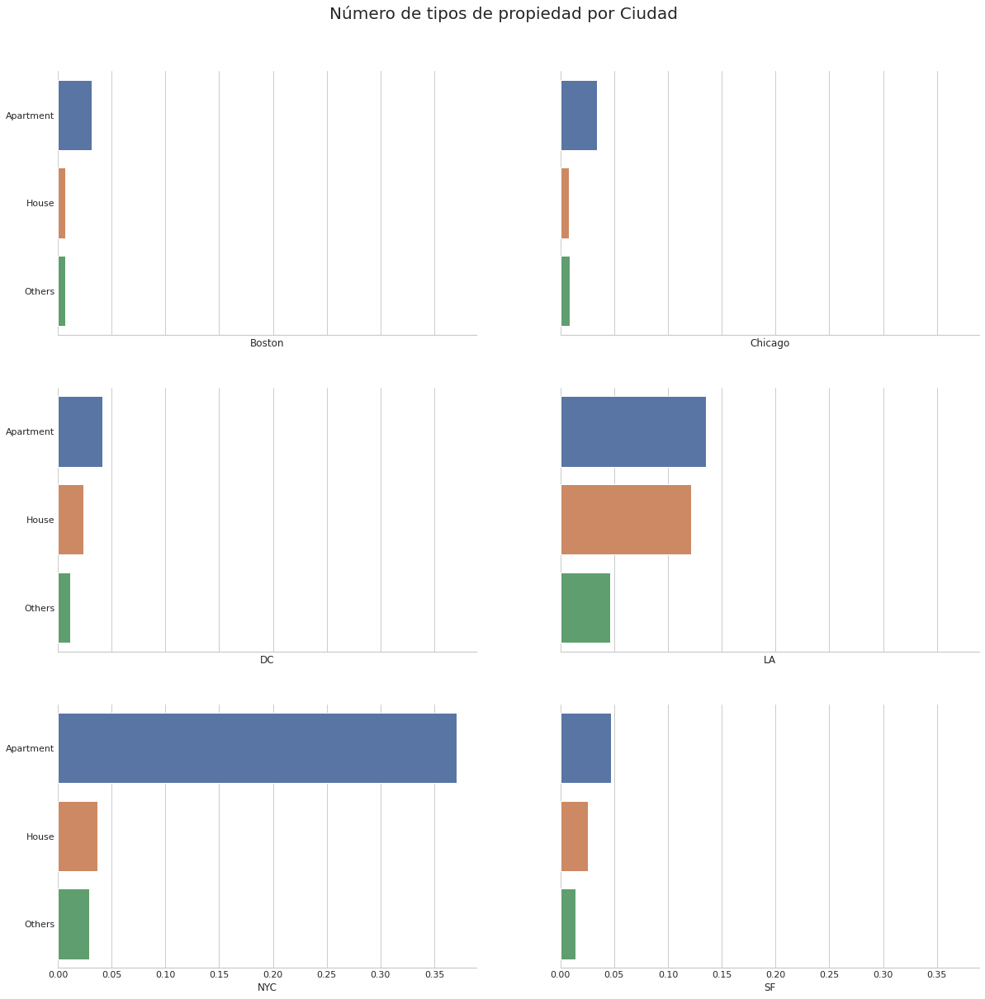

In [ ]:
#fig, ax = plt.subplots(nrows=3, ncols=2, #figsize = (10,10),sharex=True, sharey=True)
fig, ((ax1,ax2),(ax3,ax4),(ax5,ax6)) = plt.subplots(nrows=3, ncols=2,
                                                                  figsize = (20,20),
                                                                  sharex=True, sharey=True)
#fig.subplots_adjust(wspace=0.9)

sns.barplot(y = df_city.loc['Boston'].index,
            x = df_city.loc['Boston'],
            ax=ax1)
sns.barplot(y = df_city.loc['Chicago'].index,
            x = df_city.loc['Chicago'],
            ax=ax2)
sns.barplot(y = df_city.loc['DC'].index,
            x = df_city.loc['DC'],
            ax=ax3)
sns.barplot(y = df_city.loc['LA'].index,
            x = df_city.loc['LA'],
            ax=ax4)
sns.barplot(y = df_city.loc['NYC'].index,
            x = df_city.loc['NYC'],
            ax=ax5)
sns.barplot(y = df_city.loc['SF'].index,
            x = df_city.loc['SF'],
            ax=ax6)


ax1.tick_params(length = 0)
ax2.tick_params(length = 0)
ax3.tick_params(length = 0)
ax4.tick_params(length = 0)
ax5.tick_params(length = 0)
ax6.tick_params(length = 0)


sns.despine(left=True, right=True, top=True, bottom=False)

ax1.set_ylabel(None)
ax2.set_ylabel(None)
ax3.set_ylabel(None)
ax4.set_ylabel(None)
ax5.set_ylabel(None)
ax6.set_ylabel(None)



fig.suptitle("Número de tipos de propiedad por Ciudad", y = 0.935, fontsize = 20)

En todos los casos, predominan los apartamentos con gran diferencia, sobre todo en Nueva York. Llama la atención que ni siquiera agrupando todos los demás tipos de propiedad se alcanza a la segunda categoría más repetida. 

Text(0.5, 0, 'Precio')

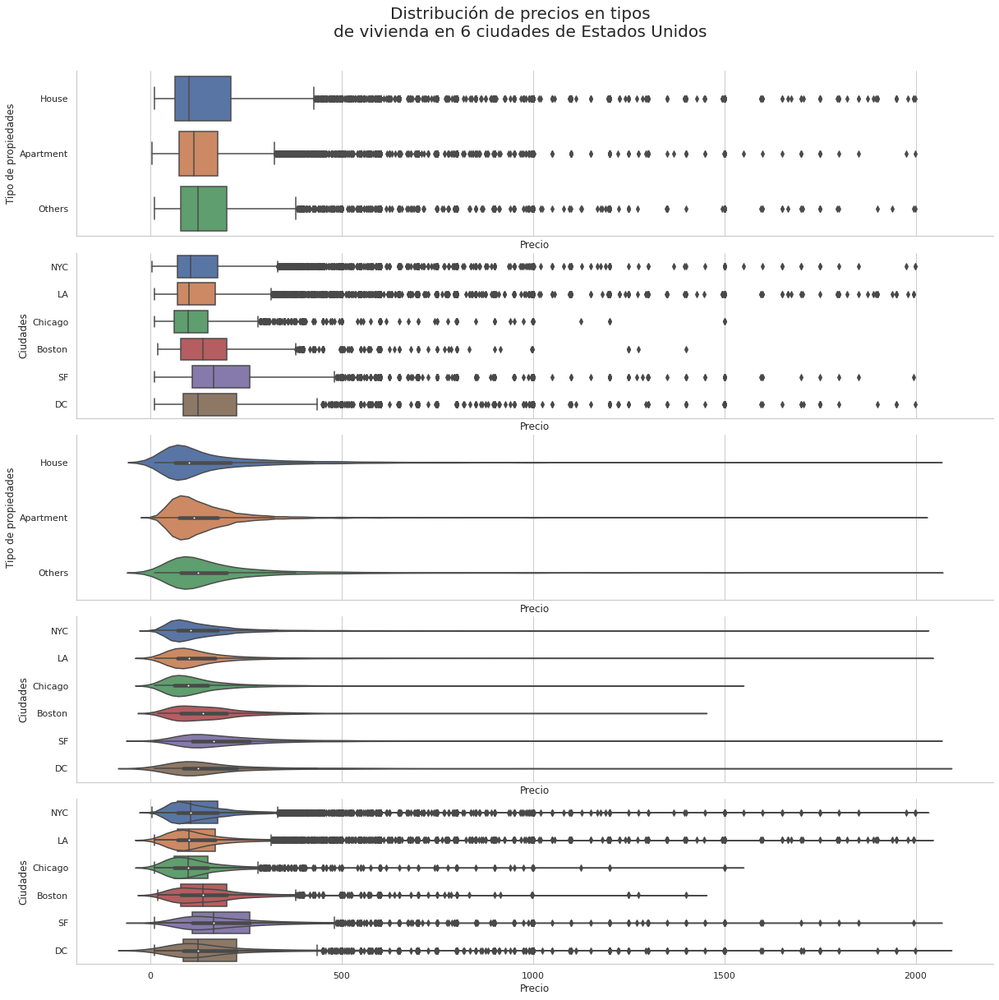

In [ ]:
# Crear figure
fig, (ax1,ax2,ax3,ax4,ax5) = plt.subplots(nrows=5, ncols=1, figsize = (20,20), sharex=True)
fig.subplots_adjust(hspace = 0.1)
fig.suptitle("Distribución de precios en tipos\nde vivienda en 6 ciudades de Estados Unidos", fontsize = 20, y = 0.935)
sns.despine()

# 2. y 3. Crear boxplot con eje x en 'type' y y en 'price' asi como titulo y anotaciones
sns.boxplot(data = df, x = 'price', y = 'new_prop_type', ax = ax1)
ax1.set_ylabel('Tipo de propiedades')
ax1.set_xlabel('Precio')

# 2. y 3. Crear boxplot con eje x en 'type' y y en 'price' asi como titulo y anotaciones
sns.boxplot(data = df, x = 'price', y = 'city', ax = ax2)
ax2.set_ylabel('Ciudades')
ax2.set_xlabel('Precio')

# 4. y 5. Crear violin plot con mismas variables y anotar titulo y anotaciones
sns.violinplot(data = df, x = 'price', y = 'new_prop_type', ax = ax3)
ax3.set_ylabel('Tipo de propiedades')
ax3.set_xlabel('Precio')

# 4. y 5. Crear violin plot con mismas variables y anotar titulo y anotaciones
sns.violinplot(data = df, x = 'price', y = 'city', ax = ax4)
ax4.set_ylabel('Ciudades')
ax4.set_xlabel('Precio')

# 6. Comparar
sns.violinplot(data = df, x = 'price', y = 'city', ax = ax5)
sns.boxplot(data = df, x = 'price', y = 'city', ax = ax5)
ax5.set_ylabel('Ciudades')
ax5.set_xlabel('Precio')

Tiene todo el mérito analizar variables numéricas segmentadas por alguna variable categórica y nó sólo frencuencias de éstas últimas. En este caso, es muy útil visualizar cómo varia el precio tanto por tipo de propiedad como por ciudad. 

Tanto los boxplots como los violinplots destacan la presencia de valores atípicos, sobre todo hacia lo alto, reflejados tanto en los puntos de las boxplots como en los picos tan largos de los violines (se está analizando el conjunto de datos sin filtrar). En general, la media de precio es similar para todos los tipos de propiedad y entre ciudades, excepto en San Francisco, donde se aprecia un precio más caro. 

Las últimas dos imágenes muestran una superposición de ambos tipos de gráficos y es posible notar como, en esencia, los dos cuentan la misma historia.

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="corr-reg-lin">Postwork 4: CORRELACIONES Y REGRESIÓN LINEAL SIMPLE</a></div> 
Objetivo

    Entender el concepto de correlación entre variables y por qué es relevante.
    Identificar el significado del coeficiente de correlación e interpretarlo.
    Hacer matrices de correlaciones y graficarlas usando heatmaps.
    Hacer gráficas de dispersión e interpretarlas.
    Aprender el concepto de Gráficas de Pares.
    Aprender el concepto de Regresión Linear Simple y cómo funciona el proceso de entrenamiento e interpretación.

Desarrollo

    1. Introducción:

    2. ¿Qué es entonces una correlación?

    3. Coeficiente de correlación

    4. Matriz de correlaciones

    5. Heatmaps o Mapas de Calor

    6. Scatterplots o Gráficas de Dispersión

    7. Pairplots o Gráficas de Pares

    8. Regresión Linear Simple


    Postwork

    CORRELACIONES Y REGRESIÓN LINEAR SIMPLE

Objetivo

    Realizar análisis bivariado con variables numéricas
    Identificar valores atípicos y decidir qué hacer con ellos
    Explorar las relaciones existentes entre nuestras variables numéricas
    Entrenar modelos de regresión lineal para realizar predicciones

Desarrollo

En este Postwork vamos a hacer análisis bivariado de nuestras variables numéricas. Si tu dataset sólo tiene variables categóricas o datos no estructurados (texto libre), entonces puedes pedirle a tu experta que te comparta algún dataset con el que puedas realizar estos ejercicios.
Utilizando tu dataset, realiza las siguientes actividades:

    Identifica cuáles son las variables numéricas en tu dataset.
    Asegúrate de que tengan el tipo de dato correcto y que no haya NaNs por ahí escondidos.
    Genera una matriz de correlaciones y un pairplot para visualizar de manera general las relaciones entre tus variables numéricas.
    Utilizando gráficas de dispersión y tus medidas de locación y dispersión, identifica dónde hay valores atípicos y decide qué hacer con ellos.
    Revisa si tu revisión de valores atípicos cambió de alguna manera las relaciones existentes.
    Donde consideres necesario, entrena modelos de Regresión Lineal con un o más pares de variables. Incluso si no te parece que realizar predicciones entre pares de variables tiene sentido para tu proyecto, prueba realizar un par de regresiones para que practiques el procedimiento.


A continuación se va a analizar la correlación entre variables numéricas del conjunto de datos, con la intención de aproximar el precio de las propiedades con un modelo de regresión lineal simple al que se le irá añadiendo complejidad.

In [ ]:
#Retomamos el DataFrame con variables numéricas
df_estimados

,accommodates,bathrooms,host_response_rate,number_of_reviews,review_scores_rating,bedrooms,beds,price,n_days_lastrev,n_days_ashost
0,2,0.0,100.0,15,89,1.0,1.0,50.0,2003,4200
1,2,1.0,0.0,12,98,1.0,1.0,199.0,2430,3272
2,4,1.0,80.0,26,94,0.0,2.0,85.0,2057,2756
3,3,1.0,100.0,33,95,1.0,2.0,70.0,2182,2559
4,5,2.0,100.0,60,88,2.0,2.0,72.0,2192,2960
...,...,...,...,...,...,...,...,...,...,...
59283,5,2.0,100.0,5,88,3.0,3.0,225.0,2239,4227
59284,2,1.5,100.0,11,100,1.0,1.0,200.0,2017,4644
59285,3,1.0,33.0,0,0,1.0,2.0,135.0,19436,2996
59286,3,1.0,86.0,11,100,1.0,1.0,115.0,2046,3141


In [ ]:
df_estimados.corr()

,accommodates,bathrooms,host_response_rate,number_of_reviews,review_scores_rating,bedrooms,beds,price,n_days_lastrev,n_days_ashost
accommodates,1.000000,0.500245,0.136909,0.043417,0.050059,0.705671,0.806765,0.514426,-0.050760,-0.002608
bathrooms,0.500245,1.000000,0.049705,-0.036974,-0.025301,0.583065,0.518770,0.452961,0.030599,-0.003255
host_response_rate,0.136909,0.049705,1.000000,0.282962,0.385598,0.058078,0.120452,-0.061501,-0.377211,0.017747
number_of_reviews,0.043417,-0.036974,0.282962,1.000000,0.294395,-0.034397,0.033760,-0.069193,-0.294634,0.199397
review_scores_rating,0.050059,-0.025301,0.385598,0.294395,1.000000,-0.009391,0.036819,-0.130256,-0.951795,0.121589
bedrooms,0.705671,0.583065,0.058078,-0.034397,-0.009391,1.000000,0.704894,0.486733,0.013264,0.017514
beds,0.806765,0.518770,0.120452,0.033760,0.036819,0.704894,1.000000,0.424714,-0.040446,-0.018770
price,0.514426,0.452961,-0.061501,-0.069193,-0.130256,0.486733,0.424714,1.000000,0.145922,0.018856
n_days_lastrev,-0.050760,0.030599,-0.377211,-0.294634,-0.951795,0.013264,-0.040446,0.145922,1.000000,-0.110537
n_days_ashost,-0.002608,-0.003255,0.017747,0.199397,0.121589,0.017514,-0.018770,0.018856,-0.110537,1.000000


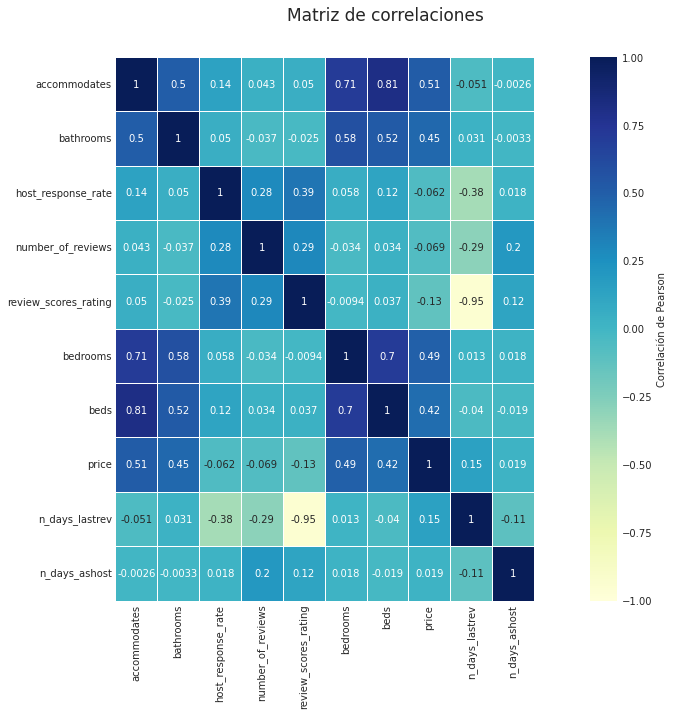

In [ ]:
#Matriz de correlaciones
plt.figure(figsize=(10, 10))
plt.suptitle("Matriz de correlaciones", size = 17, y = 0.95)

ax = sns.heatmap(df_estimados.corr(), vmin=-1, vmax=1, annot=True, cmap="YlGnBu", linewidths=.5,cbar_kws = {'orientation': 'vertical',
                                       'pad': 0.1},);
                                       
ax.tick_params(axis='both', length=0, labelsize=10)
cbar_corr = ax.collections[0].colorbar
cbar_corr.set_label('Correlación de Pearson', size=10)
cbar_corr.ax.tick_params(axis='both', length=0, labelsize=10, pad=5)

En la matriz de correlaciones se aprecian tanto relaciones directas (positivas) como inversas (negativas). Los únicos pares de variables con alta correlación son bedrooms-accommodates, beds-accommodates y n_days_ashost-review_scores_rating. Esto hace mucho sentido porque mientras más camas o recámaras haya, es lógico pensar que acepta más huéspedes. De igual manera, es lógico pensar que mientras más días hayan pasado desde la última revisión es porque la propiedad casi no se renta y, por ende, podría tener pocas reseñas y con bajas calificaciones.

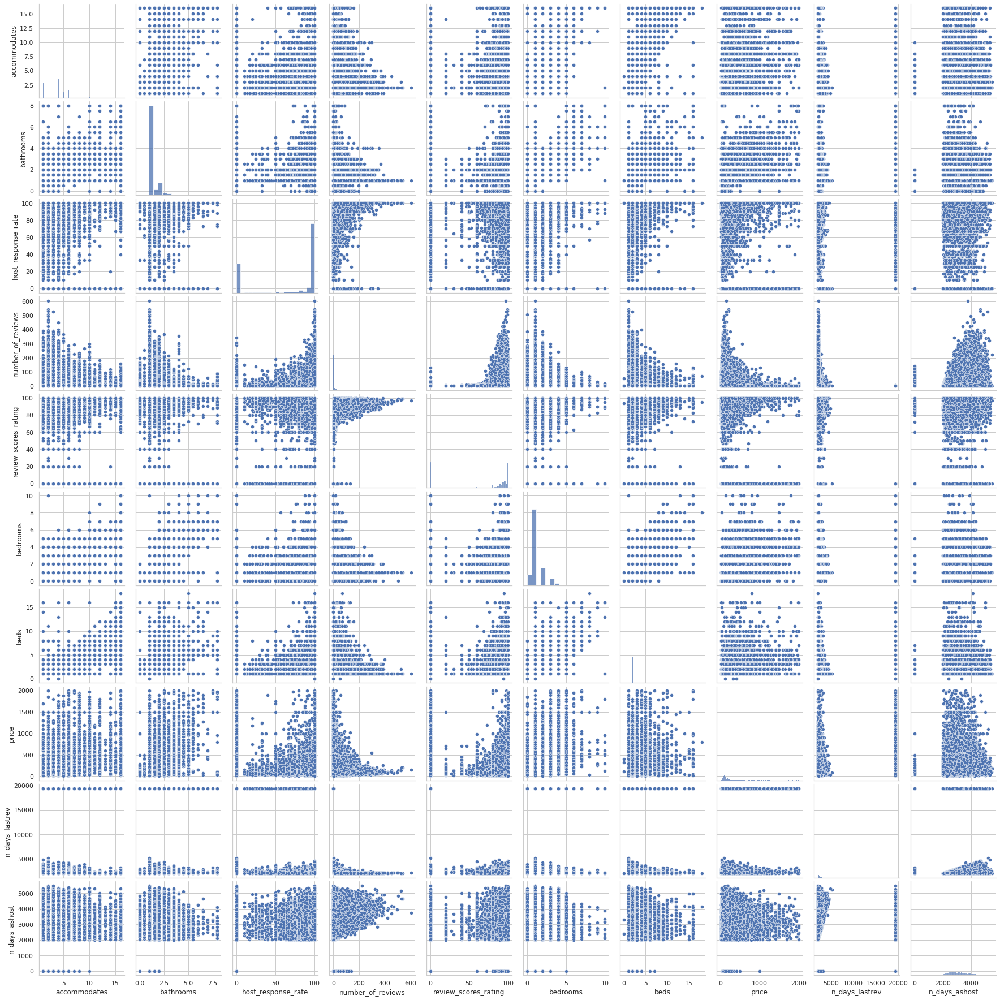

In [ ]:
sns.pairplot(df_estimados)

En la gráfica de pares se confirma lo visto en la matriz de correlaciones, con la ventaja de que visualmente se distingue la relación lineal (o no) existente entre las variables. Analizando la variable precio, la que mayor correlación tiene con ella es el número de huéspedes, sin embargo, no se aprecia alguna relación lineal entre ambas.

Identificando las variables que más pudieran explicar el precio de acuerdo a los gráficos, se hace un análisis por separado.

In [ ]:
#Testing:
# Variables prometedoras
vars_prom = ['beds', 'bedrooms', 'accommodates']
# Variables personales
vars_pers = ['price']

df_1 = df[vars_prom + vars_pers]
df_1.sample(3)

,beds,bedrooms,accommodates,price
54883,1.0,1.0,2,175.0
41182,1.0,1.0,1,36.0
28771,1.0,1.0,1,70.0


<Axes: xlabel='accommodates', ylabel='price'>

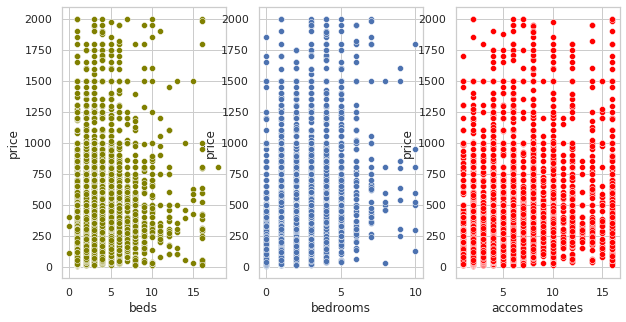

In [ ]:
# Visualizar scatter plots

fig, (ax1,ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (10,5))

sns.scatterplot(data = df_1, x = vars_prom[0], y = vars_pers[0], ax = ax1, color = 'olive')
sns.scatterplot(data = df_1, x = vars_prom[1], y = vars_pers[0], ax = ax2)
sns.scatterplot(data = df_1, x = vars_prom[2], y = vars_pers[0], ax = ax3, color = 'red')

## Regresión Lineal Simple

Una vez que se ha concluido con la exploración, el análisis y la interpretación de los datos disponibles, se quiere identificar qué de todo lo disponible es realmente importante en la determinación del precio de renta de la propiedad e intentar desarrollar un modelo predictivo del mismo. Para ello, se han de aplicar metodologías estadísticas para seleccionar las variables importantes y un modelo de regresión lineal para predecir el precio.

Importante mencionar que, como no se aprecia una relación lineal visual en los gráficos, es altamente probable que cualquier modelo linear generalizado (entre ellos, la regresión) no tenga buenos resultados prediciendo el precio con ninguna de las variables disponibles; sin embargo, para este apartado se entrenará un modelo donde la variable dependiente u objetivo será el precio y la dependiente, el número de huéspedes, ya que tienen la correlación más alta.

In [ ]:
#Regresión Lineal Simple
tgt = 'price'
predictors = ['accommodates']
#Seleccionamos únicamente las variables del DataFrame que vamos a utilizar y creamos uno nuevo, llamado X
X = df[predictors].copy()
y = df[tgt].copy()

In [ ]:
#Estandarización
sc = StandardScaler()
sc.fit(X)

Xsc = sc.transform(X)

In [ ]:
Xt, Xv, yt, yv = train_test_split(X, y, test_size=.2, random_state = 580)

In [ ]:
#Estandarización
sc = StandardScaler()
sc.fit(Xt)

Xtsc = sc.transform(Xt)
Xvsc = sc.transform(Xv)

In [ ]:
models = {'linreg': LinearRegression()
}

In [ ]:
for c in models:
    models.get(c).fit(Xtsc, yt)

In [ ]:
print("MÉTRICAS PARTIENDO EL CONJUNTO ORIGINAL EN ENTRENAMIENTO Y VALIDACIÓN")
print("para la variable 'price' vs 'accommodates'\n")
for c in models:
  print(c)
  print(f"R2_t: {r2_score(yt, models.get(c).predict(Xtsc))}")
  print(f"R2_v: {r2_score(yv, models.get(c).predict(Xvsc))}")
  print(f"MAE_t: {mean_absolute_error(yt, models.get(c).predict(Xtsc))}")
  print(f"MAE_v: {mean_absolute_error(yv, models.get(c).predict(Xvsc))}")
  print(f"MSE_t: {mean_squared_error(yt, models.get(c).predict(Xtsc))}")
  print(f"MSE_v: {mean_squared_error(yv, models.get(c).predict(Xvsc))}")
  print(f"RMSE_t: {mean_squared_error(yt, models.get(c).predict(Xtsc),squared=False)}")
  print(f"RMSE_v: {mean_squared_error(yv, models.get(c).predict(Xvsc),squared=False)}")
  print(f"ACCURACY_t: {models.get(c).score(Xtsc, yt)}")
  print(f"ACCURACY_v: {models.get(c).score(Xvsc, yv)}")
  scores = cross_val_score(models.get(c), Xsc, y, cv=50)
  print("%0.2f ACCURACY con desviación estándar de %0.2f" % (scores.mean(), scores.std()))
  print('\n')

MÉTRICAS PARTIENDO EL CONJUNTO ORIGINAL EN ENTRENAMIENTO Y VALIDACIÓN
para la variable 'price' vs 'accommodates'

linreg
R2_t: 0.2624103867568881
R2_v: 0.2726678838482598
MAE_t: 77.05162219568412
MAE_v: 77.31385041615725
MSE_t: 20623.034723168963
MSE_v: 21528.45092807518
RMSE_t: 143.60722378476984
RMSE_v: 146.72576777129225
ACCURACY_t: 0.2624103867568881
ACCURACY_v: 0.2726678838482598
0.26 ACCURACY con desviación estándar de 0.04




Los resultados no son alentadores, pues las variable seleccionada apenas explican poco más del 25% de la varianza del modelo. Esto indica que hay información que no está disponible en el conjunto de datos original, o bien que sí está pero no se está considerando, y que es muchísimo más importante para el cálculo del precio de la propiedad.

Nótese que, además, los diversos errores no son pequeños y el accuracy tampoco rebasa el 30%, incluso haciendo validación cruzada con 50 diferentes muestras de entrenamiento.

Gráficamente, se tiene que:

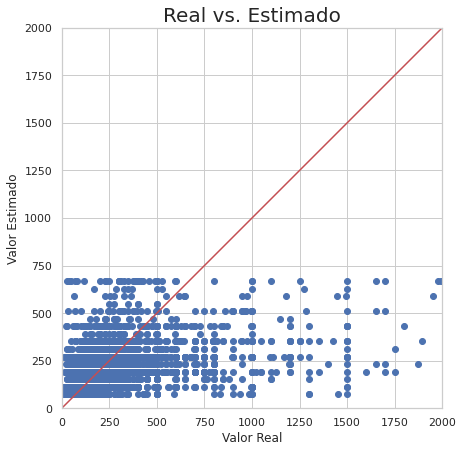

In [ ]:
plt.figure(figsize=(7,7))

# 1:1 line
eje_x = np.linspace(0,2500,10)
eje_y = eje_x

# Scatter plot predicted vs. actual
plt.scatter(yv, models.get('linreg').predict(Xvsc))
plt.plot(eje_x, eje_y, c='r')
plt.gca().set_aspect('equal')
plt.xlabel('Valor Real', size=12)
plt.ylabel('Valor Estimado', size=12)
plt.title('Real vs. Estimado', size=20)
plt.xlim(0,2000)
plt.ylim(0,2000)
plt.show()

Resulta evidente que el modelo con sólo una variable predice de manera poco aceptable el precio. Para precios bajos la diferencia es menor, pero no significa que sea una predicción buena. Llama la atención que el máximo precio estimado no rebasa los 750 USD, siendo que hay precios reales mucho mayores. Quizá esto se deba a que una mayoría de precios de las propiedades no rebasan los 500 USD y, entonces, el modelo no aprende relaciones ni patrones para precios mayores.

In [ ]:
print(f'Valor de las pendientes o coeficiente "a" {models.get("linreg").coef_}')

Valor de las pendientes o coeficiente "a" [85.6563178]


In [ ]:
print(f'Valor de la intersección o coeficiente "b": {models.get("linreg").intercept_}')

Valor de la intersección o coeficiente "b": 159.56327219059668


#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="dist-eval-mods">Postwork 5: DISTRIBUCIONES MUESTRALES Y TÉCNICAS DE EVALUACIÓN DE MODELOS</a></div> 
Objetivo

    Distinguir la diferencia entre población y muestra.
    Entender el concepto de 'sesgos' y por qué es tan importante estar conscientes de ellos.
    Aprender el concepto de muestreo aleatorio y cómo puede protegernos parcialmente de los sesgos.
    Utilizar la técnica 'bootstrap' como medio para explorar la distribución muestral de una estadística.
    Crear y utilizar histogramas, errores estándar e intervalos de confianza para evaluar la incertidumbre de una medida estadística.
    Utilizar técnicas para evitar sesgos en el entrenamiento de modelos, como la división de datasets y la validación cruzada.

Desarrollo

    1. Introducción

    2. Poblaciones y muestras

    3. Sesgos en nuestros conjuntos de datos

    4. Muestreo aleatorio o randomizado

    5. Distribuciones muestrales de estadísticas

    6. Bootstrap

    7. Histogramas

    8. Error estándar

    9. Intervalo de confianza

    10. Técnicas de evaluación de modelos

    11. Datasets de Entrenamiento y Prueba

    12. Validación cruzada


    Postwork
    
    DISTRIBUCIONES MUESTRALES Y TÉCNICAS DE EVALUACIÓN DE MODELOS

Objetivo

    Explorar las distribuciones muestrales de estadísticas de las variables numéricas en nuestro dataset
    Practicar el entrenamiento de modelos de Regresión Lineal Múltiple


    Desarrollo

En este Postwork vamos a analizar la incertidumbre y los sesgos que existen en las medidas de locación y dispersión de nuestras variables numéricas. También vamos a practicar el entrenamiento de modelos de Regresión Lineal Múltiple, aunque eso no sea el objetivo de tu proyecto. Realiza los siguientes pasos:

    Identifica las variables numéricas en tu dataset y revisa las medidas de locación y dispersión que ya has realizado de ellas.

    Utilizando la técnica de bootstrap, explora las distribuciones muestrales de las estadísticas que obtuviste anteriormente y reporta:
        La distribución, su asimetría y curtosis
        El error estándar
        El intervalo de confianza que te parezca más apropiado

    Si tiene sentido, elige algunas de tus variables numéricas para entrenar uno o más modelos de Regresión Lineal Múltiple. Utiliza las técnicas de división de dataset y validación cruzada de K-iteraciones para asegurarte de que tu modelo generalice.

    Comparte con tus compañeros y la experta tus hallazgos.


Seguimos analizando la variable precio, que es nuestro objetivo. Para seguir entendiendo su distribución, aplicamos bootstrapping.

Hay que recordar que la idea básica de bootstrap es que la inferencia sobre una población desconocida, asumiendo que ésta está conformada por tu muestra o conjunto de datos total, para luego armar muestras más pequeñas que se irán remuestreando para aproximar el sesgo, la varianza y hacer intervalos de confianza.

In [ ]:
def bootstrap():
  price = df['price']
  means = []
  for i in range(100000):
    sample = price.sample(n=50, replace=True)
    means.append(sample.mean())
    
  return pd.Series(means)

In [ ]:
serie_means = bootstrap()

<ipython-input-126-b134403010b6>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(serie_means, kde=False, norm_hist=False);


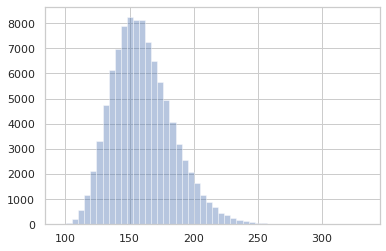

In [ ]:
sns.distplot(serie_means, kde=False, norm_hist=False);

In [ ]:
serie_means.skew()

0.6070123669361741

In [ ]:
serie_means.kurtosis()


0.5325849104158027

Vemos como, en efecto, el precio pudiera ser aproximado (remuestreando los datos) con una variable normal con media cercana a 150 USD, un ligero sesgo a la derecha (reflejado en la asimetría positiva) y siendo una distribución leptocúrtica (alargada) con datos algo concentrados alrededor de la media.

**Error Estándar**

In [ ]:
print(f'Error estándar: {serie_means.std()}')

Error estándar: 23.772226246234133


In [ ]:
print(f'Valor mínimo: {serie_means.min()}')
print(f'Valor máximo: {serie_means.max()}')
print(f'Rango: {serie_means.max() - serie_means.min()}')

Valor mínimo: 95.65999999999998
Valor máximo: 333.12
Rango: 237.46000000000004


<Axes: >

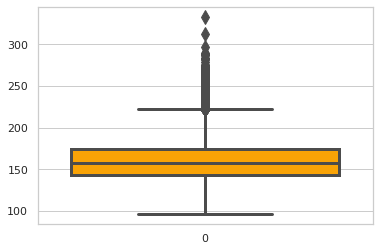

In [ ]:
sns.boxplot(data =serie_means,
            color="orange",
            fliersize = 10, # Tamaño de los atípicos
            linewidth = 3,  # Grosor de las líneas
            saturation = 0.95) #Saturación de color


Llama la atención como el bootstrapping ayudó a que ya no hubieran valores atípicos tan altos (el precio máximo apenas y supera los 300 USD, cuando antes superaba hasta los 2000 USD.

**Intervalos de Confianza**

Con un intervalo de confianza del 95%, se remueve el 2.5% de valores al principio y al final, y se deben obtener los nuevos valores mínimos  y máximos.

In [ ]:
limite_inferior = serie_means.quantile(0.025)
limite_superior = serie_means.quantile(0.975)

In [ ]:
precio = df['price']
print(f'Intervalo de 95% confianza de la media: {limite_inferior} < {precio.mean()} < {limite_superior}')

Intervalo de 95% confianza de la media: 120.76000000000002 < 159.95879435973552 < 213.18


In [ ]:
media_de_intervalos = ((precio.mean() - limite_inferior) + (limite_superior - precio.mean())) / 2

print(f'Intervalo de 95% confianza de la media: {precio.mean()} +/- {media_de_intervalos}')

Intervalo de 95% confianza de la media: 159.95879435973552 +/- 46.209999999999994


<ipython-input-135-5881df1d38d1>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(serie_means, kde=False, norm_hist=False)


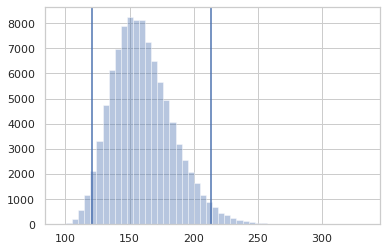

In [ ]:
sns.distplot(serie_means, kde=False, norm_hist=False)
plt.axvline(limite_inferior)
plt.axvline(limite_superior);

Finalmente, se puede distinguir cómo el intervalo de confianza al 95% deja la gran mayoría de los datos dentro y nos indica que el precio de una propiedad de Airbnb en Estados Unidos oscila, con un 95% de confianza, entre los 114 y los 206 USD, aproximadamente.

**Regresión Lineal Múltiple**

En apartados anteriores se entrenó un modelo de regresión lineal con pobres resultados, de modo que tiene mérito intentar añadir variables para ver si el desempeño y el poder predictivo mejoran.

Recordemos la matriz de correlaciones para ver qué variables añadir:

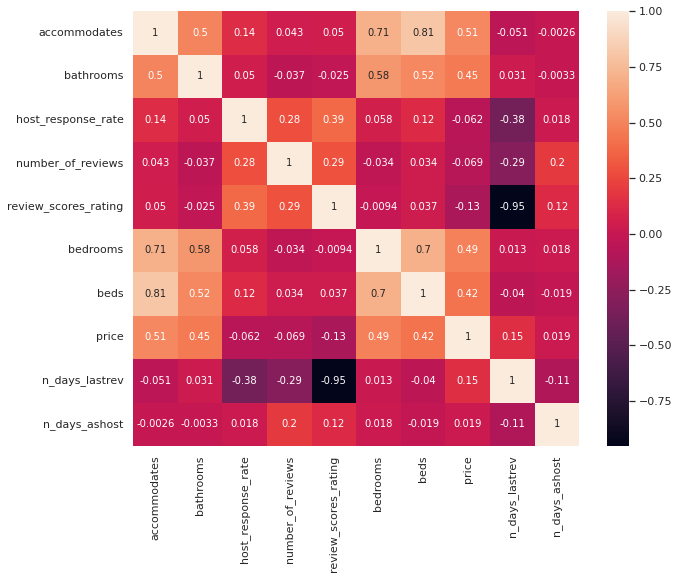

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(df_estimados.corr(), annot=True);

Las variables que mayor correlación tienen con el precio son accommodates, beds, bedrooms y bathrooms; sin embargo, nótese que beds y bedrooms están altamente correlacionadas con el número de huéspedes y, por tanto, incluirlas en el mismo modelo podría ocasionar un problema de colinealidad. De tal manera, se añadirá únicamente el número de baños al modelo.

In [ ]:
#Regresión Lineal Múltiple
tgt = 'price'
predictors = ['accommodates', 'bathrooms']
#Seleccionamos únicamente las variables del DataFrame que vamos a utilizar y creamos uno nuevo, llamado X
X = df[predictors].copy()
y = df[tgt].copy()

In [ ]:
#Estandarización - Esto elimina el efecto de la escala
sc = StandardScaler()
sc.fit(X)

Xsc = sc.transform(X)

In [ ]:
Xt, Xv, yt, yv = train_test_split(X, y, test_size=.2, random_state = 580)

In [ ]:
#Estandarización
sc = StandardScaler()
sc.fit(Xt)

Xtsc = sc.transform(Xt)
Xvsc = sc.transform(Xv)

In [ ]:
models = {'linreg': LinearRegression()
}

In [ ]:
for c in models:
  models.get(c).fit(Xtsc, yt)

In [ ]:
print("MÉTRICAS PARTIENDO EL CONJUNTO ORIGINAL EN ENTRENAMIENTO Y VALIDACIÓN")
print("para la variable 'price' vs 'accommodates'\n")
for c in models:
  print(c)
  print(f"R2_t: {r2_score(yt, models.get(c).predict(Xtsc))}")
  print(f"R2_v: {r2_score(yv, models.get(c).predict(Xvsc))}")
  print(f"MAE_t: {mean_absolute_error(yt, models.get(c).predict(Xtsc))}")
  print(f"MAE_v: {mean_absolute_error(yv, models.get(c).predict(Xvsc))}")
  print(f"MSE_t: {mean_squared_error(yt, models.get(c).predict(Xtsc))}")
  print(f"MSE_v: {mean_squared_error(yv, models.get(c).predict(Xvsc))}")
  print(f"RMSE_t: {mean_squared_error(yt, models.get(c).predict(Xtsc),squared=False)}")
  print(f"RMSE_v: {mean_squared_error(yv, models.get(c).predict(Xvsc),squared=False)}")
  print(f"ACCURACY_t: {models.get(c).score(Xtsc, yt)}")
  print(f"ACCURACY_v: {models.get(c).score(Xvsc, yv)}")
  scores = cross_val_score(models.get(c), Xsc, y, cv=50)
  print("%0.2f ACCURACY con desviación estándar de %0.2f" % (scores.mean(), scores.std()))
  print('\n')

MÉTRICAS PARTIENDO EL CONJUNTO ORIGINAL EN ENTRENAMIENTO Y VALIDACIÓN
para la variable 'price' vs 'accommodates'

linreg
R2_t: 0.31237391908037015
R2_v: 0.3278366913460877
MAE_t: 75.89535827739395
MAE_v: 76.62231569333056
MSE_t: 19226.052385702504
MSE_v: 19895.498197675424
RMSE_t: 138.6580411865915
RMSE_v: 141.05140267886534
ACCURACY_t: 0.31237391908037015
ACCURACY_v: 0.3278366913460877
0.32 ACCURACY con desviación estándar de 0.04




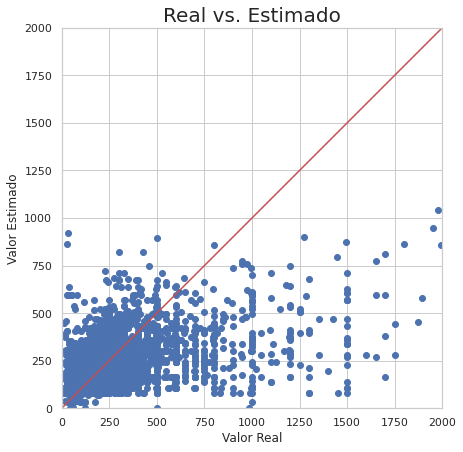

In [ ]:
plt.figure(figsize=(7,7))

# 1:1 line
eje_x = np.linspace(0,2500,10)
eje_y = eje_x

# Scatter plot predicted vs. actual
plt.scatter(yv, models.get('linreg').predict(Xvsc))
plt.plot(eje_x, eje_y, c='r')
plt.gca().set_aspect('equal')
plt.xlabel('Valor Real', size=12)
plt.ylabel('Valor Estimado', size=12)
plt.title('Real vs. Estimado', size=20)
plt.xlim(0,2000)
plt.ylim(0,2000)
plt.show()

Nótese como agregar una variable al modelo mejora, aunque sea un poco, todas las métricas: bajan los errores y aumentan tanto el R2 como el score/accuracy, incluso haciendo validación cruzada. 

No obstante, el modelo sigue siendo muy malo y requiere añadir más variables explicativas. No obstante, como el resto de variables disponibles tienen muy poca correlación con el precio, se presume que añadirlas no tendrá un gran impacto en el modelo y, más bien, se necesita recurrir a variables externas que puedan explicar mejor dicho comportamiento.

Se tiene también que el modelo mejora para precios bajos pues los puntos se aprecian ligeramente más cercanos a la recta identidad, además de que se difumina el efecto de la variable predictora discreta (la nube de puntos se ve más continua).

In [ ]:
y_predict = models.get('linreg').predict(Xvsc)

In [ ]:
y_predict

array([107.59928716, 167.09761495,  77.85012326, ..., 107.59928716,
       107.59928716, 167.09761495])

In [ ]:
print(f'Valor de las pendientes o coeficiente "a": {models.get("linreg").coef_}')

Valor de las pendientes o coeficiente "a": [64.24472477 43.074803  ]


In [ ]:
print(f'Valor de la intersección o coeficiente "b": {models.get("linreg").intercept_}') 
#Nótese como el intercepto coincide con la media calculada por bootstrap

Valor de la intersección o coeficiente "b": 159.56327219059668


**Validación Cruzada de K-Iteraciones**

Este método nos permite evaluar nuestro modelo de regresión lineal multiple. Sin cross validation se tiene que el score en el conjunto de validación es:

In [ ]:
print(models.get("linreg").score(Xvsc,yv))

0.3278366913460877


Se realiza la validación del modelo utilizando cross validation para conocer como se comporta el modelo ante datos que nunca ha visto.

In [ ]:
scores = cross_validate(models.get("linreg"), X, y, scoring='r2')

**En el test score se puede observar las cinco iteraciones que realizó el validador y se encuentra cierta variablididad en ellos debido a los datos de prueba que utiliza**

In [ ]:
scores

{'fit_time': array([0.04225564, 0.01477027, 0.01286173, 0.01339412, 0.013381  ]),
 'score_time': array([0.00679731, 0.00384355, 0.00338745, 0.00336695, 0.00473237]),
 'test_score': array([0.32666139, 0.29170076, 0.31805498, 0.31194928, 0.33287757])}

**Se calcula el promedio de las iteraciones para obtener el score del modelo, en donde podemos observar que este modelo no es adecuado para la predicción del precio ya que está muy por debajo del 1**

In [ ]:
print(f'Score del modelo: {scores["test_score"].mean():.3f} +/- {scores["test_score"].std():.3f}')

Score del modelo: 0.316 +/- 0.014


#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="visualizacion-avanzada">Postwork 6: VISUALIZACIÓN DE DATOS AVANZADA</a></div> 
Objetivo

Aprender a modificar los estilos predeterminados de nuestras gráficas

Desarrollo

    1. Introducción

    2. Estilos

    3. Treemaps

    4. Scatterplots por categorías

    5. Scatterplots con variables condicionantes

    6. Binning Hexagonal

    7. Un binning hexagonal hace lo siguiente:

    8. Mapas Coropléticos

    9. Gráficas de barras apiladas

    Postwork

VISUALIZACIÓN DE DATOS AVANZADA

Objetivo

    Realizar nuevos tipos de gráficas que nos ayuden a explorar y entender mejor nuestros datos
    Estilizar nuestras gráficas para que sean agradables a la vista y llamen la atención



##Treemap

Se agrega una visualización treemap, en donde se describe la cantidad de propiedades por su tipo por ciudad, modificando el tamaño de los rectángulos proporcionalmente al tamaño de la variable numérica total.

Primero leeremos el archivo limpio, y vamos a resetear su índice.

In [ ]:
df = pd.read_csv(file_path) 
df.reset_index()

,index,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,...,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds,price,n_days_lastrev,n_days_ashost
0,0,House,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",2,0.0,1,3,1,NYC,...,AFFORDABLE & COZY IN SUNSET PARK T,Sunset Park,15,89,11232,1.0,1.0,50.0,2003,4200
1,1,Apartment,3,"{Internet,""Wireless Internet"",Kitchen,Heating,...",2,1.0,1,3,1,LA,...,Luxurious and quiet - 30 second walk to the be...,Venice,12,98,90291,1.0,1.0,199.0,2430,3272
2,2,Apartment,3,"{TV,Internet,""Wireless Internet"",""Air conditio...",4,1.0,1,3,1,NYC,...,Bensonhurst STYLISH STUDIO,Bensonhurst,26,94,11214,0.0,2.0,85.0,2057,2756
3,3,Townhouse,2,"{""Wireless Internet"",""Air conditioning"",""Pets ...",3,1.0,1,3,1,LA,...,LA San Gabriel Suit room 圣盖博大套房 免费停车 Free Par...,San Gabriel,33,95,91776,1.0,2.0,70.0,2182,2559
4,4,Condominium,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",5,2.0,1,3,1,Chicago,...,"XTRA Large 2bdrm 2bath in the City near ""El"" T...",Woodlawn,60,88,60637,2.0,2.0,72.0,2192,2960
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59283,59283,House,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",5,2.0,1,2,1,LA,...,Lake Balboa House / Zen Retreat!,Lake Balboa,5,88,91406,3.0,3.0,225.0,2239,4227
59284,59284,Condominium,3,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",2,1.5,1,3,1,NYC,...,Modern Beautiful Duplex in Brownstone,Harlem,11,100,10027,1.0,1.0,200.0,2017,4644
59285,59285,Apartment,3,"{TV,Internet,""Wireless Internet"",""Air conditio...",3,1.0,1,2,1,LA,...,Artsy and Spacious Back House,West Los Angeles,0,0,90064,1.0,2.0,135.0,19436,2996
59286,59286,Apartment,3,"{TV,""Wireless Internet"",""Air conditioning"",""Wh...",3,1.0,1,3,1,NYC,...,Cozy Apartment off J&M Subway Lines,Bushwick,11,100,11206,1.0,1.0,115.0,2046,3141


Agrupamos las columnas necesarias para la creación de nuestro treemap, y renombramos la columna por total, que será nuestra variable numérica.

In [ ]:
df_treemap = df.query("index").groupby(['city','property_type'])[['city']].count()
df_treemap.rename(columns = {'city':'total'}, inplace = True)
df_treemap

total
city   property_type         
Boston Apartment         1881
       Bed & Breakfast     11
       Boat                 7
       Boutique hotel       1
       Condominium        273
...                       ...
SF     Timeshare           24
       Townhouse           37
       Treehouse            2
       Villa                1
       Yurt                 1

[133 rows x 1 columns]

In [ ]:
fig = px.treemap(df_treemap.reset_index(), path=[px.Constant("CIUDADES"), 'city', 'property_type'], values='total',
                 color='total', color_continuous_scale='RdBu',
                 title="Cantidad de tipos de propiedades por CIUDAD")

fig.show()

In [ ]:
#Agrupando las propiedades que no son departamentos ni casas en un solo tipo
df['new_prop_type'] = df["property_type"].map(lambda x: 'Others' if x not in ['House', 'Apartment'] else x)

In [ ]:
df_treemap2 = df.query("index").groupby(['city','new_prop_type'])[['city']].count()
df_treemap2.rename(columns = {'city':'total'}, inplace = True)

In [ ]:
fig = px.treemap(df_treemap2.reset_index(), path=[px.Constant("CIUDADES"), 'city', 'new_prop_type'], values='total',
                 color='total', color_continuous_scale='RdBu',
                 title="Cantidad de tipos de propiedades por CIUDAD")

fig.show()

Esta visualización es muy útil porque nos permite identificar de inmediato la propiedad que las propiedades más enlistadas en Airbnb son departamentos en Nueva York, pues cuentan con más de 20 mil propiedades y la mayoría de otras combinaciones ya se visualiza con la escala de color rojo (menor). 

Por un lado, como dueño esto te indica que tú departamento tendría mucha competencia para ser rentado  pero, por otro lado, la gran demanda en dicha ciudad sugiere que se rentaría a buen precio.

Nótese que, al ser las cajas más grandes, Nueva York y Los Angeles tienen más Airbnb y las otras ciudades menos, de modo que igual podría ser conveniente rentar ahí por la baja oferta.

Por último el treemap sin agrupar el resto de propiedades en "Otros", permite ver que un Loft sería el tipo de propiedad que sigue.

En general, este tipo de gráficos sirve para mostrar cómo se componen y distribuyen los datos.

##Mapa de Estados Unidos por tipos de propiedad

In [ ]:
#Sea local en VSCode o Colab de manera remota no usar >20000 datos porque Ambos son colapsan los equipos.
#El maximo número de datos probado exitosamente fue 10,000 datos.
#Probamos con los 5000 primeros datos 
#datamap = data[:5000] 
#Usamos una muestra de 5000 datos
#datamap=data.sample(n=5000, random_state=1)

#Sacamos 10% del dataset original para no colapsar el Colab
#5929 out of 59288
#datamap=data.sample(frac=0.1)

#Sacamos 2% del dataset original para no colapsar el Colab
#1186 out of 5988
datamap=df.sample(frac=0.02)


In [ ]:
#Check dataset size 
#datamap.info()
#datamap

In [ ]:
#Comentarlo, dejar únicamente el lambda con apply
#Locating Properties in United States maps
#Mapa de property_types es Estados Unidos
mapa = folium.Map(width='75%',height='75%',location=[38,-98],zoom_start=4)

#Plot locations - method 1 -with a FOR-Loop
for (index,row) in datamap.iterrows():
  if datamap.property_type[index] == "Apartment":
      type_color = "green"
  elif datamap.property_type[index] == "House":
      type_color = "red"
  else:
      type_color = "blue"
  folium.Marker(location = [row.loc['latitude'], row.loc['longitude']], 
              popup='Prop#:'+str(index)+'\nPrice: $'+str(round(row.loc['price'],2))+'USD\n '+row.loc['neighbourhood']+','+row.loc['city']+'\n '+row.loc['amenities'], 
              #popup=index,
              tooltip=row.loc,
              icon=folium.Icon(icon="glyphicon-home", prefix="glyphicon",color="%s" % type_color)).add_to(mapa)


In [ ]:
#Código para aplicar leyendas al mapa.
item_txt = """<br> &nbsp; {item} &nbsp; <i class="fa fa-map-marker fa-2x" style="color:{col}"></i>"""
html_itms1 = item_txt.format( item= "Apartment" , col= "green")
html_itms2 = item_txt.format( item= "House" , col= "red")
html_itms3 = item_txt.format( item= "Others" , col= "blue")
legend_html = """
     <div style="
     position: fixed;
     top: 200px; left: 50px; width: 230px; height: 130px; 
     border:2px solid grey; z-index:9999; 
     
     background-color:white;
     opacity: .85;
     
     font-size:14px;
     font-weight: bold;
     
     ">
     &nbsp; {title} 
     
     {itm_txt}

      </div> """.format( title = "US Map with property types", itm_txt= html_itms1+html_itms2+html_itms3)

mapa.get_root().html.add_child(folium.Element( legend_html ))

In [ ]:
mapa

El mapa permite ubicar geográficamente dónde están ubicadas las 6 ciudades analizadas. Esto parece trivial, pero si se considerara un conjunto de datos con más ciudades y/o más países del mundo, sería súper útil ubicar todos los lugares y los tipos de propiedad que más abundan en cada uno de una manera inmediata.

Adicional, el mapa nos permite ver la distancia entre cada ciudad y sólo eso nos da información. Por ejemplo, las ciudades más cercanas es más probable que pudieran tener comportamientos parecidos en la renta de propiedades, pues influyen factores geográficos como el clima, el relieve, etc. En este caso, Washington, NY y Boston podrían tener patrones similares tan sólo por su ubicación geográfica; esto, en efecto, se corrobora con el treemap donde la distribución de tipos de propiedad, número de propiedades en renta y precios son parecidas para Boston y Washington.

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="nlp">Postwork 7: PRUEBAS A/B Y PROCESAMIENTO DE LENGUAJE NATURAL</a></div> 
Objetivo

    Entender la teoría alrededor de las Pruebas A/B, los tests de permutaciones, el Valor P y el Alfa
    Aprender el concepto de Procesamiento de Lenguaje Natural y en qué tipo de datos se aplica

Desarrollo

    1. Introducción

    2. Pruebas A/B

    3. Test de hipótesis o prueba de significación

    4. Test de permutación

    5. Significación estadística

    6. Valor P

    7. Alfa (Alpha)

    8. Procesamiento de Lenguaje Natural

    9. ¿Reglas o estadística?


    Postwork
    
    Desarrollo
Requisitos

Tener un dataset limpio que contenga una columna con datos no estructurados.

En caso de que tu dataset no contenga datos no estructurados, date una vuelta por Kaggle y busca algún dataset apropiado. Lo que nos interesa es que practiques estas herramientas durante la clase para que puedas expresar tus dudas a la experta.
Desarrollo:

En esta sesión aprendimos dos cosas: Pruebas A/B y Procesamiento de Lenguaje Natural. No podemos practicar Pruebas A/B en nuestro proyecto, porque en realidad los proyectos que estamos realizando no se prestan a esto. No pasa nada, ¡ya tendrás oportunidad de practicar eso en tu primer trabajo como científico de datos!

Por lo pronto en este Postwork vamos a practicar las técnicas de Procesamiento de Lenguaje Natural que hemos aprendido. Si tu dataset no contiene datos no estructurados, busca un dataset apropiado y realiza los siguientes ejercicios. Si tu dataset contiene datos no estructurados, entonces éste es el momento de agregar PLN a tu proyecto.

Realiza los siguientes procedimientos en caso de que apliquen a tu dataset:

    Utiliza patrones Regex para limpiar tus datos estructurados.
    Dado que debes de conocer bien tu dataset (excepto si es un nuevo dataset que buscaste para este Postwork), es probable que tengas una idea de las palabras que son relevantes para tu tema. Genera un objeto Text con la librería nltk y explora los contextos de las palabras que elegiste. Utiliza el método similar para obtener palabras que tengan contextos similares a las palabras originales. Puede que descubras nuevas palabras que tengan relevancia para tu proyecto.
    Utiliza el objeto FreqDist de nltk para hacer análisis estadístico de tu dataset. Explora las palabras y los bigramas más comunes de tu dataset.
    Realiza visualizaciones de tus conteos de frecuencias utilizando gráficas de barras.
    Realiza visualizaciones de las distribuciones de frecuencias de las longitudes de las palabras o de las oraciones.
    Realiza nubes de palabras para detectar los temas más importantes de tu conjunto de datos.
    Haz un análisis de sentimientos de tu conjunto de datos, de preferencia utilizando una variable categórica para segmentar tus datos y poder comparar las distribuciones de polaridades entre cada segmento.


Para este apartado, haremos uso de la biblioteca de Procesamiento de Lenguaje
Natural NLTK de Python, que nos servirá para realizar algunos estadísticos en relación a las descripciones de las propiedades y las amenidades con las que cuentan.

Como primer punto, nos enfocaremos en las amenidades, que en el conjunto de datos vienen guardadas como una lista de Python (entre llaves y separadas por comas).

In [ ]:
#Primero actualizamos la librerías
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
#Procedemos a realizar un análisis de palabras en base a las amenidades ofrecidas por las distintas propiedades de nuestro dataset
#Leemos nuestro dataset y obtenemos la columna de amenidades
df = pd.read_csv(file_path) 
amenidades = df['amenities']
amenidades[0]

'{"Wireless Internet","Air conditioning",Kitchen,Heating,"Family/kid friendly","Smoke detector","Carbon monoxide detector","First aid kit","Safety card","Fire extinguisher",Essentials}'

In [ ]:
#Generación de lista de signos de puntuación

punctuation=[]
for s in string.punctuation:
    punctuation.append(str(s))
sp_punctuation = ["¿", "¡", "“", "”", "…", ":", "–", "{", "}"]    

punctuation += sp_punctuation
punctuation  = ['¿', '¡', '"', '...', ':', '–', '{', '}']    
punctuation

['¿', '¡', '"', '...', ':', '–', '{', '}']

Nota: Hay que ir probando a incluir más o menos palabras y signos de puntuación en las listas puesto que hay veces que puede aparecer un emoji o caracter raro que es necesario incluir para eliminarlo. Por ahora, ya se probó con las que están incluidas.

In [ ]:
#Hacemos una conversión de nuestros datos
amenidades_lista = amenidades.tolist()
amenidades_string = "".join(amenidades_lista)

#Reemplazamos signos de puntuación por "":

clean_amenidades1 = amenidades_string.replace('"','')
clean_amenidades2 = clean_amenidades1.replace('{','')
clean_amenidades = clean_amenidades2.replace('}','')

#No se reemplazan signos como "/" ó "_" porque algunas amenidades las incluyen como separadores que sustituyen los espacios.

In [ ]:
clean_amenidades

'Wireless Internet,Air conditioning,Kitchen,Heating,Family/kid friendly,Smoke detector,Carbon monoxide detector,First aid kit,Safety card,Fire extinguisher,EssentialsInternet,Wireless Internet,Kitchen,Heating,Smoke detector,Carbon monoxide detector,Fire extinguisher,Lock on bedroom door,translation missing: en.hosting_amenity_49,translation missing: en.hosting_amenity_50TV,Internet,Wireless Internet,Air conditioning,Wheelchair accessible,Kitchen,Pets allowed,Elevator,Buzzer/wireless intercom,Heating,Family/kid friendly,Washer,Dryer,Smoke detector,Carbon monoxide detector,First aid kit,Safety card,Fire extinguisher,Essentials,Shampoo,24-hour check-in,Hangers,Iron,Laptop friendly workspaceWireless Internet,Air conditioning,Pets live on this property,Cat(s),Hot tub,Heating,Smoke detector,Carbon monoxide detector,Essentials,Shampoo,Lock on bedroom door,Hangers,Hair dryer,Laptop friendly workspace,translation missing: en.hosting_amenity_49,translation missing: en.hosting_amenity_50TV,Cable 

Ya con nuestra información limpia, resulta evidente que con el fin de identificar qué palabras tendrán un mayor tamaño en nuestra nube de palabras, o en nuestros gráficos, es conveniente contabilizar la frecuencia de aparición de las mismas.

In [ ]:
#Empezamos separando la información; cada amenidad está separada por una ",".
lista_texto = clean_amenidades.split(",")

palabras = []

#Paso intermedio para eliminar palabras muy cortas (emoticonos,etc) y muy largas (ulr o similar) que se nos hayan pasado:

for palabra in lista_texto:
    if (len(palabra)>=3 and len(palabra)<18):
        palabras.append(palabra)
        
#Generamos un diccionario para contabilizar las palabras:

word_count={}

for palabra in palabras:
    if palabra in word_count.keys():
        word_count[palabra][0]+=1
    else:
        word_count[palabra]=[1]
        
word_count

#Convertimos el diccionario en un pandas DataFrame para ordernarlo:

df = pd.DataFrame.from_dict(word_count).transpose()
df.columns=["freq"]
df.sort_values(["freq"], ascending=False, inplace=True)
df.head(20)

,freq
Kitchen,53730
Heating,53260
Wireless Internet,49616
Smoke detector,49141
Essentials,48633
Air conditioning,43880
Hangers,38504
Shampoo,36081
Washer,34414
Hair dryer,33776


In [ ]:
#Se puede generar un Top 10 de las amenidades más frecuentes
def plot_bar(data=df,top=10):
  fig = plt.figure()
  ax = fig.add_axes([0,0,2,1])
  ax.bar(x = df.iloc[:top,:].index,height = df.iloc[:top,0].values,color = sns.color_palette("Spectral",len(df.iloc[:top,:].index)))
  ax.set_title('Top 10 de la frecuencia de amenidades más comunes', pad=10)
  ax.set_ylabel('Cantidad')
  ax.set_xlabel('Amenidad')
  ax.tick_params(axis='x', rotation=80)
  plt.show()

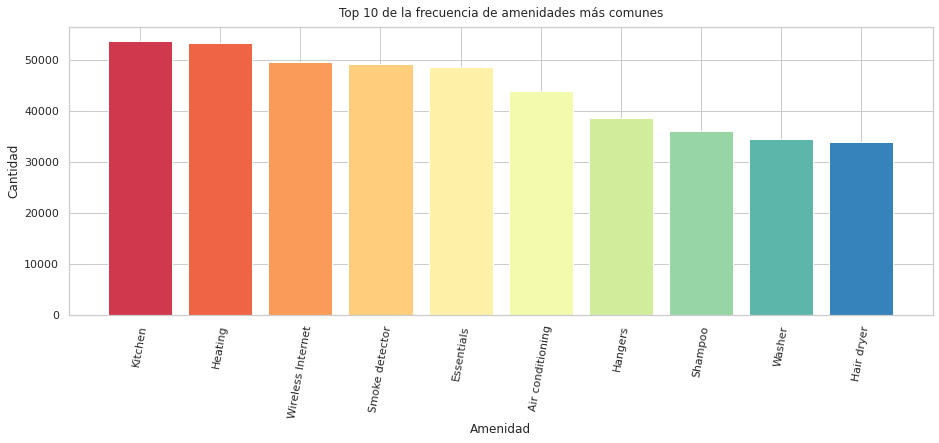

In [ ]:
plot_bar(data=df, top=10)

La gráfica nos muestra que prácticamente todas las propiedades cuentan con cocina y calefacción, seguido por internet y detector de humo. Esto hace sentido porque las ciudades de Estados Unidos (sobre todo las del norte como Washington y NY) son muy frías.

Ya que hemos validado las amenidades más frecuentes de nuestro texto, vale la pena visualizar no sólo ésas si no todas. Como es una lista grande, una gráfica de barras resulta poco atractiva para visualizarlas, de modo que recurrimos a una mejor y más bonita manera: una nube de palabras. Se mostrará una simple y una donde se aplique una máscara.

In [ ]:
#Primero obtenemos la frecuencia de las palabras
datos = {}
for k in range(len(df)):
    nombre = df.index[k]
    valor = df['freq'][k]
    datos[nombre] = int(valor)

In [ ]:
datos

{'Kitchen': 53730,
 'Heating': 53260,
 'Wireless Internet': 49616,
 'Smoke detector': 49141,
 'Essentials': 48633,
 'Air conditioning': 43880,
 'Hangers': 38504,
 'Shampoo': 36081,
 'Washer': 34414,
 'Hair dryer': 33776,
 'Dryer': 33461,
 'Iron': 30660,
 'Internet': 28307,
 'Fire extinguisher': 24206,
 'First aid kit': 21994,
 'Cable TV': 18332,
 '24-hour check-in': 14895,
 'Safety card': 9190,
 'Self Check-In': 8845,
 'Elevator': 8629,
 'Pets allowed': 8163,
 'Indoor fireplace': 7434,
 'Breakfast': 6630,
 'Gym': 5981,
 'Hot tub': 5055,
 'Pool': 5024,
 'Dog(s)': 4278,
 'Refrigerator': 3649,
 'Doorman': 3383,
 'Hot water': 3249,
 'Cooking basics': 3128,
 'Microwave': 3111,
 'Oven': 3095,
 'Bed linens': 3087,
 'Smoking allowed': 2902,
 'Cat(s)': 2902,
 'Coffee maker': 2828,
 'ShampooTV': 2489,
 'Stove': 2427,
 'Private entrance': 2262,
 'Lockbox': 2181,
 'Bathtub': 2145,
 'IronTV': 1919,
 'EssentialsTV': 1845,
 'Dishwasher': 1829,
 'LockboxTV': 1767,
 'Step-free access': 1380,
 'Keypad':

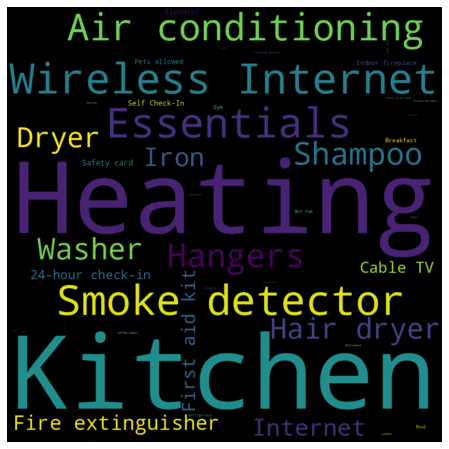

In [ ]:
#Después generamos una wordcloud. El valor de la escala relativo es ajustar la importancia de una frecuencia de palabra.
wordcloud = WordCloud(width=900,height=900, max_words=300,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(datos)

plt.figure(figsize=(10,8))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Nótese cómo no se visualizan en la nube todas las amenidades por la grandísima diferencia entre las amenidades top y las menos repetidas. Algunas amenidades fuera del top 10 pero que están presentes en muchas propiedades son Iron y Dryer.

Ahora aplicaremos una máscara a la nube para hacer más presentable la visualización. Usaremos el logo de Airbnb para que tenga sentido de negocio:

In [ ]:
#Utilizamos una función para transformar todas las imágenes PNG con fondo transparente a fondo blanco
#de no ser así, WordCloud rellenará aquellos espacios que NO estén de color blanco. Hay que tener cuidado con imágenes PNG con el fondo transparente, primero debemos incluir un fondo blanco.

def transform_white_backgroud(png_path):
    picture = Image.open(png_path).convert("RGBA")
    image = Image.new("RGB", picture.size, "RED")
    image.paste(picture, (0, 0), picture)

    plt.imshow(image)
    
    mask = np.array(image)
    
    return mask

In [ ]:
#En caso de que NO se tenga que realizar este paso intermedio, directamente se crea la máscara con la imagen PNG con fondo blanco:

#image = Image.open('https://raw.githubusercontent.com/BeduDSEquipo9/C2DSF3_DAwPython/main/images/airbnbBW.png')
#print(file_path_image)
urllib.request.urlretrieve(file_path_image,"airbnbBW.png")
 
image = Image.open("airbnbBW.png")

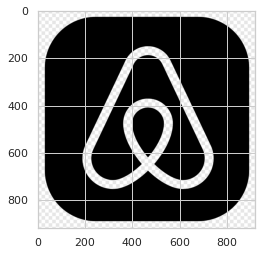

In [ ]:
plt.imshow(image)

mask = np.array(image)

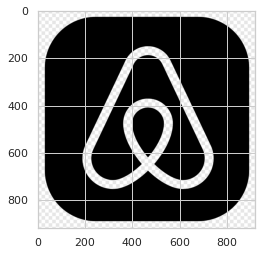

In [ ]:
mask = transform_white_backgroud("airbnbBW.png")

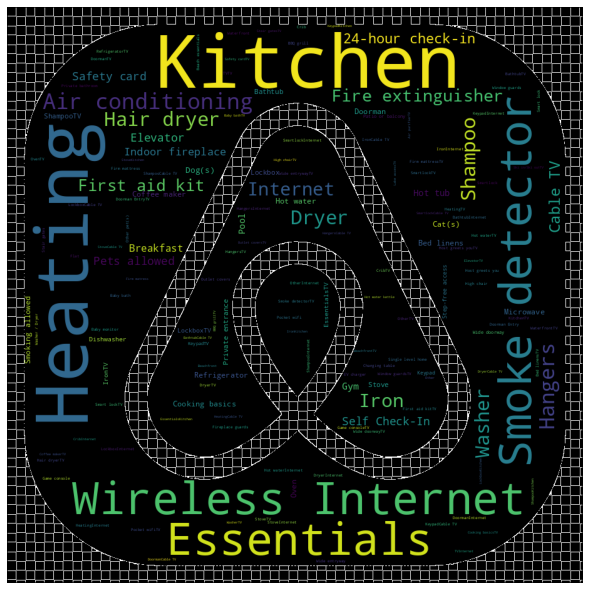

In [ ]:
#Por último agregamos los datos de frecuencia
word_cloud = WordCloud(mask=mask, background_color='black', contour_width=1, contour_color='white', max_words=200, min_font_size=5, collocation_threshold=10).generate_from_frequencies(datos)

plt.figure(figsize=(10,8))
plt.imshow(word_cloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

La visualización es una parte esencial del análisis de datos, y por ello se decidió analizar la descripción de las propiedades, generando algunos análisis estadísticos de palabras, bigramas, trigramas, etc.

A continuación se muestran algunos hallazgos interesantes.

In [ ]:
#Como ya se mencionó en algunos puntos anteriores, se va a extraer una muestra de la información total
#ya que este proceso de análisis de lenguaje natural toma aproximadamente 2 horas con toda la información.
#Sacamos 10% del dataset original
#5929 out of 59288
df = pd.read_csv(file_path) 
datamap=df.sample(frac=0.1)

In [ ]:
#Se obtienen la muestra de las descripciones
descripcion = datamap['description']
descripcion

17528    Your own room with private bath in the Sunset ...
35259    Newly renovated home with clean & spacious pri...
41936    Private bedroom in a comfortable 3BR apartment...
35813    I have a tiny cozy little studio that can slee...
904      This beautiful designer owned Venice cottage w...
                               ...                        
45679    This penthouse loft takes the entire top floor...
54081    Our three bedroom house is close to York Blvd ...
29636    Our place is close to Wicker Park Six Corners ...
57088    Artistic space, tranquil location near beach p...
32519    Enjoy your stay in my spare bedroom.  This is ...
Name: description, Length: 5929, dtype: object

In [ ]:
#Actualizamos librerías
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
#Se realiza una conversión de datos para preparar la información; esto se hace con expresiones regulares.
descripcion_lista = descripcion.tolist()
descripcion_string = ''.join(descripcion_lista)
descripcion = descripcion.str.lower()
descripcion = descripcion.str.strip()
descripcion = descripcion.str.replace('[^\w\s]', '')
descripcion = descripcion.str.replace('\d', '')
descripcion = descripcion.str.replace('\\n', '')
descripcion = descripcion.dropna()
descripcion

<ipython-input-183-a017bf5dafd4>:6: FutureWarning:

The default value of regex will change from True to False in a future version.

<ipython-input-183-a017bf5dafd4>:7: FutureWarning:

The default value of regex will change from True to False in a future version.

<ipython-input-183-a017bf5dafd4>:8: FutureWarning:

The default value of regex will change from True to False in a future version.



17528    your own room with private bath in the sunset ...
35259    newly renovated home with clean  spacious priv...
41936    private bedroom in a comfortable br apartment ...
35813    i have a tiny cozy little studio that can slee...
904      this beautiful designer owned venice cottage w...
                               ...                        
45679    this penthouse loft takes the entire top floor...
54081    our three bedroom house is close to york blvd ...
29636    our place is close to wicker park six corners ...
57088    artistic space tranquil location near beach pa...
32519    enjoy your stay in my spare bedroom  this is a...
Name: description, Length: 5929, dtype: object

In [ ]:
#Se procede a realizar el tokenizado de la información
tokenized = descripcion.apply(nltk.word_tokenize)
all_words = tokenized.sum()

english_stop_words = stopwords.words('english')
all_words_except_stop_words = [word for word in all_words if word not in english_stop_words]

freq_dist = nltk.FreqDist(all_words_except_stop_words)

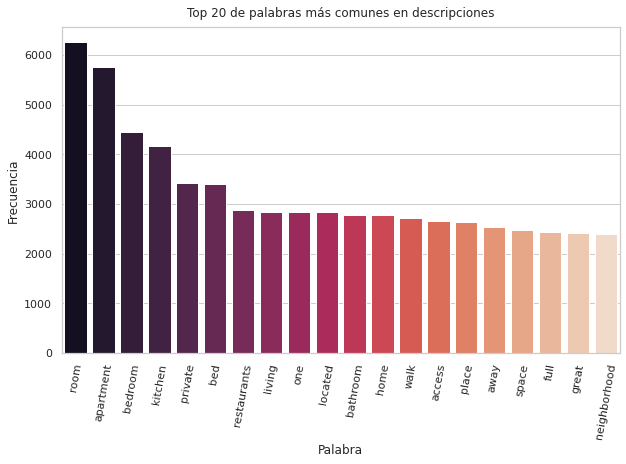

In [ ]:
# Podemos visualizar la frecuencia de las palabras más comunes
# Un top 20 por ejemplo

most_common_20 = np.array(list(map(lambda x: list(x), freq_dist.most_common(20))))
df_most_common_20 = pd.DataFrame(most_common_20, columns = ['name','freq'])
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot()

sns.barplot(x=df_most_common_20['name'], y=pd.to_numeric(df_most_common_20['freq']), ax=ax, palette='rocket');
ax.set_title('Top 20 de palabras más comunes en descripciones', pad=10)
ax.set_ylabel('Frecuencia')
ax.set_xlabel('Palabra')
ax.tick_params(axis='x', rotation=80)

In [ ]:
# Se puede visualizar la frecuencia de los bigramas más comunes

text = nltk.Text(all_words)
freq_dist_bigrams = nltk.FreqDist(list(nltk.bigrams(text)))

freq_dist_bigrams

FreqDist({('in', 'the'): 5272, ('of', 'the'): 3321, ('to', 'the'): 2966, ('is', 'a'): 2845, ('living', 'room'): 2044, ('from', 'the'): 2031, ('with', 'a'): 2015, ('access', 'to'): 1999, ('close', 'to'): 1912, ('and', 'a'): 1895, ...})

<ipython-input-187-1852a08d57e1>:1: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



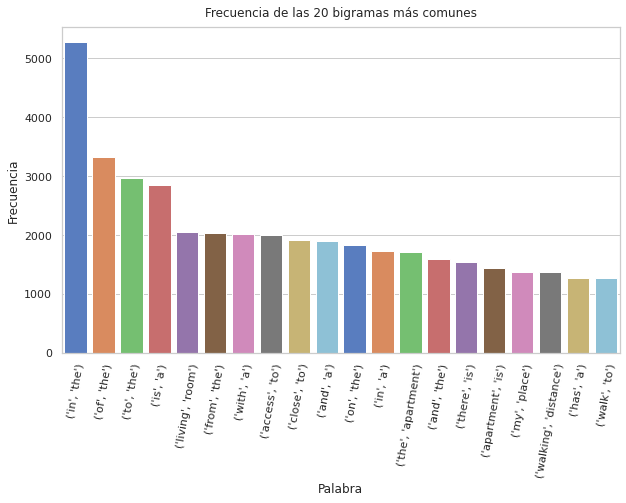

In [ ]:
most_common_20 = np.array(list(map(lambda x: list(x), freq_dist_bigrams.most_common(20))))

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot()

sns.barplot(x=most_common_20[:,0], y=pd.to_numeric(most_common_20[:,1]), ax=ax, palette='muted');
ax.set_title('Frecuencia de las 20 bigramas más comunes', pad=10)
ax.set_ylabel('Frecuencia')
ax.set_xlabel('Palabra')
ax.tick_params(axis='x', rotation=80)

In [ ]:
# Se puede hacer lo mismo pero eliminando las stop_words, lo que tiene mucho más sentido.

text = nltk.Text(all_words_except_stop_words)
freq_dist_bigrams = nltk.FreqDist(list(nltk.bigrams(text)))

freq_dist_bigrams

FreqDist({('living', 'room'): 2046, ('walking', 'distance'): 1379, ('size', 'bed'): 769, ('minute', 'walk'): 712, ('queen', 'size'): 612, ('bedroom', 'apartment'): 582, ('solo', 'adventurers'): 563, ('blocks', 'away'): 554, ('business', 'travelers'): 553, ('restaurants', 'bars'): 532, ...})

<ipython-input-189-c7dc3ea08ff2>:1: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



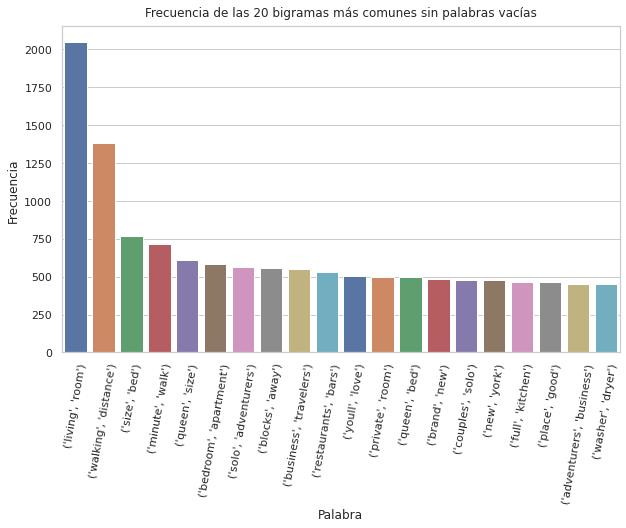

In [ ]:
most_common_20 = np.array(list(map(lambda x: list(x), freq_dist_bigrams.most_common(20))))

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot()

sns.barplot(x=most_common_20[:, 0], y=pd.to_numeric(most_common_20[:, 1]), ax=ax, palette='deep');
ax.set_title('Frecuencia de las 20 bigramas más comunes sin palabras vacías', pad=10)
ax.set_ylabel('Frecuencia')
ax.set_xlabel('Palabra')
ax.tick_params(axis='x', rotation=80)

<ipython-input-190-a76280d35e23>:5: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



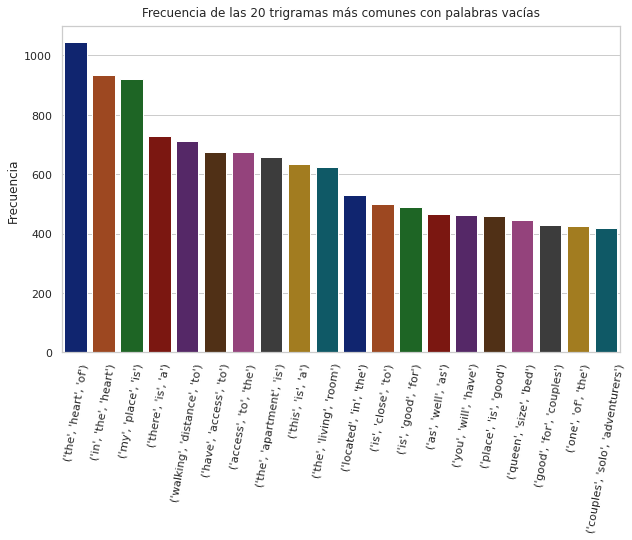

In [ ]:
# Inclusive se puede hacer uso de NGRAMS con o sin stop_words
text = nltk.Text(all_words)
freq_dist_trigrams = nltk.FreqDist(list(ngrams(text, 3)))

most_common_20 = np.array(list(map(lambda x: list(x), freq_dist_trigrams.most_common(20))))

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot()

sns.barplot(x=most_common_20[:, 0], y=pd.to_numeric(most_common_20[:, 1]), ax=ax, palette='dark');
ax.set_title('Frecuencia de las 20 trigramas más comunes con palabras vacías', pad=10)
ax.set_ylabel('Palabras')
ax.set_ylabel('Frecuencia')
ax.tick_params(axis='x', rotation=80)

<ipython-input-191-eab9b1c7587b>:4: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



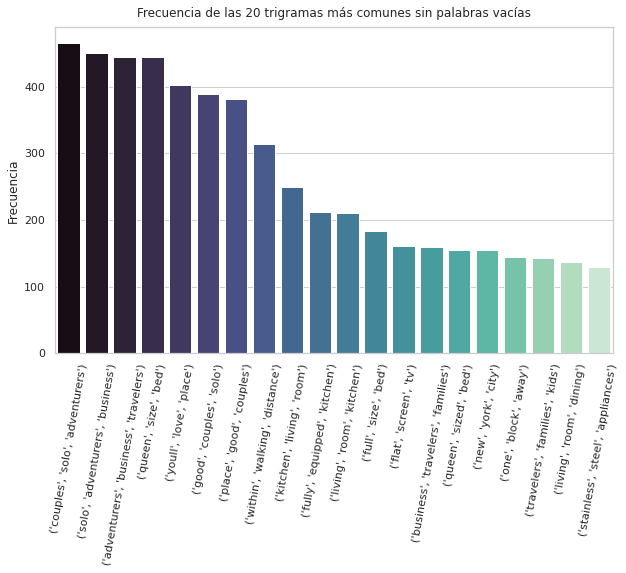

In [ ]:
text = nltk.Text(all_words_except_stop_words)
freq_dist_trigrams = nltk.FreqDist(list(ngrams(text, 3)))

most_common_20 = np.array(list(map(lambda x: list(x), freq_dist_trigrams.most_common(20))))

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot()

sns.barplot(x=most_common_20[:, 0], y=pd.to_numeric(most_common_20[:, 1]), ax=ax, palette='mako');
ax.set_title('Frecuencia de las 20 trigramas más comunes sin palabras vacías', pad=10)
ax.set_ylabel('Palabras')
ax.set_ylabel('Frecuencia')
ax.tick_params(axis='x', rotation=80)

In [ ]:
# En este mismo análisis de palabras, se pueden generar histogramas para visualizar la frecuencia de longitudes de palabras y oraciones.

word_lengths = [len(w) for w in all_words_except_stop_words]

<ipython-input-193-5a57cf3c871e>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




Text(0, 0.5, '# de palabras')

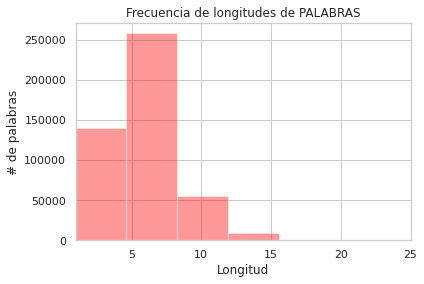

In [ ]:
fig, ax = plt.subplots()
sns.distplot(word_lengths, kde=False, norm_hist=False,color='red').set(title='Frecuencia de longitudes de PALABRAS')
ax.set_xlim(1, 25);
ax.set_xlabel('Longitud')
ax.set_ylabel('# de palabras')

Se aprecia cómo la mayoría de las palabras no rebasa 10 caracteres, la más grande sería 16. Sería interesante ver cuál es esa palabra y si efectivamente existe o fue alguna secuencia de caracteres o error de ortografía.

<ipython-input-194-3fb2439d17d2>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




Text(20.200000000000003, 0.5, 'Longitud de la descripción')

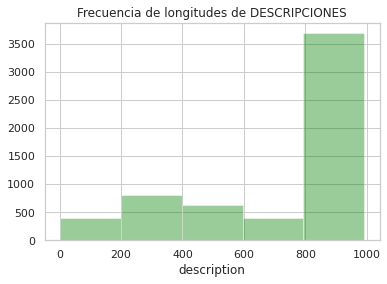

In [ ]:
#Longitud de reseñas
sentence_lengths = descripcion.apply(lambda x: len(x))
sns.distplot(sentence_lengths, kde=False, norm_hist=False,bins=5,color='green').set(title='Frecuencia de longitudes de DESCRIPCIONES')
ax.set_xlim(1, 1000);
ax.set_xlabel('Longitud')
ax.set_ylabel('Longitud de la descripción')

Vemos cómo predominan las descripciones largas, con muchos caracteres. Esto es bueno porque significa que los dueños le echan ganas a cómo venden su propiedad.

<ipython-input-195-d2ca48f5bff1>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




Text(20.200000000000003, 0.5, 'Palabras por descripción')

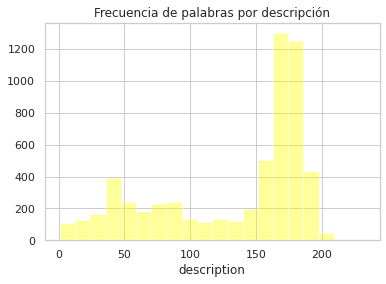

In [ ]:
#Palabras por descripción
num_of_words = descripcion.str.split(' ').str.len()
sns.distplot(num_of_words, kde=False, norm_hist=False,bins=20,color='yellow').set(title='Frecuencia de palabras por descripción')
ax.set_xlim(1, 1000);
ax.set_xlabel('Cantidad')
ax.set_ylabel('Palabras por descripción')

Se confirma un sesgo a la izquierda con alta curtosis de las palabras por descripción. Eso significa que la mayoría de dueños se explayan en explicar las ventajas y características de su propiedad en renta. Eso ayuda a que la pueda dar a un precio más caro.

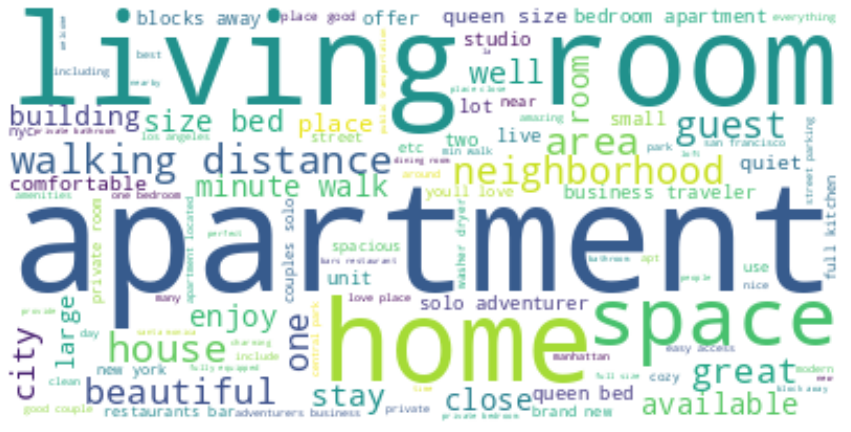

In [ ]:
# y de la misma manera, se puede trabajar con la nube de pabras
wordcloud = WordCloud(max_font_size=100, background_color="white").generate(' '.join(all_words_except_stop_words))

plt.figure(figsize=(15, 15))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Análisis con PLN para la columna `name` y `description`

En esta sección se instala el módulo contractions para realizar el reemplazo de contracciones del idioma inglés por la palabra completa. Por ejemplo: *I'm* por *I am*.

In [ ]:
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

Creamos una columna nueva que une el texto de la columna `name` con la columna `description`

In [ ]:
data_clean = df
data_clean['text'] = data_clean['name'].map(str) + ' ' + data_clean['description']
data_clean['text']

0        AFFORDABLE & COZY IN SUNSET PARK T This is a c...
1        Luxurious and quiet - 30 second walk to the be...
2        Bensonhurst STYLISH STUDIO My studio is locate...
3        LA San Gabriel  Suit room 圣盖博大套房 免费停车 Free Par...
4        XTRA Large 2bdrm 2bath in the City near "El" T...
                               ...                        
59283    Lake Balboa House / Zen Retreat! Our newly ren...
59284    Modern Beautiful Duplex in Brownstone Beautifu...
59285    Artsy and Spacious Back House Explore Los Ange...
59286    Cozy Apartment off J&M Subway Lines Quiet 1 be...
59287    KOSHER-FRIENDLY 4 BEDROOM SLEEPS 10 and up to ...
Name: text, Length: 59288, dtype: object

A continuación se realiza una normalización del texto:

* Eliminar todos los símbolos distintos de letras y espacios. 
* Representar todo en minúsculas
* Sustituir contracciones
* Tokenizar
* Eliminar `stopwords`

Dado que el conjunto de datos es muy grande, y por limitaciones de memoria en Colab, se realiza el análisis solo en una submuestra de 1500 registros.

In [ ]:
stop_words = stopwords.words('english')

def normalized_text(text):
  text = re.sub(r'[^a-zA-Z\s]', ' ', text, re.I|re.A)
  text = text.lower()
  text = text.strip()
  text = contractions.fix(text)
  tokens = nltk.word_tokenize(text)
  filtered_tokens = [token for token in tokens if token not in stop_words]
  text = ' '.join(filtered_tokens)
  return text


normalized_corpus = np.vectorize(normalized_text)

sample_data_clean_df = data_clean.sample(n=1500, random_state=1)
sample_data_clean_df.head()

,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,description,...,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds,price,n_days_lastrev,n_days_ashost,text
9128,Apartment,2,"{TV,""Cable TV"",""Wireless Internet"",Kitchen,Gym...",2,1.0,1,2,1,SF,Beautiful room in luxury highrise with a direc...,...,South Beach,11,100,94105,1.0,1.0,150.0,2012,2604,Private Room with Stunning Bay Bridge Views Be...
387,Boutique hotel,2,"{""Cable TV"",""Air conditioning"",Heating,Essenti...",2,1.0,1,1,0,NYC,Opulent St Regis CLub in the heart of Manhatta...,...,Midtown East,0,0,10022,1.0,1.0,1080.0,19436,2045,Luxury 5 Star 1 Bedroom St Regis Residence NY...
11742,Camper/RV,3,{},2,0.0,0,2,1,LA,"Very unique van; a super cozy, comfy affordabl...",...,Malibu,0,0,90265,1.0,1.0,49.0,19436,3424,Cozy Retro Surf Van In Malibu Very unique van;...
56229,Condominium,3,"{TV,""Wireless Internet"",""Air conditioning"",Kit...",5,1.0,1,3,1,Boston,Private modern condo in a JP 2 family. Enjoy o...,...,Jamaica Plain,5,95,02130,2.0,2.0,250.0,2007,2510,"Arthouse2 Brewery District, stay in an art gal..."
10629,Apartment,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",2,1.0,1,3,1,NYC,Doorman elevator building ! 14th floor ! Priva...,...,East Village,62,97,10003.0,1.0,1.0,165.0,2269,4248,UNION SQUARE/ E. VILL 1BR BEAUTIFUL Doorman el...


In [ ]:
sample_data_clean = sample_data_clean_df['text']
sample_data_clean.head()

9128     Private Room with Stunning Bay Bridge Views Be...
387      Luxury 5 Star 1 Bedroom St Regis Residence  NY...
11742    Cozy Retro Surf Van In Malibu Very unique van;...
56229    Arthouse2 Brewery District, stay in an art gal...
10629    UNION SQUARE/ E. VILL 1BR BEAUTIFUL Doorman el...
Name: text, dtype: object

Se aplica la función para normalizar el texto.

In [ ]:
norm_corpus = normalized_corpus(list(sample_data_clean))
len(norm_corpus)

1500

In [ ]:
norm_corpus

array(['private room stunning bay bridge views beautiful room luxury highrise direct view bay bridge private room features super plush king size bed inch flatscreen tv tufted armchair reading side window bed bed chest placing luggage building features luxury amenities hour fitness center hot tub barbecue area social lounge business center coffee station full access kitchen large balcony living area laundry room roommates fiancee happy hang give complete privacy great location south beach steps embarcadero walk park fisherman wharf downtown fidi union square moma moscone center world renowned saturday morning ferry building farmers market minutes walk embarcadero bart muni stations minute transbay transit terminal woodlands market around corner open pm upscale deli shopping happy',
       'luxury star bedroom st regis residence nyc opulent st regis club heart manhattan blocks central park amenities true luxury luxurious marble bathroom spacious bathtub separate shower plasma hideaway te

Se realiza una representación del texto en [TFIDF](https://es.wikipedia.org/wiki/Tf-idf). La Frecuencia de término – frecuencia inversa de documento (o sea, la frecuencia de ocurrencia del término en la colección de documentos), es una medida numérica que expresa que tan relevante es una palabra para un documento en una colección.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tf= TfidfVectorizer(ngram_range=(1,2), min_df=2)
tfidf_matrix = tf.fit_transform(norm_corpus)

tfidf_matrix.shape

(1500, 17397)

A continuación se calcula la [similitud coseno](https://es.wikipedia.org/wiki/Similitud_coseno) entre la matrix tdidf para conocer la similitud que tienen las descripciónes en cuanto a contenido. La similitud coseno es un valor quese encuentra entre -1 y 1. Para indicar el parecido de la representación vectorial creada por TFIDF.

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

doc_sim = cosine_similarity(tfidf_matrix)
doc_sim_df = pd.DataFrame(doc_sim)
doc_sim_df.head()


,0,1,2,3,4,5,6,7,8,9,...,1490,1491,1492,1493,1494,1495,1496,1497,1498,1499
0,1.000000,0.035272,0.026447,0.017719,0.057106,0.050768,0.010672,0.066953,0.029280,0.029231,...,0.027502,0.033697,0.004682,0.018903,0.041139,0.025888,0.033161,0.046734,0.008492,0.015180
1,0.035272,1.000000,0.002938,0.021584,0.004797,0.026971,0.024942,0.013456,0.042472,0.018625,...,0.020761,0.009765,0.000000,0.011983,0.024921,0.008828,0.026737,0.029035,0.000000,0.013134
2,0.026447,0.002938,1.000000,0.012202,0.018178,0.054262,0.026116,0.024626,0.048730,0.015697,...,0.027002,0.026479,0.010377,0.010657,0.016834,0.021961,0.046216,0.020351,0.012391,0.025805
3,0.017719,0.021584,0.012202,1.000000,0.015587,0.035357,0.036303,0.064644,0.031215,0.042718,...,0.044708,0.011135,0.003819,0.032293,0.026718,0.015994,0.026121,0.025609,0.018200,0.022524
4,0.057106,0.004797,0.018178,0.015587,1.000000,0.020452,0.019147,0.023931,0.051424,0.017351,...,0.040773,0.068846,0.009648,0.014137,0.040081,0.012242,0.025910,0.021418,0.129556,0.029118


A continuación utilizaremos el resultado anterior para encontrar propiedades parecidas de acuerdo al nombre + la descripción de la propiedad.

Para fines prácticos se utiliza la primera propiedad del conjunto de datos:

* `name`: "AFFORDABLE & COZY IN SUNSET PARK T"

In [ ]:
properties_list = normalized_corpus(list(data_clean['name']))
properties_list, properties_list.shape

(array(['affordable cozy sunset park', 'luxurious quiet second walk beach',
        'bensonhurst stylish studio', ..., 'artsy spacious back house',
        'cozy apartment j subway lines', 'kosher friendly bedroom sleeps'],
       dtype='<U144'), (59288,))

In [ ]:
property_idx = np.where(properties_list == 'affordable cozy sunset park')[0][0]
property_idx

0

El resultado de la propiedad con `name`: "AFFORDABLE & COZY IN SUNSET PARK T" contra toda la colección de propiedades se almacena en una variable.



In [ ]:
property_similarities = doc_sim_df.iloc[property_idx].values
property_similarities

array([1.        , 0.03527205, 0.02644683, ..., 0.04673449, 0.00849244,
       0.01518021])

Se busca solo listar las 5 propiedades que presentaron similitud en la descripción con respecto a `name`: "AFFORDABLE & COZY IN SUNSET PARK T"

In [ ]:
similar_property_idxs = np.argsort(-property_similarities)[1:6]
similar_property_idxs

array([ 250,  923,  468, 1288, 1116])

De acuerdo a los índices anteriores las propiedades que tienen una similitud son:

In [ ]:
similar_properties = properties_list[similar_property_idxs]
similar_properties

array(['beautiful hollywood hills bungalow', 'east gate apartment',
       'huge williamsburg artist apartment',
       'super cozy williamsburg gem', 'new artistic apt garden view'],
      dtype='<U144')

Esta es la descripción de la propiedad `name`: "AFFORDABLE & COZY IN SUNSET PARK T"



In [ ]:
normalized_corpus(data_clean['description'].iloc[0])

array('comfortable simple beautiful room one block away sunset park clean cozy furnished comfort guests comfortable simple beautiful room one block away sunset park clean cozy furnished comfortable possible guests centrally located th th avenue shops restaurants cafes markets sightseeing nearby include prospect park brooklyn museum brooklyn botanical gardens brooklyn academy music easily commutable via train cab blocks away n r train manhattan within minutes midtown minutes provide full side bed sheets towel provide hdtv wifi warm welcome full access kitchen microwave fridge two burner portable stove coffee maker toaster cooking ware weather behaving good feel free use wonderful backyard check pm check',
      dtype='<U704')

Si se compara la descripción de esta propiedad contra las 5 propiedades que mostraron similitud (listadas a continuación), se tiene que:

In [ ]:
normalized_corpus(data_clean['description'].iloc[similar_property_idxs[0]])

array('california bungalow craftsman front porch swing living room flat screen dining room large bright kitchen deck enormous flat yard garden two bedrooms bathrooms available commercial inquiries central everything hollywood serene quiet home light bright open plenty street parking parking restrictions living room bathroom kitchen outdoor space whatever guests need yes looking rent shoots',
      dtype='<U385')

In [ ]:
normalized_corpus(data_clean['description'].iloc[similar_property_idxs[1]])

array('unfurnished apartment available rent monthly blocks one shared bathroom kitchen includes utilities central air see amenities guest access shared spaces respective rooms host available respond within hours short term rental option booking space waive tenant rights local federal municipalities host retains right terminate visit anytime',
      dtype='<U335')

In [ ]:
normalized_corpus(data_clean['description'].iloc[similar_property_idxs[2]])

array('private bedroom huge sunny bd apartment full kitchen bath located trendy williamsburg greenpoint min manhattan close transportation restaurants bars grocery store coffee shop park apartment located charming family house quiet street popular graham avenue sqft apartment spans entire floor massive kitchen chef dream huge sunny livingroom full bathroom sinks ft tub waterfall shower head bedroom rent full sized memory foam bed huge wardrobe shelves desk room comfortably fits guests bedrooms opposite ends apartment giving added privacy huge living room middle apartment features private connected outdoor space bedroom feel free ask like bbq enjoy time outside highlights wifi high speed netflix huluplus hbo go washer dryer l',
      dtype='<U727')

In [ ]:
normalized_corpus(data_clean['description'].iloc[similar_property_idxs[3]])

array('chic cute gem apartment bedford ave williamsburg brooklyn best location queen sized bed big windows comfy couch cool fire escape hang quiet side building exposed brick walls w fireplace super chic cute comfortable centrally located gem apartment comfortable queen sized bed big windows comfy couch cool fire escape hang quiet side building exposed brick walls closed fireplace hi speed wifi internet roofdeck w stunning views brooklyn kitchenette bathroom shower including full tub provide coffee coolest places williamsburg brooklyn steps away best williamsburg brooklyn downtown manhattan bushwick beyond whatever need ask special questions meet meet greet always happy share tips advice etc bonus event',
      dtype='<U705')

In [ ]:
normalized_corpus(data_clean['description'].iloc[similar_property_idxs[4]])

array('come stay new boho chic spacious apartment blocks east prospect park bedroom overlooks beautiful garden queen bed dresser closet space katie artist host gone work throughout day space bedrooms overlook backyard garden morning sun streams architecture buildings feels like waking europe apartment first floor removed street easy get great night rest also small backyard space relax want apartment new wood floors high ceilings granite counter tops cherrywood finish cabinets attractive decor brand new appliances keep clean organic cleaning agents neither us smoke availability calendar room open another host living house katie painter makeup artist work throughout daytime bo',
      dtype='<U676')

Aunque en este caso la aplicación de la similitud no parece tomar mucho sentido para encontrar que propiedades mostraron similitud en la columna `description`, en otro tipo de bases de datos puede ser el principio de un predictor para realizar la recomendación de otros elementos parecidos, por ejemplo, un recomendador de películas.

Finalmente, en este apartado se evalúa también la realización de una prueba A/B; sin embargo, para nuestro problema de investigación no se considera necesario hacer una. Ni siquiera se presta nuestro conjunto de datos para ello, pues el proyecto no abarca experimentos, temas de marketing ni de experiencia/conversión de usuarios.

Vale la pena recordar que hacer pruebas A/B es una de las formas más comunes para el análisis de datos en marketing digital y consiste, entre otras cosas, en evaluar dos variables independientes para probar dos opciones (A y B) con dos diferentes grupos.

Involucran una metodología establecida, pruebas estadísticas, programación y conocimiento de mercadotecnica digital.

#####([Regresar a la tabla de contenidos.](#contenido))

#<div class="markdown-google-sans"><a name="ml">Postwork 8: INTRODUCCIÓN A MACHINE LEARNING: CLASIFICACIÓN NO SUPERVISADA Y SUPERVISADA</a></div> 
Objetivo

    Identificar la definición de Machine Learning, qué es y cómo se utiliza
    Identificar cuándo es buena idea aplicar un algoritmo de K-Medias
    Interpretar los resultados de K-Medias
    Identificar cuándo es buena idea aplicar un algoritmo de Regresión Logística
    Evaluar un modelo de Regresión Logística utilizando matriz de confusión y curva ROC / AUC

Desarrollo

    1. Introducción

    2. ¿Qué es Machine Learning?

    3. Clasificación usando Machine Learning

    4. Agrupamiento por K-Medias (Clasificación No Supervisada)

    5. Regresión Logística (Clasificación Supervisada)

    6. Matriz de confusión

    7. Curva ROC / AUC

  
Postwork

Desarrollo
Requsitos

Tener un dataset limpio que contenga una variable dependiente binaria.

En caso de que tu dataset no contenga una variable dependiente binaria, date una vuelta por Kaggle y busca algún dataset apropiado. Lo que nos interesa es que practiques estas herramientas durante la clase para que puedas expresar tus dudas a la experta.
Desarrollo

¡Bienvenid@ a tu último Postwork! En este Postwork haremos dos cosas: practicar la aplicación del algoritmo de Regresión Logística y resolver dudas generales sobre tu proyecto. Realiza los siguientes pasos:

    Si hay un problema de clasificación binaria en tu proyecto, ¡genial! Aplica lo aprendido en esta sesión y entrena un modelo de Regresión Logística con tu dataset.
    Si no hay un problema de clasificación binaria en tu proyecto, pídele ayuda a la experta para conseguir un dataset con el que puedas practicar.
    Evalúa tu modelo de Regresión Logística utilizando matriz de confusión; medidas de precisión, exactitud, sensibilidad y especificidad; y curva ROC / AUC.

Ojo: si tu proyecto tiene un problema de clasificación multiclase (es decir, la variable dependiente no es binaria sino que contiene más de 2 categorías posibles), pídele ayuda a la experta para aplicar el algoritmo de Regresión Logística Multiclase.

Después de haber realizado esta práctica, aprovecha que es el último Postwork para plantear dudas generales acerca de tu proyecto. Recuerda que tu proyecto será presentado en público ante líderes de la industria y expert@s, así que es una buena idea que te sientas muy cómodo con lo que estás presentando.

Recuerda también que presentar un trabajo de ciencia de datos no trata solamente sobre lo técnico y las evaluaciones estadísticas que realicemos, sino que también requiere de mucho cuidado en la presentación. Aprovecha el tiempo restante para trabajar sobre la presentación de tu proyecto, de manera que se vea atractivo y que presente tus hallazgos con la mayor claridad posible.



De acuerdo a [Oracle](https://www.oracle.com/mx/artificial-intelligence/machine-learning/what-is-machine-learning/), el aprendizaje automático o Machine Learning (ML) es "el subapartado de la inteligencia artificial (IA) que se centra en desarrollar sistemas que aprenden, o mejoran el rendimiento, en función de los datos que consumen".

En otras palabras, es una rama que desarrolla sistemas y algoritmos que capturan las relaciones presentes en un conjunto de datos. Hay varios tipos de ML, pero los más conocidos son:

* Modelación supervisada: Se centra en utilizar información conocida para predecir resultados, ya sea un dato continuo mediante una regresión (u otro modelo lineal generalizado), o categórico, vía un algoritmo de clasificación (como k-medias o regresión logística). Aquí se tiene una variable objetivo.
* Modelación no supervisada: No se tiene variable objetivo. Son algoritmos de agrupación, en su mayoría, donde no se conocen a priori los grupos o clústeres, ni siquiera el número de ellos. El algoritmo aprende sin ninguna guía sobre los patrones en los datos y requiere validación externa para comprobar que los resultados tengan sentido.

En este estudio la variable objetivo es el precio que, al ser continuo, se estimó mediante modelos supervisados de regresión lineal, tanto simple como múltiple. Como los resultados de estimar el precio exacto de una propiedad no fueron los óptimos, tiene mérito intentarlo estimar mediante un algoritmo de clasificación como la regresión logística.

Para ello, la variable objetivo debe ser categórica, por lo que creamos una variable nueva donde el se indica si el precio es Alto si está por arriba de la mediana (denotado con 1) o Bajo, si es menor a la mediana (denotado por 0).

Se elige la mediana y no la media para mitigar el efecto de los valores atípicos, lo que permite que no exista tanto desbalance entre las dos categorías.

In [ ]:
precio_prom = df['price'].median()
precio_prom
#Para efectos prácticos se dejará en 110

110.00000000000004

In [ ]:
df['new_price'] = df['price'].map(lambda x: 1 if x >= 110 else 0)

In [ ]:
df['new_price'].value_counts()

1    30485
0    28803
Name: new_price, dtype: int64

Se nota como tanto los precios altos como los bajos se presentan en proporciones parecidas. Esto ayudará al modelo pues variables objetivos con desbalances muy marcados son difíciles de predecir (incluso si se le aplican técnicas propias para mitigarlo).

Ahora, procedemos a entrenar el modelo de regresión logística.

In [ ]:
#Regresión Logística - Usaremos las mismas variables predictoras que en el modelo de regresión lineal múltiple 
tgt = 'new_price'
predictors = ['accommodates', 'bathrooms']
#Seleccionamos únicamente las variables del DataFrame que vamos a utilizar y creamos uno nuevo, llamado X
X = df[predictors].copy()
y = df[tgt].copy()

In [ ]:
#Estandarización - Esto elimina el efecto de la escala
sc = StandardScaler()
sc.fit(X)

Xsc = sc.transform(X)

In [ ]:
Xt, Xv, yt, yv = train_test_split(X, y, test_size=.2, random_state = 580)

In [ ]:
#Estandarización
sc = StandardScaler()
sc.fit(Xt)

Xtsc = sc.transform(Xt)
Xvsc = sc.transform(Xv)

In [ ]:
models = {'logreg': LogisticRegression(C=.5)
}

In [ ]:
for c in models:
  models.get(c).fit(Xtsc, yt)

In [ ]:
print("MÉTRICAS")
print(f"precision yt: {precision_score(yt, models.get(c).predict(Xtsc))}")
print(f"precision yv: {precision_score(yv, models.get(c).predict(Xvsc))}")
print(f"recall yt: {recall_score(yt, models.get(c).predict(Xtsc))}")
print(f"recall yv: {recall_score(yv, models.get(c).predict(Xvsc))}\n")
print("REPORTE DE CLASIFICACIÓN - CONJUNTO DE ENTRENAMIENTO")
print(f"{classification_report(yt, models.get(c).predict(Xtsc))}\n")
print("REPORTE DE CLASIFICACIÓN - CONJUNTO DE VALIDACIÓN")
print(f"{classification_report(yv, models.get(c).predict(Xvsc))}")
print('\n')

MÉTRICAS
precision yt: 0.7640310959423587
precision yv: 0.7731141199226306
recall yt: 0.6619845572531625
recall yv: 0.6512954212155776

REPORTE DE CLASIFICACIÓN - CONJUNTO DE ENTRENAMIENTO
              precision    recall  f1-score   support

           0       0.69      0.78      0.73     23082
           1       0.76      0.66      0.71     24348

    accuracy                           0.72     47430
   macro avg       0.73      0.72      0.72     47430
weighted avg       0.73      0.72      0.72     47430


REPORTE DE CLASIFICACIÓN - CONJUNTO DE VALIDACIÓN
              precision    recall  f1-score   support

           0       0.68      0.79      0.73      5721
           1       0.77      0.65      0.71      6137

    accuracy                           0.72     11858
   macro avg       0.73      0.72      0.72     11858
weighted avg       0.73      0.72      0.72     11858





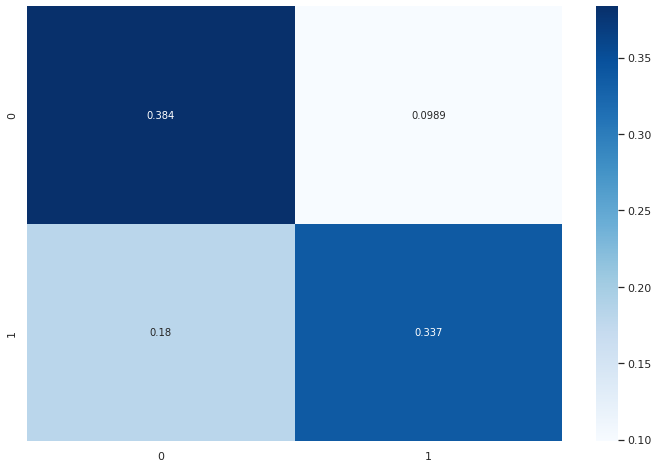

In [ ]:
plt.figure(figsize=(12,8))
sns.heatmap(confusion_matrix(yv, models.get(c).predict(Xvsc), normalize='all'), annot=True, cmap="Blues", fmt=".3g");

In [ ]:
confusion_matrix(yv, models.get(c).predict(Xvsc))

array([[4548, 1173],
       [2140, 3997]])

Como Regresión Logística es un algoritmo de clasificación, su desempeño no se evalúa calculando errores sino con una matriz de confusión o su correspondiente reporte de clasificación. En la matriz de confusión se muestra el número de casos de ambas categorías que fueron clasificados correctamente por el modelo y los que no, para después calcular ciertas métricas que conforman el reporte de clasificación.

En este caso, vemos que nuestro modelo de regresión logística tiene mucho mejor desempeño que la regresión lineal. En parte porque ya no estamos prediciendo un valor exacto, pero también porque las categorías estaban balanceadas. 

Por otro lado, se puede apreciar que el modelo es bueno y no está sobreajustado (es decir, que únicamente está aprendiendo las relaciones presentes en el conjunto de entrenamiento pero tiene un mal desempeño con datos nuevos), porque las métricas para el conjunto de entrenamiento y el de validación con muy cercanas.

A grandes rasgos, se tiene una mayor precisión para los precios altos y un mayor recall para los bajos. Globalmente, el modelo predice precios altos y bajos con un accuracy poco mayor a 70%, lo cual es un buen resultado. Esto se ve también en la matriz de confusión si se suman los porcentajes de la diagonal azul.

#####([Regresar a la tabla de contenidos.](#contenido))

##<div class="markdown-google-sans"><a name="webscraping"> Extras:  Web Scraping.</a></div>
###Obtención de datos adicionales con WebScraping

  
 Airbnb no brinda acceso a su API a terceros debido a la privacidad de la información de sus usuarios y la protección de sus datos. Para este proyecto se encontró que las APIs de AirBnb están cerradas a menos que seas dueño de una propiedad en la plataforma o un proveedor de servicios para mantenimiento y administración de inmuebles.

También surgió otra pregunta, ¿cómo se compara una renta de corto plazo contra una renta de largo plazo? Para responderla se quiere comparar el valor de la renta de corto plazo de Airbnb, obtenido en el modelo predictor contra el valor de la renta mensual, para lo cual se exploraron otras API de empresas de anuncios de renta de inmuebles. Entre ellas, había dos API sin costo, pero el proceso para la liberación de los accesos toma tiempo. Una de ellas es Zillow, el portal de inmuebles más reconocido en el mercado estadounidense. Para analisis futuros sería posible usar los datos de Inmuebles24.com, un homólogo de Zillow en nuestro país.

En lugar de explotar un API, se optó por realizar un barrido de datos Webscraping del portal `Zillow.com` con Python. Esta estrategia permite tener acceso a los datos necesarios para la comparación sin tener que depender de una API externa y, por lo tanto, puede ser una solución más asequible y controlable.

El código de Webscraping se encuentra en el repo en Github; no se agregó a este Notebook por los problemas que pueden ocurrir por IP-Blocking cuando AWS, proveedor de los servicios de Nube para Zillow, se da cuenta que alguien está haciendo un barrido de su página.

* [Web Scraping Colab](https://colab.research.google.com/drive/19HFEGmKSxEVSvJzStKxA1V0jfRXFas8T?usp=share_link)

* [Video de Web Scraping](https://drive.google.com/file/d/11XCvI9i2B3JyFyOlPx7kh7PSaAIJ4bzf/view?usp=share_link)

En él se detalla un ejercicio de limpieza, proceso de datos paralelo para reponder a preguntas como la siguiente:

**¿Cuáles son los vecindarios más costosos, en promedio, y en qué ciudad se encuentran?** 

Entre los vecindarios más costosos, en primer lugar encontramos [**Century City**](https://www.google.com.mx/maps/place/Century+City,+California+90067,+EE.+UU./@34.0565614,-118.4181749,16z/data=!4m6!3m5!1s0x80c2bbf2ed672da7:0x4bf91367c431a816!8m2!3d34.0571327!4d-118.4148498!16s%2Fm%2F01zh8td), en **Los Angeles** con un costo promedio de **\$18,800.00**.

Sigue [**Nueva York, 10022**](https://www.google.com.mx/maps/place/Nueva+York,+10022,+EE.+UU./@40.7594581,-73.9694822,16.87z/data=!4m6!3m5!1s0x89c258e415b9da19:0x3e3afecde594d34a!8m2!3d40.7593941!4d-73.9697795!16s%2Fm%2F020cmyr) en en la ciudad de **Nueva York** con un costo promedio de **\$12,146.00**. 

Para ver más de este proceso, pasa al Colab de Webscraping.

#####([Regresar a la tabla de contenidos.](#contenido))

##<div class="markdown-google-sans"><a name="conclusiones">Conclusiones y siguientes pasos</a></div> 

Una vez finalizado el análisis y la manipulación del conjunto de datos inicial, es posible concluir lo siguiente:
* La información filtrada y transformada para su mejor aprovechamiento únicamente explica menos 30% del comportamiento del precio de una propiedad listada en Airbnb. 
* Al descartar variables por no tener una correlación tan alta, se perdió información que abonaba a la explicación de la varianza. No obstante, esa ganancia no era significativa en comparación a la complejidad que ganaba el modelo con tantas variables más.
* Al ser tan bajo el porcentaje de la explicación de la variabilidad, se evidencia que seguramente existen variables que no aparecen en el conjunto de datos original y que podrían tener mayor influencia en el comportamiento del precio, por ejemplo: tamaño de la propiedad, superficie en metros cuadrados, cercanía a sitios de interés turístico, día de la semana de la reserva, si es un día festivo o no, si es temporada vacacional o no, etc.
* Otra variable que puede agregar información importante tiene que ver con la presencia de amenidades en la propiedad. Como la variable original lista las amenidades entre llaves, se propone la creación de funciones que permitan convertir a `dummy`cada amenidad existente. Lo anterior podría abonar a la explicación del precio.
* Para precios bajos, el modelo de regresión lineal tiene un desempeño pobre, pero mejor que para precios altos, pues la predicción es más parecida al precio real. Esto corresponde con lo observado en el análisis exploratorio, pues únicamente el 3% de las observaciones originales tenía dicho rango de precios y, con tan pocos datos, ningún modelo tiene los elementos suficientes para predecir correctamente precios concretos. 
* Aproximar el precio de las propiedades clasificándolos en "Alto" y "Bajo" tiene un mucho mejor desempeño y precisión, incluso con pocas variables predictoras. 
* El análisis de texto para las descripciones, reseñas y amenidades abonó para entender cómo la frecuencia y repetición de ciertas palabras arrojan una explicación al por qué una propiedad es más cara o más barata.

Por lo anterior, tiene mérito establecer como siguiente paso el desarrollo de modelos con mejor desempeño en la predicción de precios, ya sea utilizando diferentes algoritmos o predictores disponibles (como las amenidades), o bien, buscando fuentes de información con más variables de las observaciones existentes o nuevos registros de propiedades con precios altos para correr el modelo sugerido. 

También puede intentarse correr otros modelos con la misma información, pero esto será posible hasta módulos posteriores, donde se aprenda sobre modelos de aprendizaje supervisado más avanzados que una Regresión Lineal.

#####([Regresar a la tabla de contenidos.](#contenido))